In [2]:
import osmnx as ox, networkx as nx, matplotlib.cm as cm, pandas as pd, numpy as np
import geopandas as gpd
from shapely.geometry import Point, mapping
%matplotlib inline

import warnings
warnings.simplefilter(action="ignore")

pd.set_option('precision', 5)
pd.options.display.float_format = '{:20.2f}'.format
pd.set_option('display.float_format', lambda x: '%.3f' % x)
pd.options.mode.chained_assignment = None

import urbanFormPy as up
from cdlib import algorithms
from networkx.algorithms import community as nxcomm
import community

### Downloading

Choose between the following methods:
* *OSMplace*, provide an OSM place name (e.g. City).
* *OSMpolygon*, provide an OSM polygon (relation) name.
* *distance_from_address*, provide a precise address and define parameter "distance" (which is otherwise not necessary)

In [2]:
place = 'Boston, MA'
epsg = 26986
city_name = 'Boston'
crs = {'init': 'epsg:26986', 'no_defs': True}

download_method = 'OSMplace'
distance = None
nodes_graph, edges_graph = up.get_network_fromOSM(download_method, place, 'drive', epsg, distance = distance)

In [3]:
"""
- "same_uv_edges" regulates the handling of edges with same pair of u-v nodes but different geometries.
When true keeps a center line between the two segments, unless one of the two segments is significantly longer than 
the other (>30%). In this case, the longer segment is deleted.
"""
nodes_graph, edges_graph = up.clean_network(nodes_graph, edges_graph, dead_ends = True, remove_disconnected_islands = True,
                            self_loops = True, same_uv_edges = True)

In [4]:
# saving
saving_path = 'C:/Users/g_filo01/sciebo/Scripts/Image of the City/Outputs/'+city_name+'/for_paper/'
nodes_graph.to_file(saving_path+city_name+'_nodes.shp')
edges_graph.to_file(saving_path+city_name+'_edges.shp')

### Alternatively, load from local path

In [3]:
epsg = 26986
city_name = 'Boston'
crs = {'init': 'epsg:26986', 'no_defs': True}

loading_path = 'C:/Users/g_filo01/sciebo/Scripts/Image of the City/Outputs/'+city_name+'/for_paper/'
nodes_graph = gpd.read_file(loading_path+city_name+'_nodes.shp')
edges_graph = gpd.read_file(loading_path+city_name+'_edges.shp')

try:
    nodes_graph, edges_graph = nodes_graph.to_crs(epsg=epsg), edges_graph.to_crs(epsg=epsg)
except:
    nodes_graph.crs, edges_graph.crs = crs, crs

nodes_graph.index,edges_graph.index  = nodes_graph.nodeID, edges_graph.edgeID
nodes_graph.index.name, edges_graph.index.name  = None, None

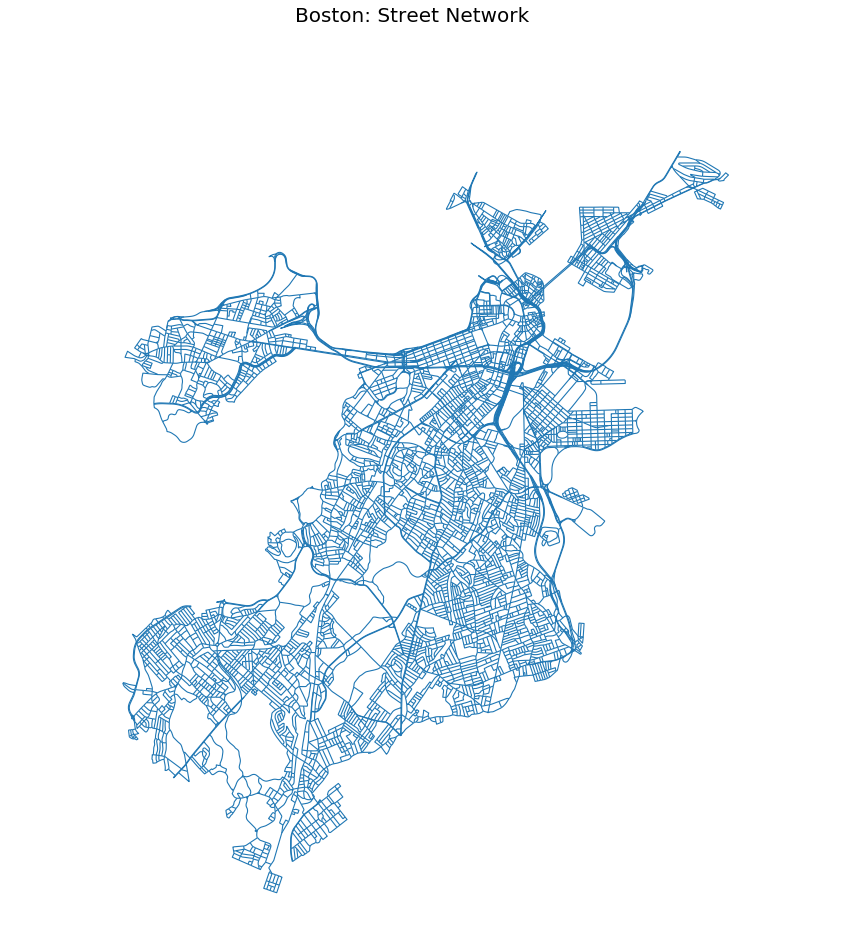

In [3]:
up.plot_lines(edges_graph, scheme = None,
              black_background = False, fig_size = 15, title = city_name+': Street Network')

# 1. Barriers identification

Choose between the following methods:
* *OSMplace*, provide an OSM place name (e.g. City).
* *distance_from_address*, provide a precise address and define parameter "distance" (which is otherwise not necessary)
* *Polygon*

In [6]:
download_method = 'polygon'
place = 'Boston, MA'
envelope = edges_graph.unary_union.envelope
coords = mapping(envelope)["coordinates"][0]
d = [(Point(coords[0])).distance(Point(coords[1])), (Point(coords[1])).distance(Point(coords[2]))]
distance = max(d)

In [7]:
from shapely.ops import transform
from functools import partial
import pyproj

project = partial(
    pyproj.transform,
    pyproj.Proj(crs), # source coordinate system
    pyproj.Proj(init='epsg:4326')) # destination coordinate system

envelope_wgs = transform(project, envelope)
place = envelope_wgs

In [8]:
road_barriers = up.road_barriers(place, download_method, distance, crs, include_primary = False)
water_barriers = up.water_barriers(place, download_method, distance, crs)
railway_barriers = up.railway_barriers(place,download_method, distance, crs)
park_barriers = up.park_barriers(place,download_method, distance, crs, min_area = 100000)

In [9]:
barriers = road_barriers.append(water_barriers)
barriers = railway_barriers.append(barriers)
barriers = park_barriers.append(barriers)
barriers.reset_index(inplace = True, drop = True)
barriers['barrierID'] = barriers.index.astype(int)
barriers = barriers[barriers.geometry.length >=500]

### Visualisation

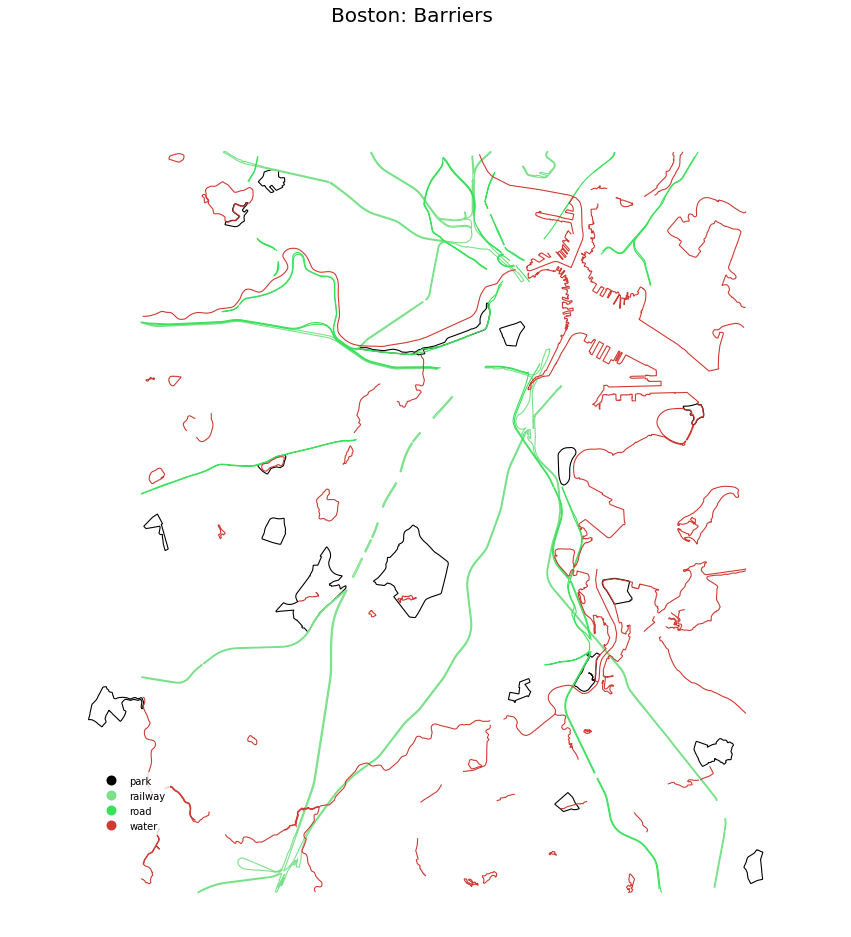

In [10]:
up.plot_lines(barriers, cmap = up.rand_cmap(len(barriers['type'].unique()), 'bright', True,False), column = 'type',
              black_background = False, fig_size = 15, title = city_name+': Barriers', legend = True)

In [9]:
saving_path = 'C:/Users/g_filo01/sciebo/Scripts/Image of the City/Outputs/'+city_name+'/for_paper/'
barriers.to_file(saving_path+city_name+"_barriers.shp", driver='ESRI Shapefile')

## Assigning barriers to street segments

In [12]:
# crossing any kind of barrier but parks
barriers_within = barriers[barriers.intersects(envelope)]
tmp = barriers_within[barriers_within['type'] != 'park'].copy()
edges_graph['c_barr'] = edges_graph.apply(lambda row: up.crossing_barriers(row['geometry'], tmp ), axis = 1)
edges_graph['sep_barr'] = edges_graph.apply(lambda row: True if len(row['c_barr']) > 0 else False, axis = 1)

### Visualisation

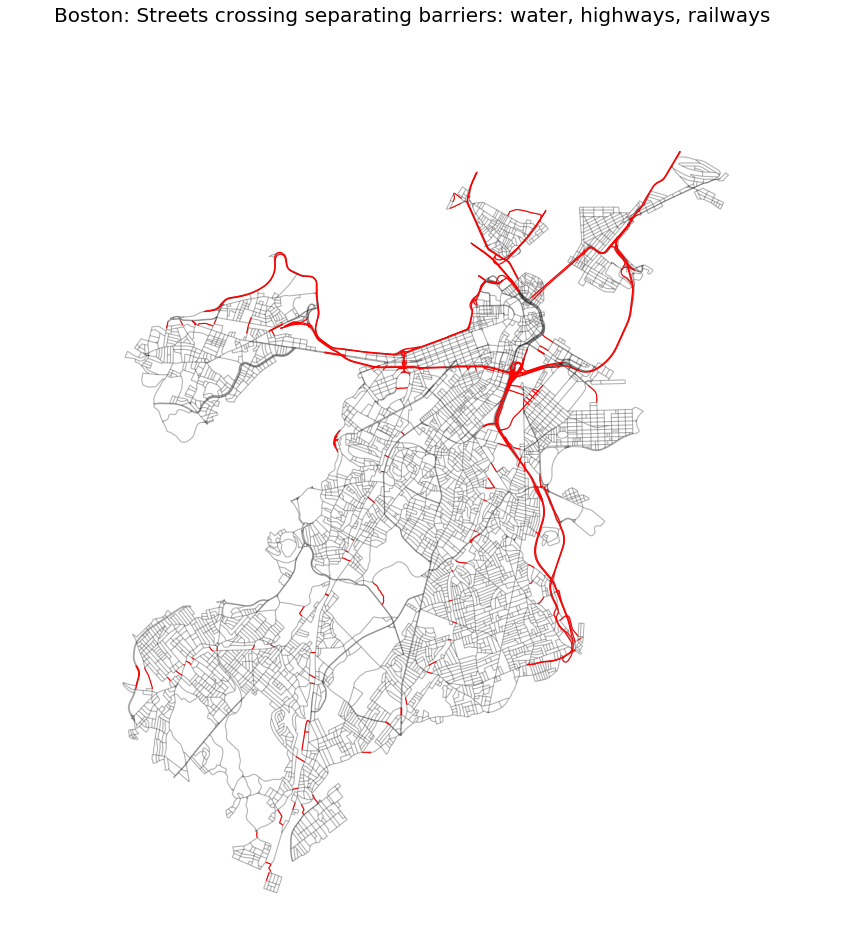

In [13]:
tmp = edges_graph[edges_graph.sep_barr == True].copy()
up.plot_lines(tmp, black_background = False, fig_size = 15,  color = 'red', 
              title = city_name+': Streets crossing separating barriers: water, highways, railways',
              gdf_base_map = edges_graph, base_map_alpha = 0.3, legend = False)

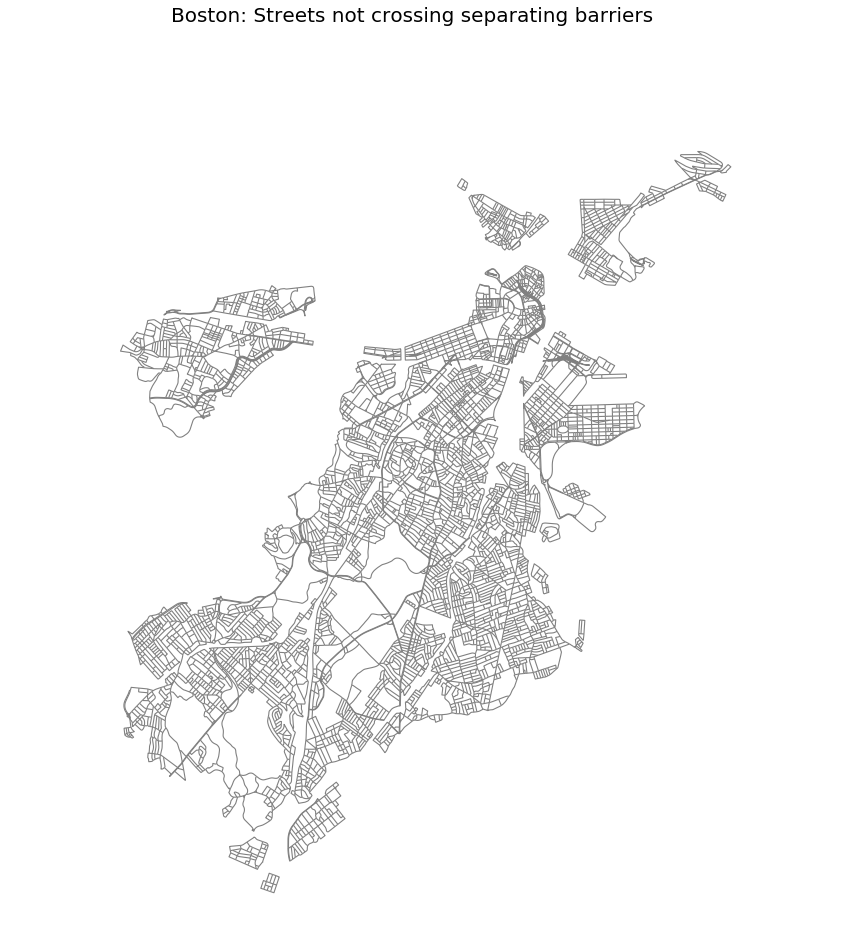

In [6]:
## removing streets segments which are crossing barriers
edges_graph_nb = edges_graph[edges_graph.sep_barr != True].copy()
nodes_graph_nb, edges_graph_nb = up.clean_network(nodes_graph, edges_graph_nb, dead_ends = True, 
                        remove_disconnected_islands = False, self_loops = True, same_uv_edges = True)
up.plot_lines(edges_graph_nb, black_background = False, fig_size = 15,  color = 'gray', 
              title = city_name+': Streets not crossing separating barriers', legend = False)

In [16]:
saving_path = 'C:/Users/g_filo01/sciebo/Scripts/Image of the City/Outputs/'+city_name+'/for_paper/'
to_convert = ['c_barr']
edges_graph_string = edges_graph.copy()
for column in to_convert: edges_graph_string[column] = edges_graph_string[column].astype(str)
edges_graph_string.to_file(saving_path+city_name+"_edges.shp", driver='ESRI Shapefile')
nodes_graph_nb.to_file(saving_path+city_name+"_nodes_nb.shp", driver='ESRI Shapefile')
edges_graph_nb.drop(['c_barr', 'sep_barr'], axis = 1).to_file(saving_path+city_name+"_edges_nb.shp", driver='ESRI Shapefile')

# 2. Creating dual graph for extracting regions

In [17]:
# Creating the dual geodataframes
nodesDual_graph, edgesDual_graph = up.dual_gdf(nodes_graph, edges_graph.drop('c_barr', axis = 1), epsg)
nodesDual_graph_nb, edgesDual_graph_nb = up.dual_gdf(nodes_graph_nb, edges_graph_nb.drop('c_barr', axis = 1), epsg)

# saving
saving_path = 'C:/Users/g_filo01/sciebo/Scripts/Image of the City/Outputs/'+city_name+'/for_paper/'
nodesDual_graph.drop(['intersecting'], axis = 1, errors = 'ignore').to_file(saving_path+city_name+"_nodesDual.shp", driver='ESRI Shapefile')
edgesDual_graph.to_file(saving_path+city_name+"_edgesDual.shp", driver='ESRI Shapefile')
nodesDual_graph_nb.drop(['intersecting'], axis = 1, errors = 'ignore').to_file(saving_path+city_name+"_nodesDual_nb.shp", driver='ESRI Shapefile')
edgesDual_graph_nb.to_file(saving_path+city_name+"_edgesDual_nb.shp", driver='ESRI Shapefile')

In [4]:
# loading dual graph
loading_path = 'C:/Users/g_filo01/sciebo/Scripts/Image of the City/Outputs/'+city_name+'/for_paper/'
nodesDual_graph = gpd.read_file(loading_path+city_name+"_nodesDual.shp", driver='ESRI Shapefile')
edgesDual_graph = gpd.read_file(loading_path+city_name+"_edgesDual.shp", driver='ESRI Shapefile')
nodesDual_graph_nb = gpd.read_file(loading_path+city_name+"_nodesDual_nb.shp", driver='ESRI Shapefile')
edgesDual_graph_nb = gpd.read_file(loading_path+city_name+"_edgesDual_nb.shp", driver='ESRI Shapefile')
nodesDual_graph.index, nodesDual_graph_nb.index = nodesDual_graph.edgeID, nodesDual_graph_nb.edgeID
nodesDual_graph.index.name, nodesDual_graph_nb.index.name = None, None

In [5]:
# loading primal graph with barrier removal
nodes_graph_nb = gpd.read_file(loading_path+city_name+"_nodes_nb.shp", driver='ESRI Shapefile')
edges_graph_nb = gpd.read_file(loading_path+city_name+"_edges_nb.shp", driver='ESRI Shapefile')
nodes_graph_nb.index, edges_graph_nb.index = nodes_graph_nb.nodeID, edges_graph_nb.edgeID
nodes_graph_nb.index.name, edges_graph_nb.index.name = None, None

In [6]:
# creating dual_graph and primal graphs
graph = up.graph_fromGDF(nodes_graph, edges_graph)
dual_graph = up.dual_graph_fromGDF(nodesDual_graph, edgesDual_graph)
graph_nb = up.graph_fromGDF(nodes_graph_nb, edges_graph_nb)
dual_graph_nb = up.dual_graph_fromGDF(nodesDual_graph_nb, edgesDual_graph_nb)

### 2.1 District identification - Single Membership

In [9]:
## creating graph usable in igraph
nodesDual_graphIG, edgesDual_graphIG = up.reset_index_dual_gdfsIG(nodesDual_graph, edgesDual_graph)
dual_graphIG = up.dual_graphIG_fromGDF(nodesDual_graphIG, edgesDual_graphIG)
## creating graph usable in igraph - barriers removal
nodesDual_graphIG_nb, edgesDual_graphIG_nb = up.reset_index_dual_gdfsIG(nodesDual_graph_nb, edgesDual_graph_nb)
dual_graphIG_nb = up.dual_graphIG_fromGDF(nodesDual_graphIG_nb, edgesDual_graphIG_nb)

### Extract the communities -- Dual Graph
#### Entire Street Network

In [158]:
# Clauset-Newman-Moore greedy modularity maximization
clauset = list(nxcomm.greedy_modularity_communities(dual_graphIG))
for community, n in enumerate(clauset):
    nodesDual_graphIG.loc[nodesDual_graphIG.index.isin(list(n)), 'ca'] = community 

# label_propagation
label_propagation = nxcomm.label_propagation_communities(dual_graphIG)
for community, n in enumerate(label_propagation):
    nodesDual_graphIG.loc[nodesDual_graphIG.index.isin(list(n)), 'lp'] = community 

# waltrap
walktrap = algorithms.walktrap(dual_graphIG)
for community, n in enumerate(walktrap.communities): 
    nodesDual_graphIG.loc[nodesDual_graphIG.index.isin(n), 'wa'] = community

# louvain
louvain = up.best_partition(dual_graphIG, weight='rad')
nodesDual_graphIG['lo'] = nodesDual_graphIG.index.map(louvain)

columns = ['ca', 'lp','wa', 'lo']
to_merge = ['edgeID']+columns
districts = pd.merge(edges_graph, nodesDual_graphIG[to_merge], left_on = "edgeID", right_on = "edgeID", how= "left")
for i in columns:
    districts[i] = districts[i].astype(int) 

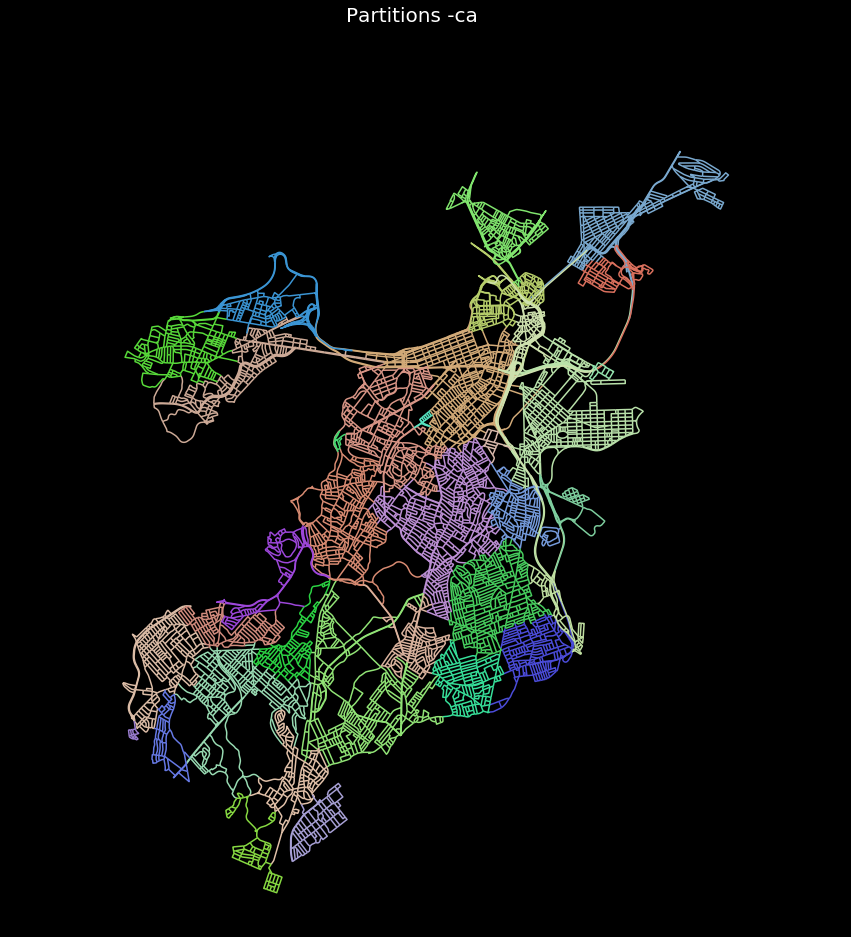

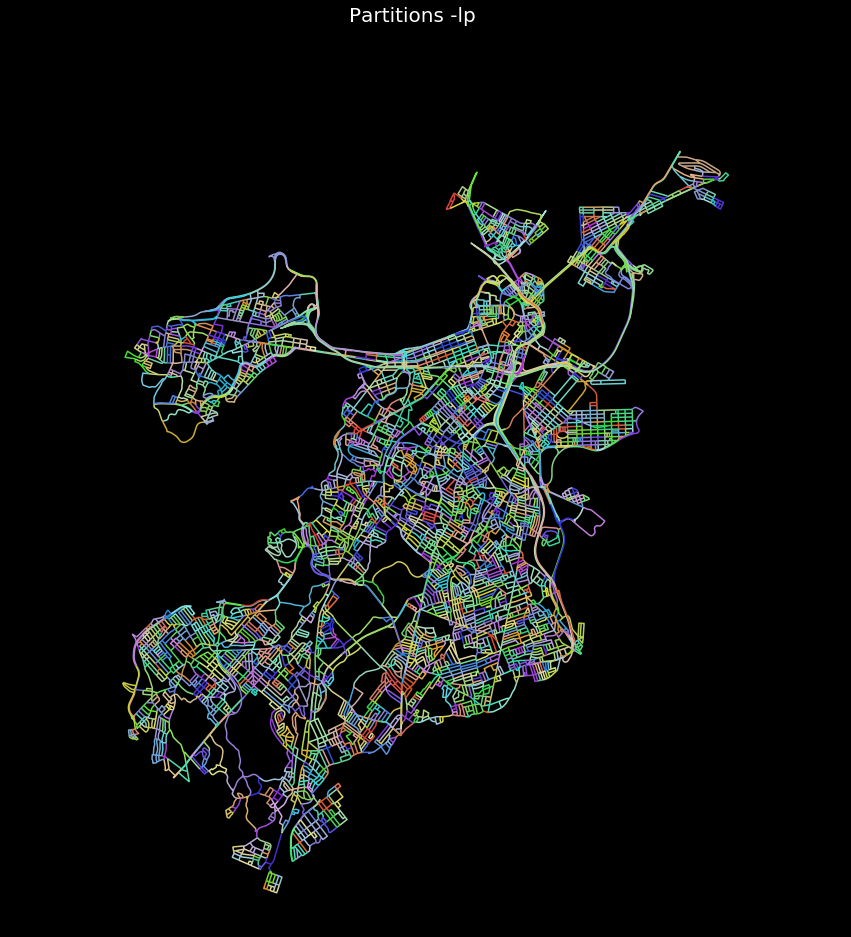

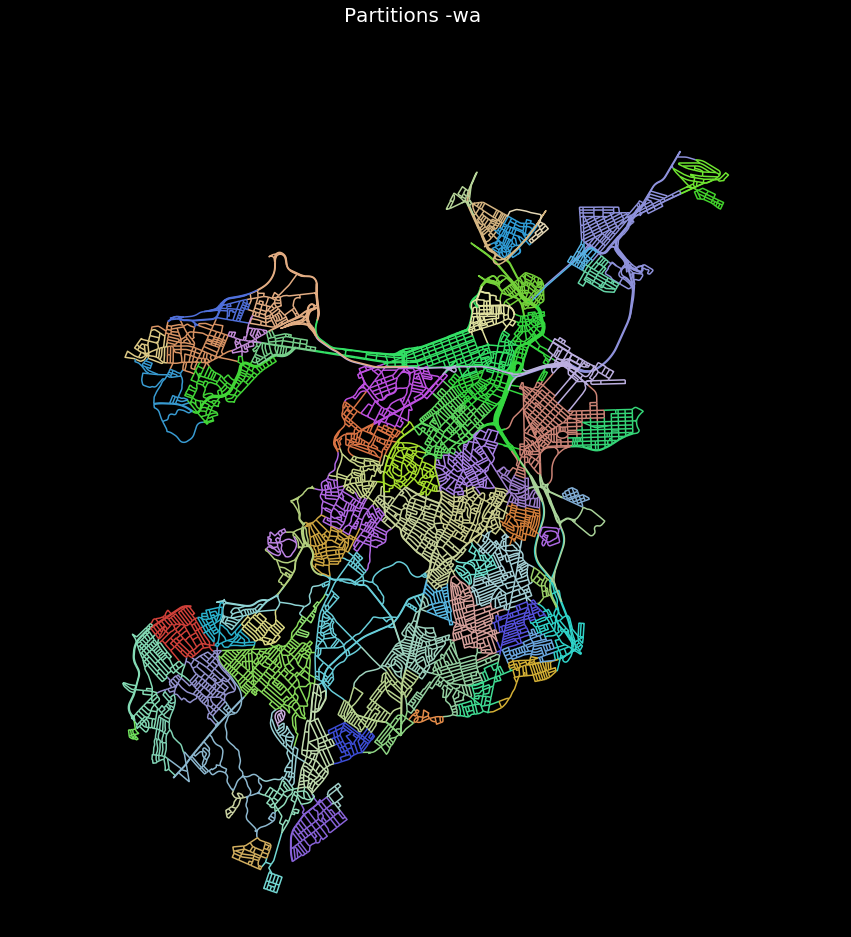

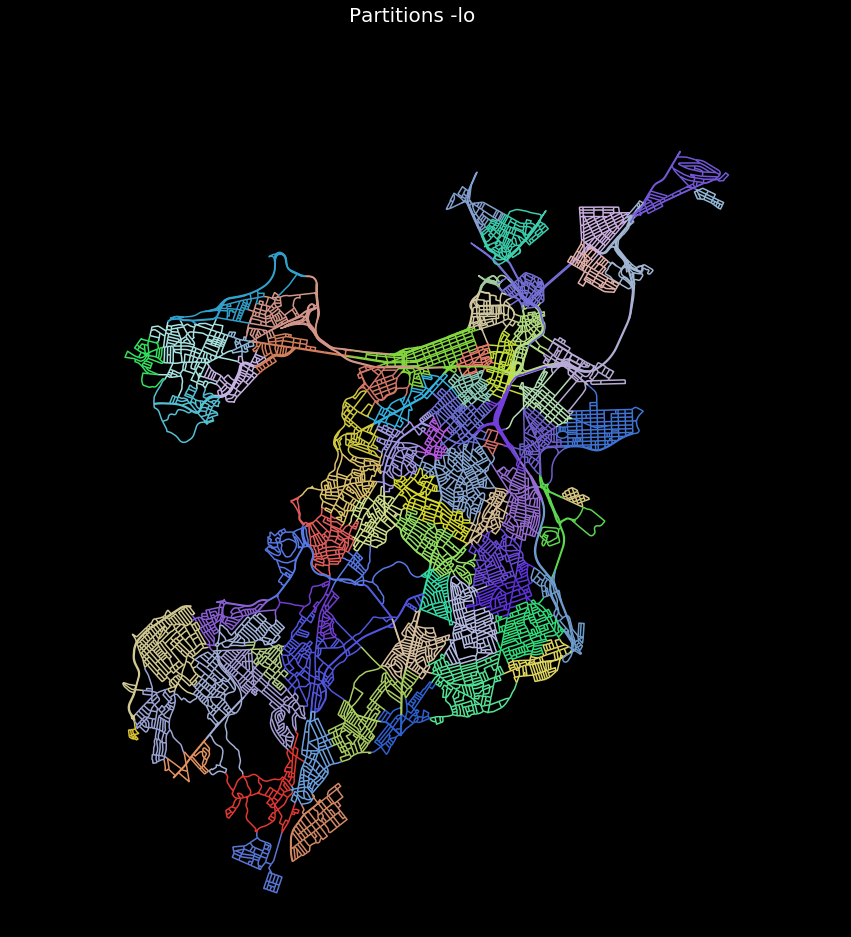

In [83]:
for column in columns:
    cmap = up.rand_cmap(nlabels = len(districts[column].unique()), type_color='bright', first_color_black=False, 
                     last_color_black=False)
    up.plot_lines(districts, column = column, title = 'Partitions -'+column, lw = 1.5, cmap = cmap, 
                  black_background = True, legend = False, fig_size = 15)

#### Barrier removal

In [159]:
# Clauset-Newman-Moore greedy modularity maximization
clauset_nb = list(nxcomm.greedy_modularity_communities(dual_graphIG_nb))
for community, n in enumerate(clauset_nb):
    nodesDual_graphIG_nb.loc[nodesDual_graphIG_nb.index.isin(list(n)), 'ca_nb'] = community 

# label_propagation
label_propagation_nb = nxcomm.label_propagation_communities(dual_graphIG_nb)
for community, n in enumerate(label_propagation_nb):
    nodesDual_graphIG_nb.loc[nodesDual_graphIG_nb.index.isin(list(n)), 'lp_nb'] = community 

# waltrap
walktrap_nb = algorithms.walktrap(dual_graphIG_nb)
for community, n in enumerate(walktrap_nb.communities): 
    nodesDual_graphIG_nb.loc[nodesDual_graphIG_nb.index.isin(n), 'wa_nb'] = community

# louvain
louvain_nb = up.best_partition(dual_graphIG_nb, weight='rad')
nodesDual_graphIG_nb['lo_nb'] = nodesDual_graphIG_nb.index.map(louvain_nb)

columns_nb = ['ca_nb', 'lp_nb','wa_nb', 'lo_nb']
to_merge = ['edgeID']+columns_nb
districts = pd.merge(districts, nodesDual_graphIG_nb[to_merge], left_on = "edgeID", right_on = "edgeID", how= "left")
districts[columns_nb] = districts[columns_nb].where(~districts[columns_nb].isnull(), 999999)
for i in columns_nb:
    districts[i] = districts[i].astype(int) 

In [160]:
# saving
saving_path = 'C:/Users/g_filo01/sciebo/Scripts/Image of the City/Outputs/'+city_name+'/for_paper/'
districts.drop('c_barr', axis =1).to_file(saving_path+city_name+"_districts.shp", driver='ESRI Shapefile')

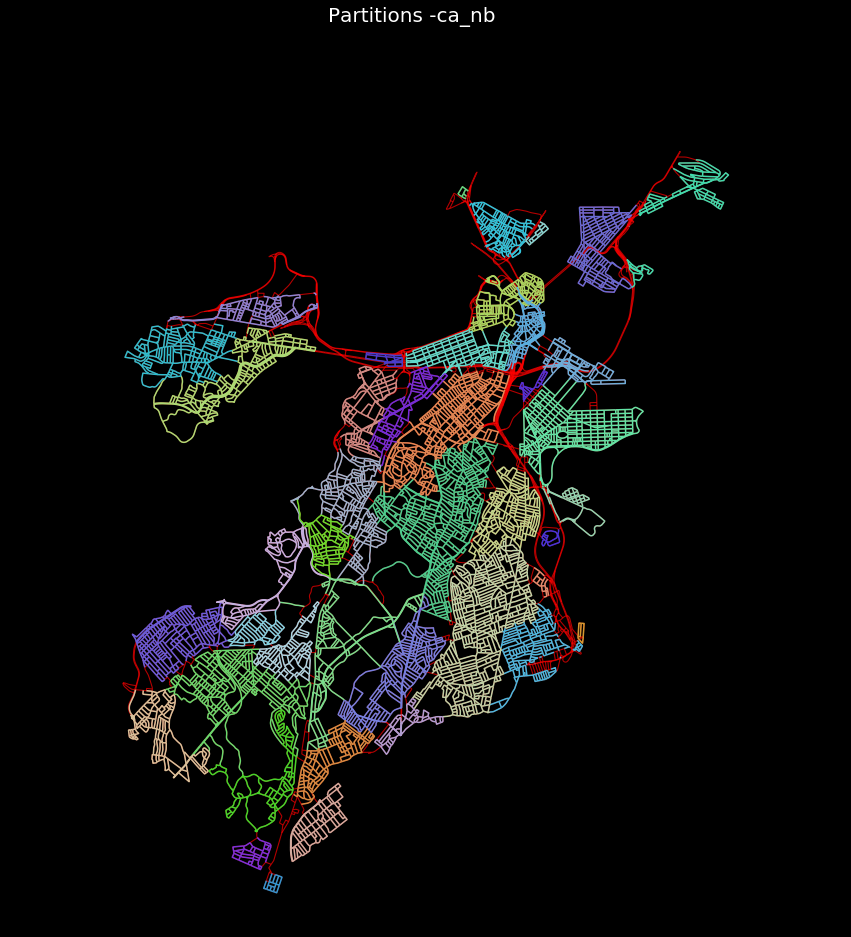

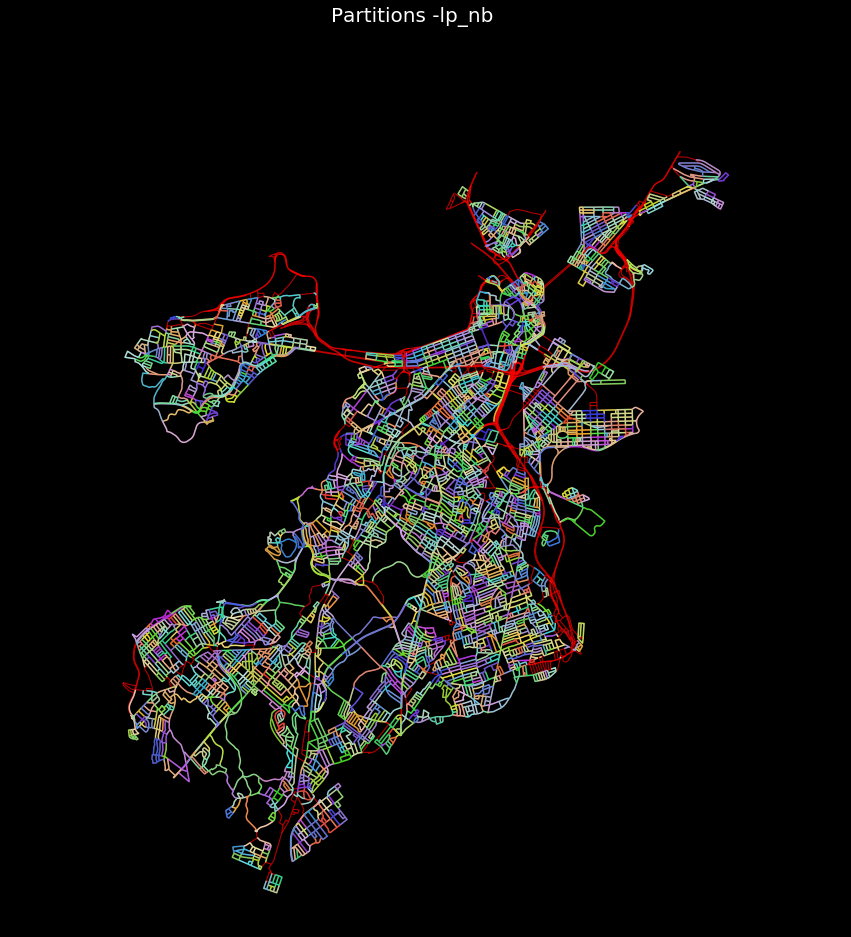

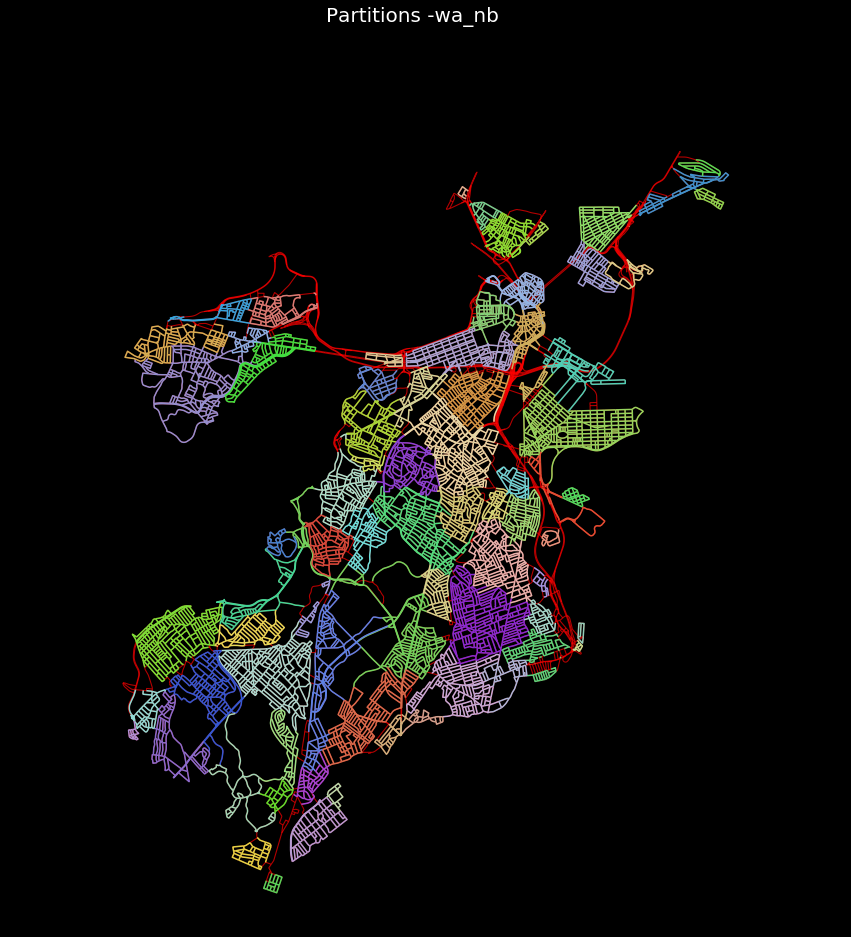

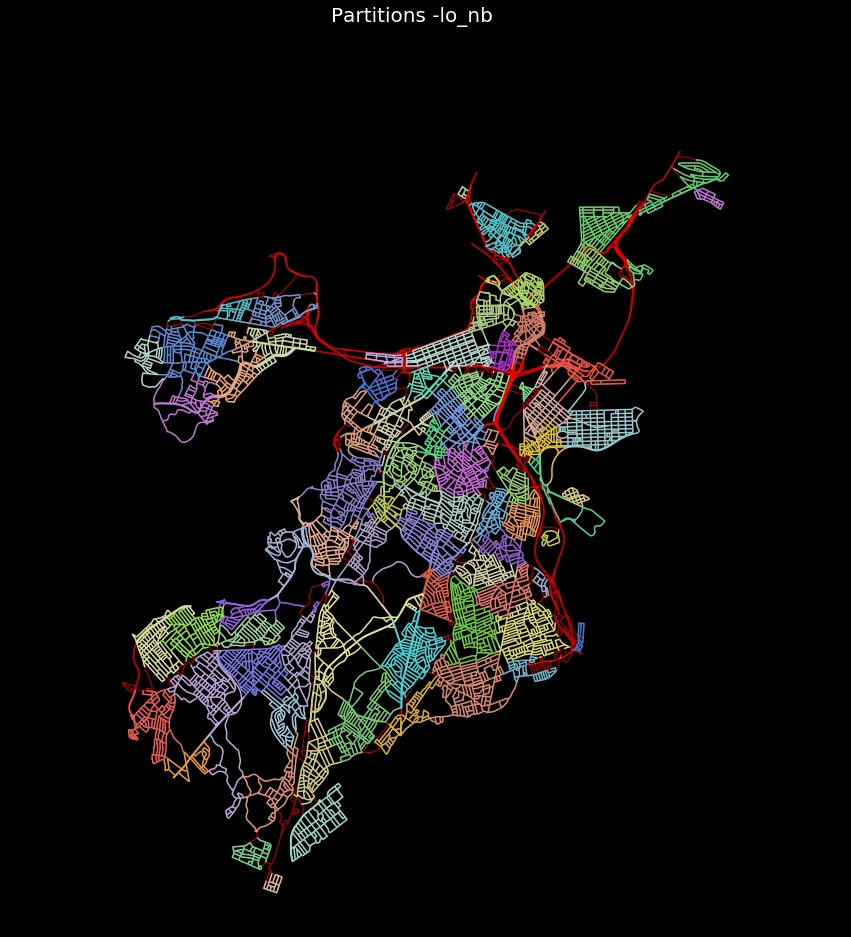

In [89]:
for column in columns_nb:
    cmap = up.rand_cmap(nlabels = len(districts[column].unique()), type_color='bright', first_color_black=False, 
                     last_color_black=False)
    up.plot_lines(districts[districts[column] != 999999], column = column, title = 'Partitions -'+column, lw = 1.5, cmap = cmap, 
                  black_background = True, legend = False, fig_size = 15,
                  gdf_base_map = edges_graph, base_map_alpha = 0.7, base_map_color = 'red')

### Extract the communities -- Primal Graph
#### Entire Street Network

In [20]:
## creating graph usable in igraph
nodes_graphIG, edges_graphIG = up.reset_index_gdfs_forIG(nodes_graph, edges_graph, 'nodeID')
graphIG = up.graph_fromGDF(nodes_graphIG, edges_graphIG)
## creating graph usable in igraph - barriers removal
nodes_graphIG_nb, edges_graphIG_nb = up.reset_index_gdfs_forIG(nodes_graph_nb, edges_graph_nb, 'nodeID')
graphIG_nb = up.graph_fromGDF(nodes_graphIG_nb, edges_graphIG_nb)

In [167]:
# Clauset-Newman-Moore greedy modularity maximization
clauset = list(nxcomm.greedy_modularity_communities(graphIG))
for community, n in enumerate(clauset):
    nodes_graphIG.loc[nodes_graphIG.index.isin(list(n)), 'ca'] = community 

# label_propagation
label_propagation = nxcomm.label_propagation_communities(graphIG)
for community, n in enumerate(label_propagation):
    nodes_graphIG.loc[nodes_graphIG.index.isin(list(n)), 'lp'] = community 

# waltrap
walktrap = algorithms.walktrap(graphIG)
for community, n in enumerate(walktrap.communities): 
    nodes_graphIG.loc[nodes_graphIG.index.isin(n), 'wa'] = community

# louvain
louvain = up.best_partition(graphIG, weight='length')
nodes_graphIG['lo'] = nodes_graphIG.index.map(louvain)

columns = ['ca', 'lp','wa', 'lo']
to_merge = ['old_nodeID']+columns
nodes_districts = pd.merge(nodes_graph, nodes_graphIG[to_merge], left_on = "nodeID", right_on = "old_nodeID", how= "left")
nodes_districts.drop('old_nodeID', axis = 1, inplace = True)
for i in columns:
     nodes_districts[i] = nodes_districts[i].astype(int)

#### Barrier removal

In [168]:
# Clauset-Newman-Moore greedy modularity maximization
clauset = list(nxcomm.greedy_modularity_communities(graphIG_nb))
for community, n in enumerate(clauset):
    nodes_graphIG_nb.loc[nodes_graphIG_nb.index.isin(list(n)), 'ca_nb'] = community 

# label_propagation
label_propagation = nxcomm.label_propagation_communities(graphIG_nb)
for community, n in enumerate(label_propagation):
    nodes_graphIG_nb.loc[nodes_graphIG_nb.index.isin(list(n)), 'lp_nb'] = community 

# waltrap
walktrap = algorithms.walktrap(graphIG_nb)
for community, n in enumerate(walktrap.communities): 
    nodes_graphIG_nb.loc[nodes_graphIG_nb.index.isin(n), 'wa_nb'] = community

# louvain
louvain = up.best_partition(graphIG_nb, weight='length')
nodes_graphIG_nb['lo_nb'] = nodes_graphIG_nb.index.map(louvain)

columns_nb = ['ca_nb', 'lp_nb','wa_nb', 'lo_nb']
to_merge = ['old_nodeID']+columns_nb
nodes_districts = pd.merge(nodes_districts, nodes_graphIG_nb[to_merge], left_on = "nodeID", right_on = "old_nodeID", how= "left")
nodes_districts.drop('old_nodeID', axis = 1, inplace = True)
nodes_districts[columns_nb] = nodes_districts[columns_nb].where(~nodes_districts[columns_nb].isnull(), 999999)
for i in columns_nb:
     nodes_districts[i] = nodes_districts[i].astype(int)
        
nodes_districts.index = nodes_districts['nodeID']
nodes_districts.index.name = None

In [169]:
to_assign = columns+columns_nb
districts_primal = edges_graph.copy()

for i in to_assign:
    districts_primal = assign_districts_to_edges_from_nodes(districts_primal, nodes_districts, district_field = i)

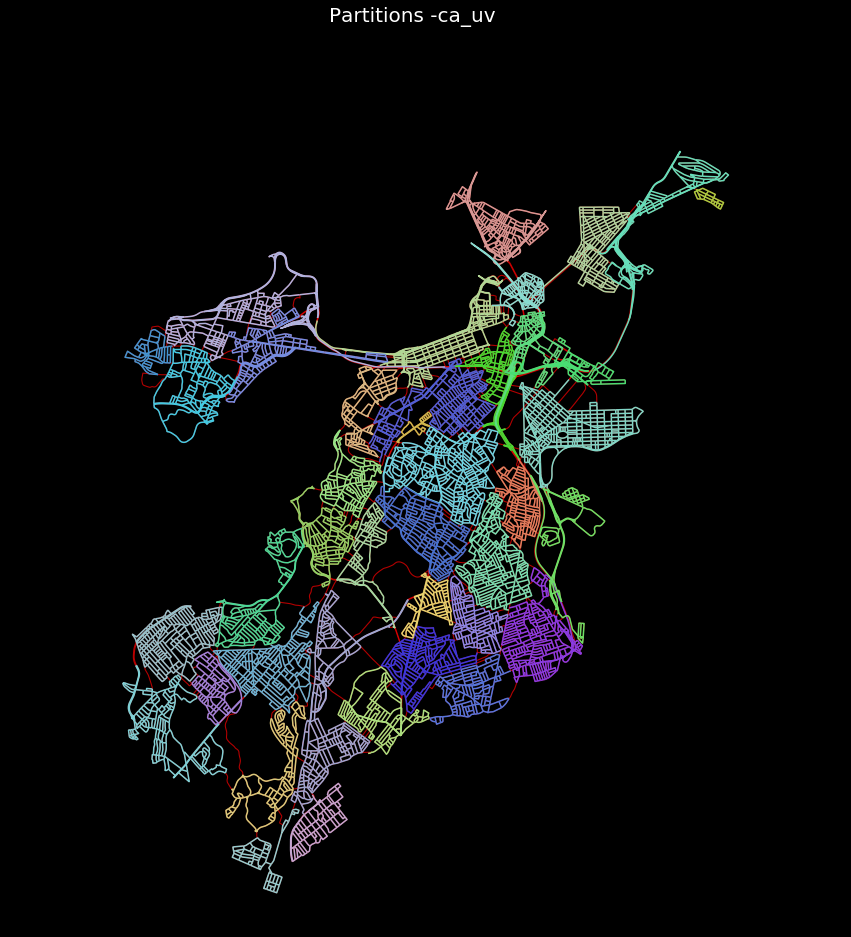

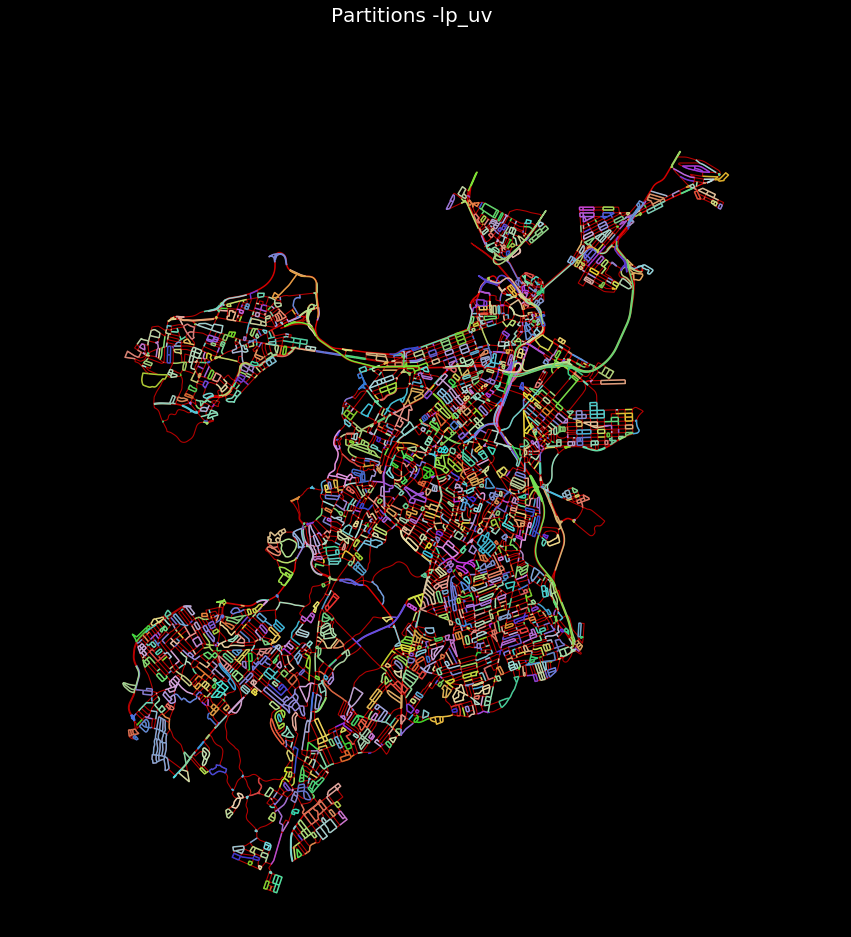

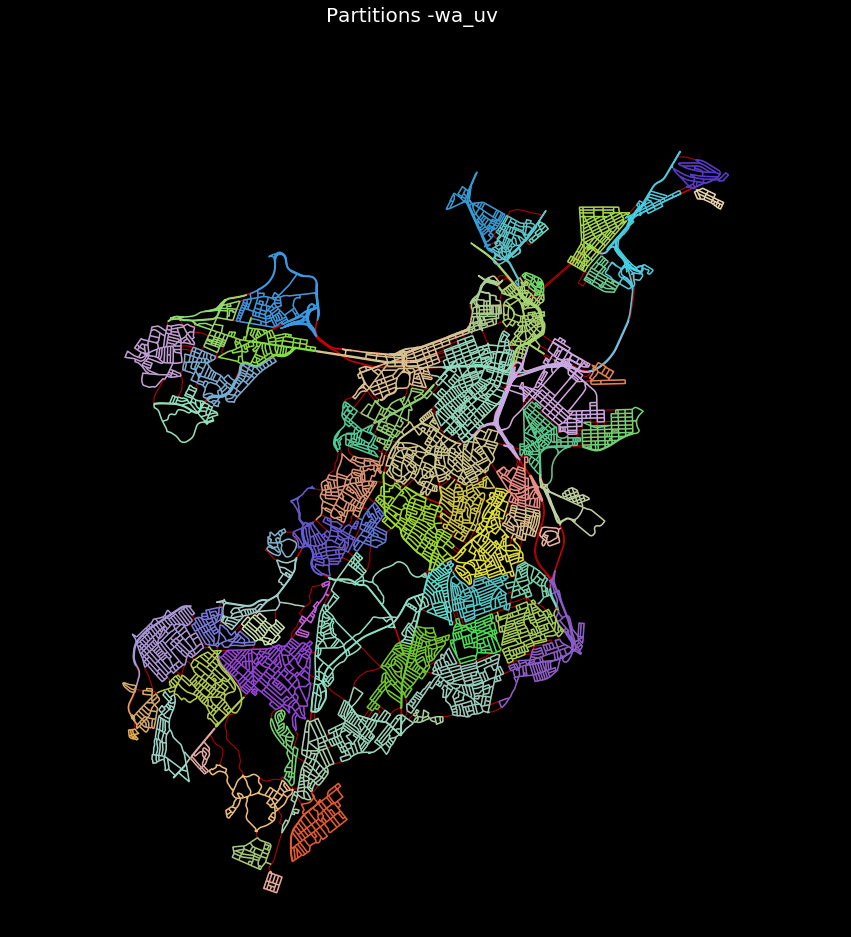

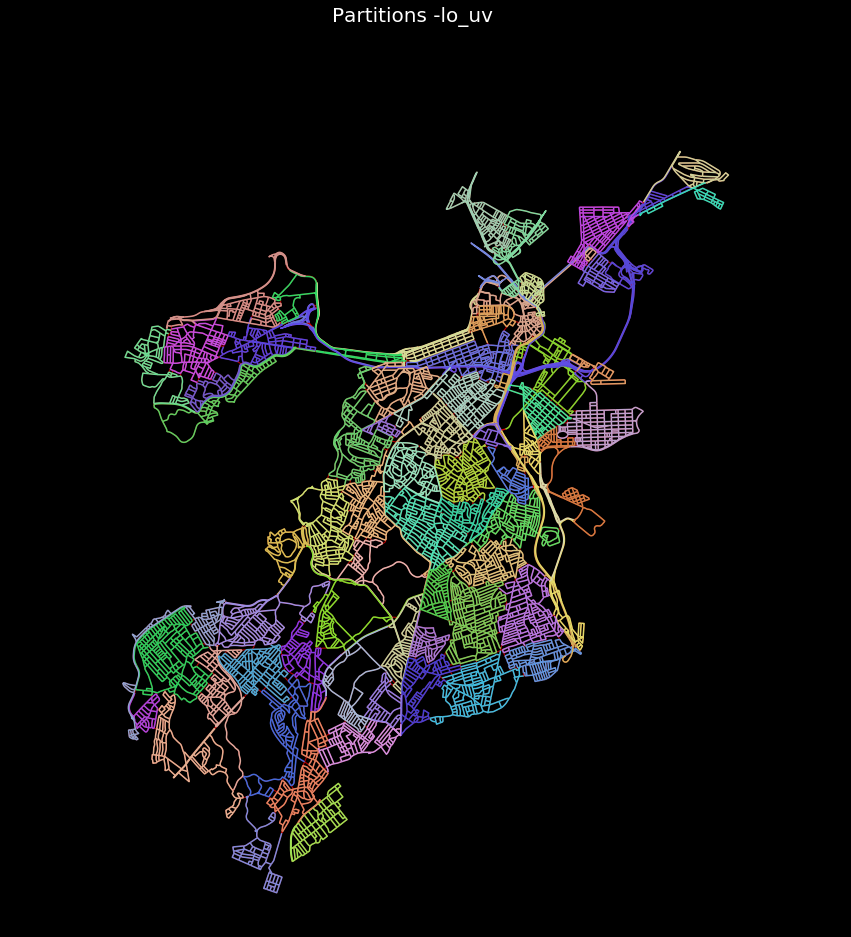

In [154]:
to_show = ['ca_uv', 'lp_uv', 'wa_uv','lo_uv']

for column in to_show:
    cmap = up.rand_cmap(nlabels = len(districts_primal[column].unique()), type_color='bright', first_color_black=False, 
                     last_color_black=False)
    up.plot_lines(districts_primal[districts_primal[column] != 999999], column = column, title = 'Partitions -'+column, lw = 1.5, cmap = cmap, 
                  black_background = True, legend = False, fig_size = 15,
                  gdf_base_map = edges_graph, base_map_alpha = 0.7, base_map_color = 'red')

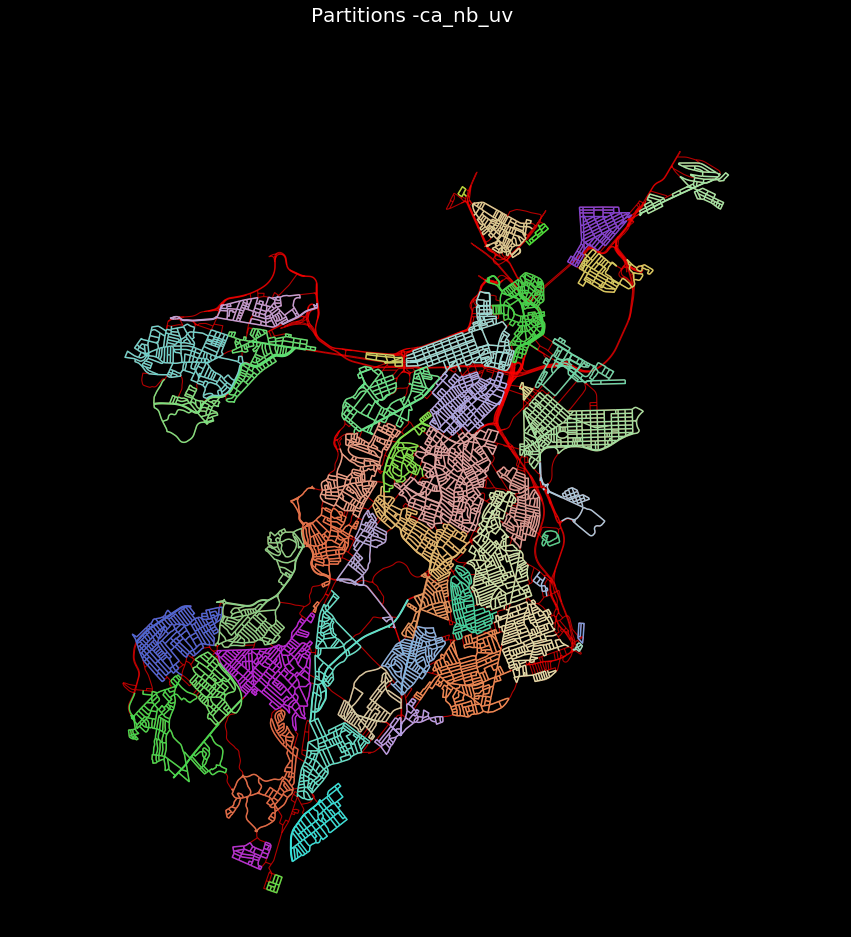

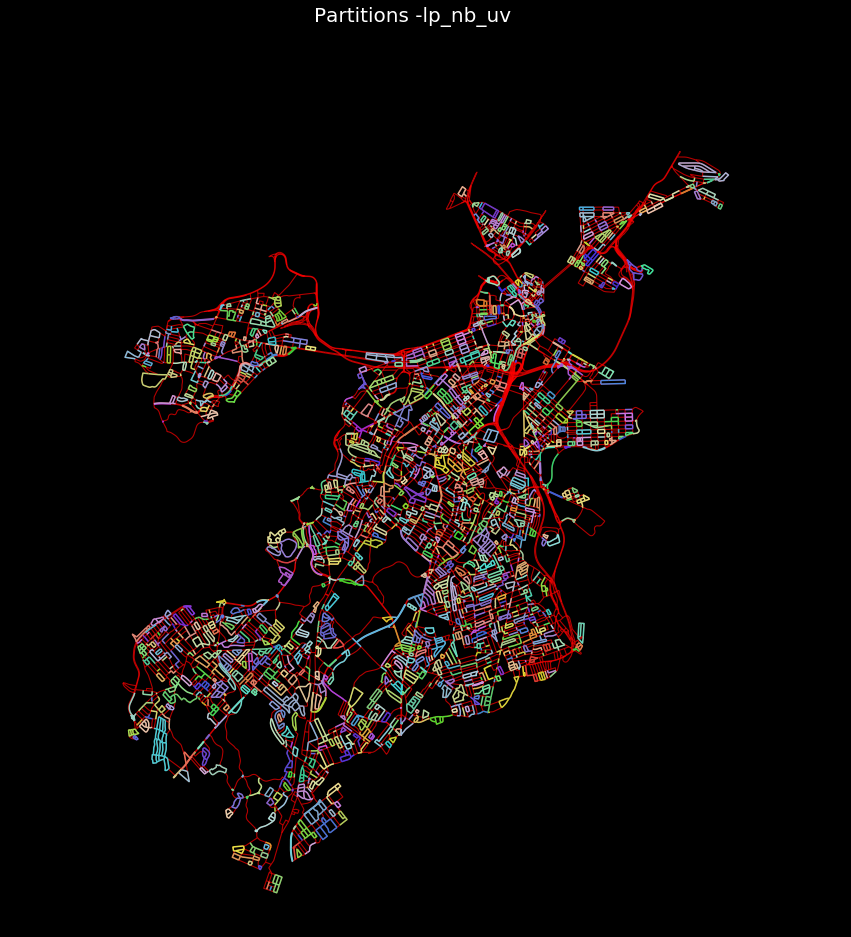

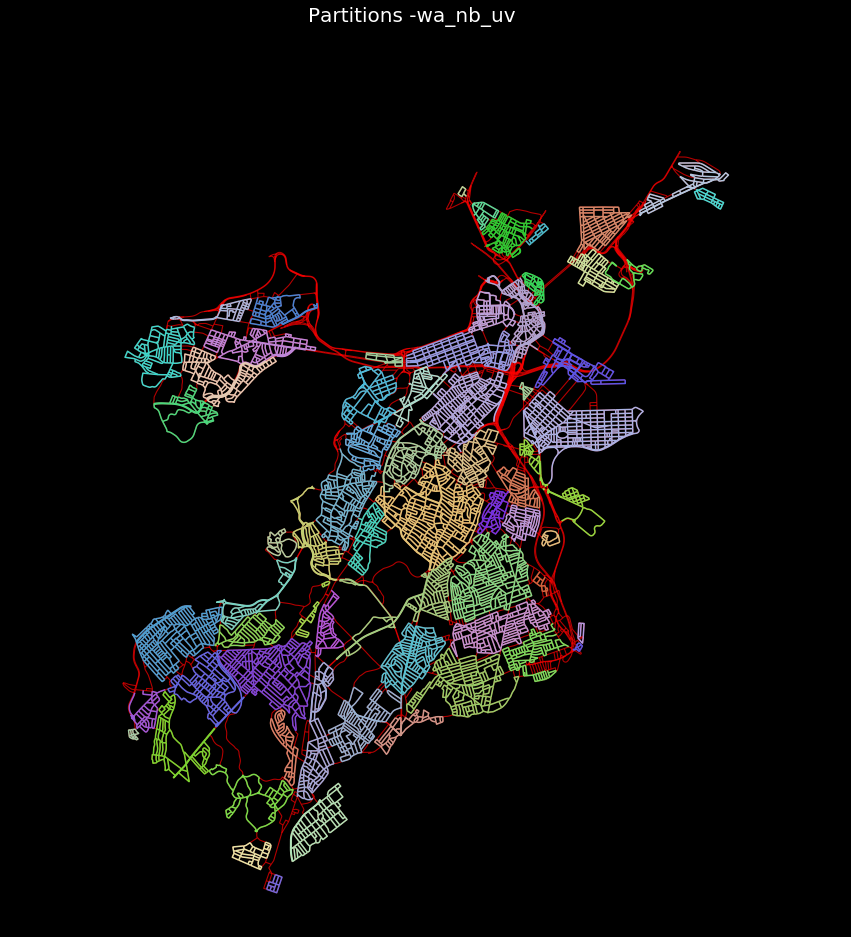

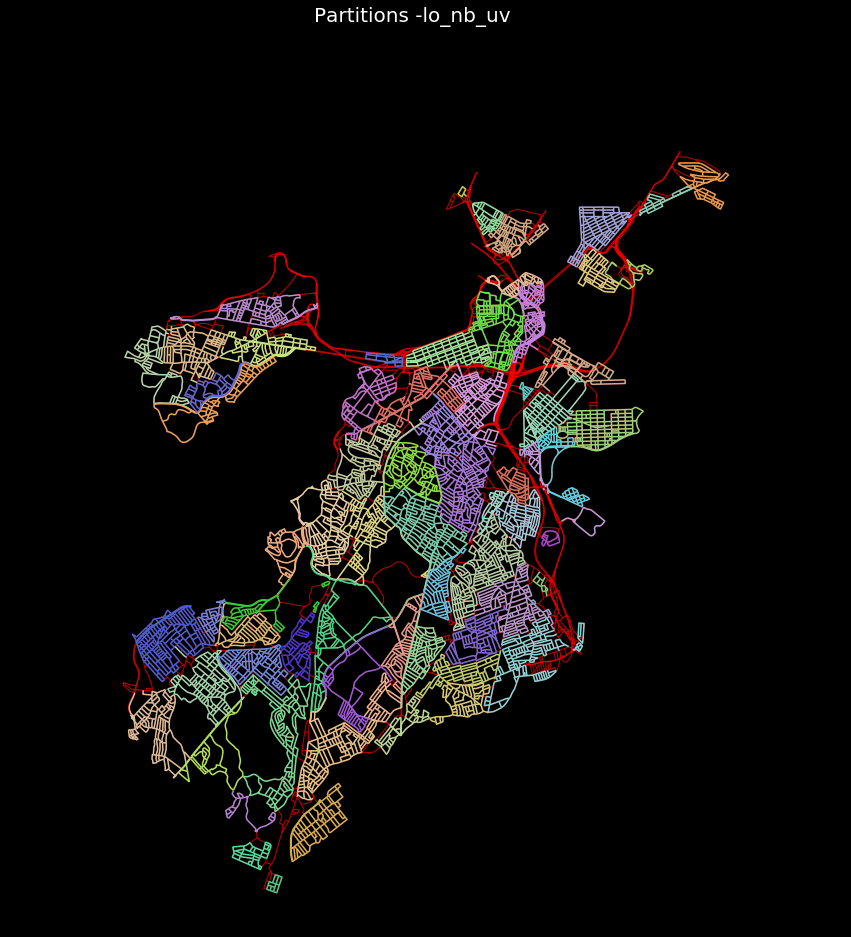

In [170]:
to_show = ['ca_nb_uv', 'lp_nb_uv', 'wa_nb_uv','lo_nb_uv']

for column in to_show:
    cmap = up.rand_cmap(nlabels = len(districts_primal[column].unique()), type_color='bright', first_color_black=False, 
                     last_color_black=False)
    up.plot_lines(districts_primal[districts_primal[column] != 999999], column = column, title = 'Partitions -'+column, lw = 1.5, cmap = cmap, 
                  black_background = True, legend = False, fig_size = 15,
                  gdf_base_map = edges_graph, base_map_alpha = 0.7, base_map_color = 'red')

In [171]:
# saving
saving_path = 'C:/Users/g_filo01/sciebo/Scripts/Image of the City/Outputs/'+city_name+'/for_paper/'
districts_primal.drop('c_barr', axis =1).to_file(saving_path+city_name+"_districts_primal.shp", driver='ESRI Shapefile')

### Comparison different methods vs louvain

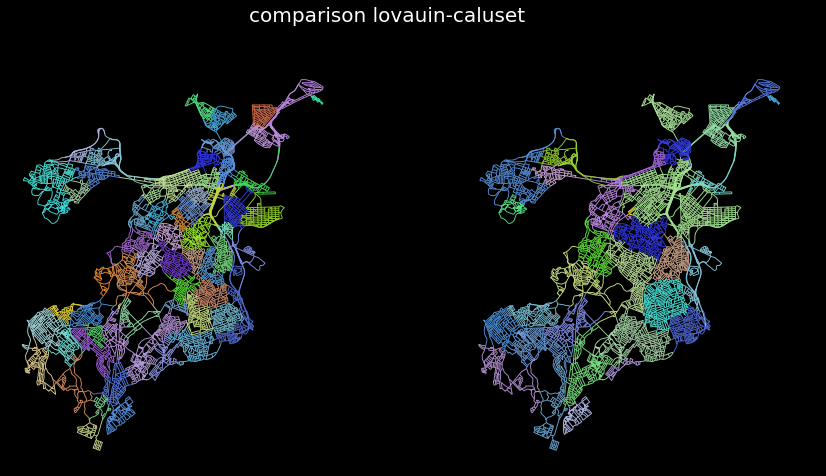

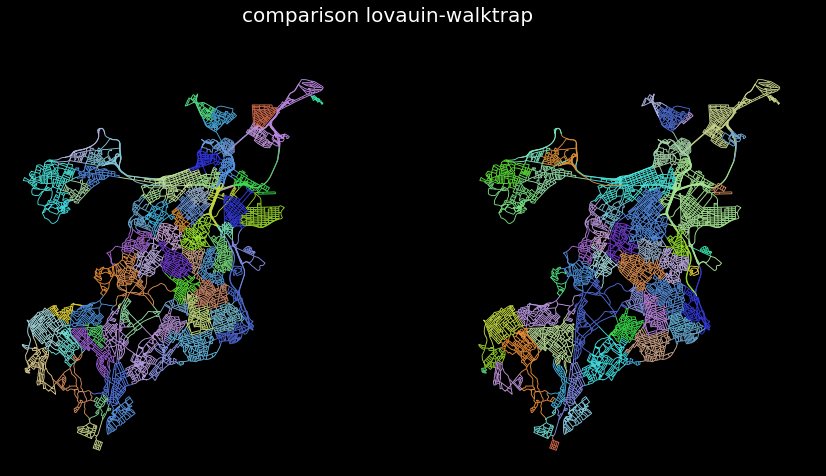

In [29]:
to_compare = ['caluset', 'walktrap']
for column in to_compare:
    up.cmap = up.rand_cmap(nlabels = 400, type_color='bright', first_color_black=False, last_color_black=False)
    up.plot_lines_aside(districts_fn, gdf_c = districts_fn, lw = 0.9, columnA = 'louvain' , columnB = column, 
                    title = 'comparison lovauin-'+column, scheme = None, cmap = cmap, black_background = True, 
                     fig_size = 15)

### Partitions as polygons

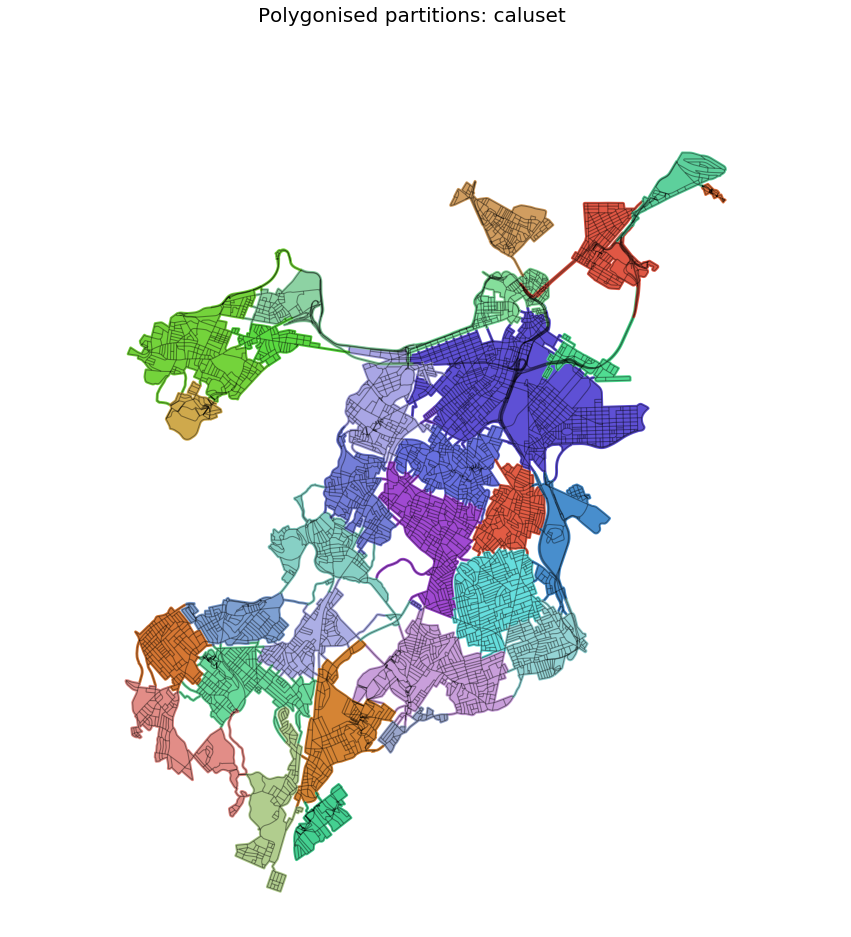

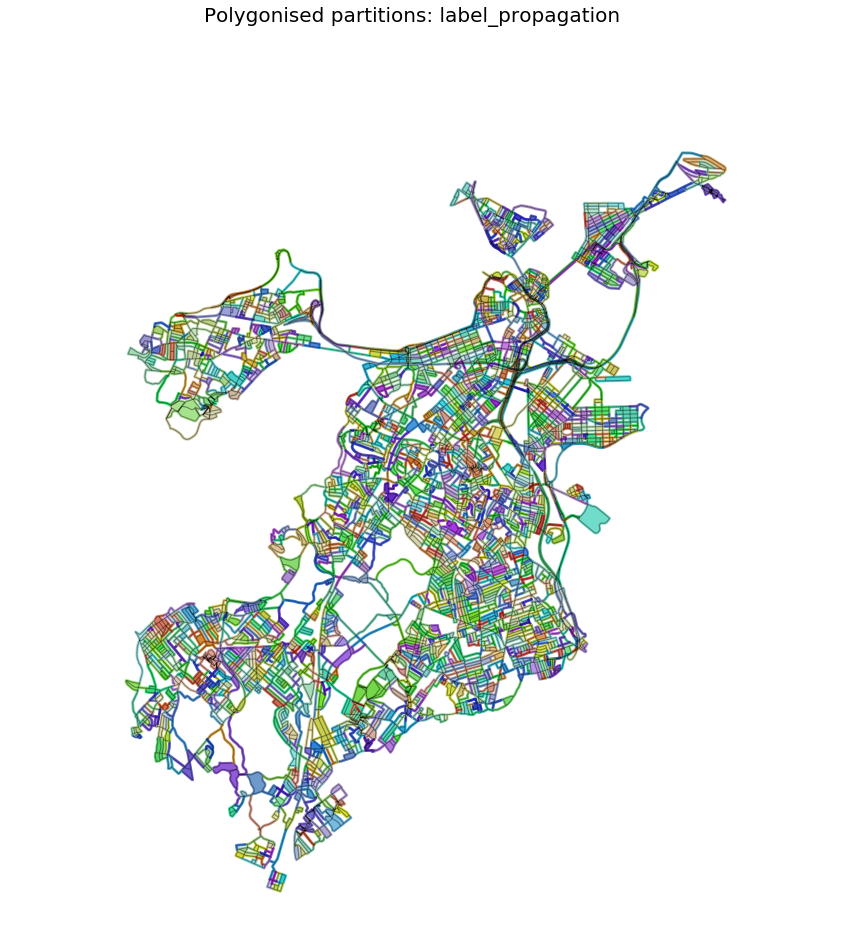

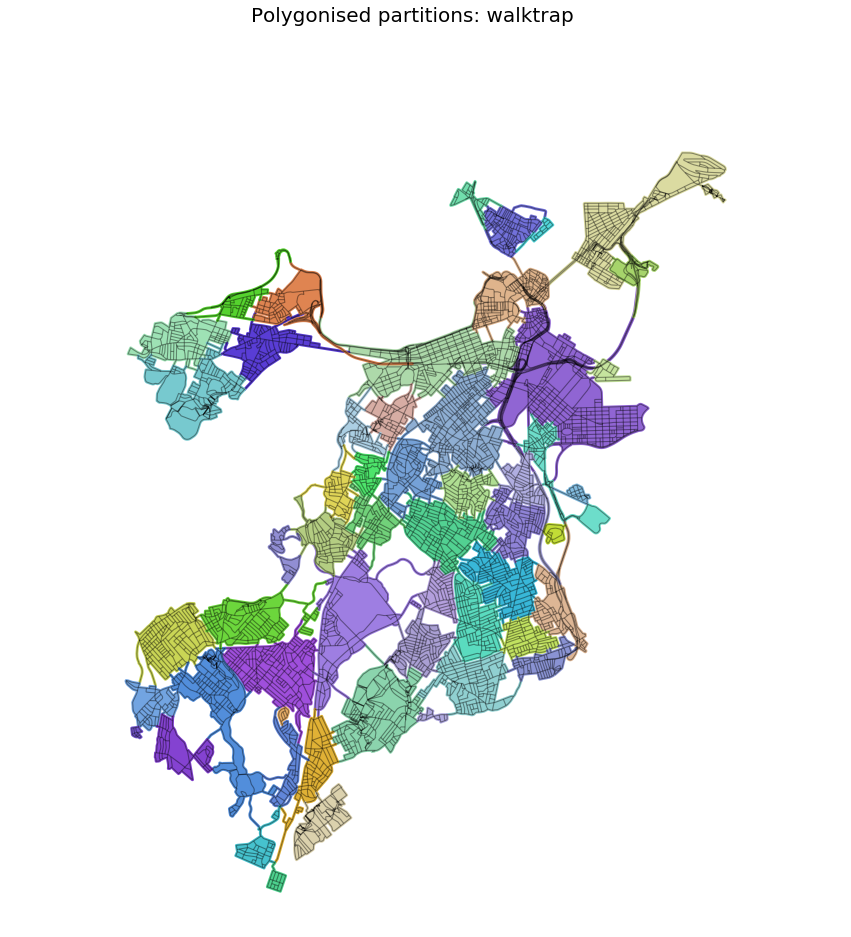

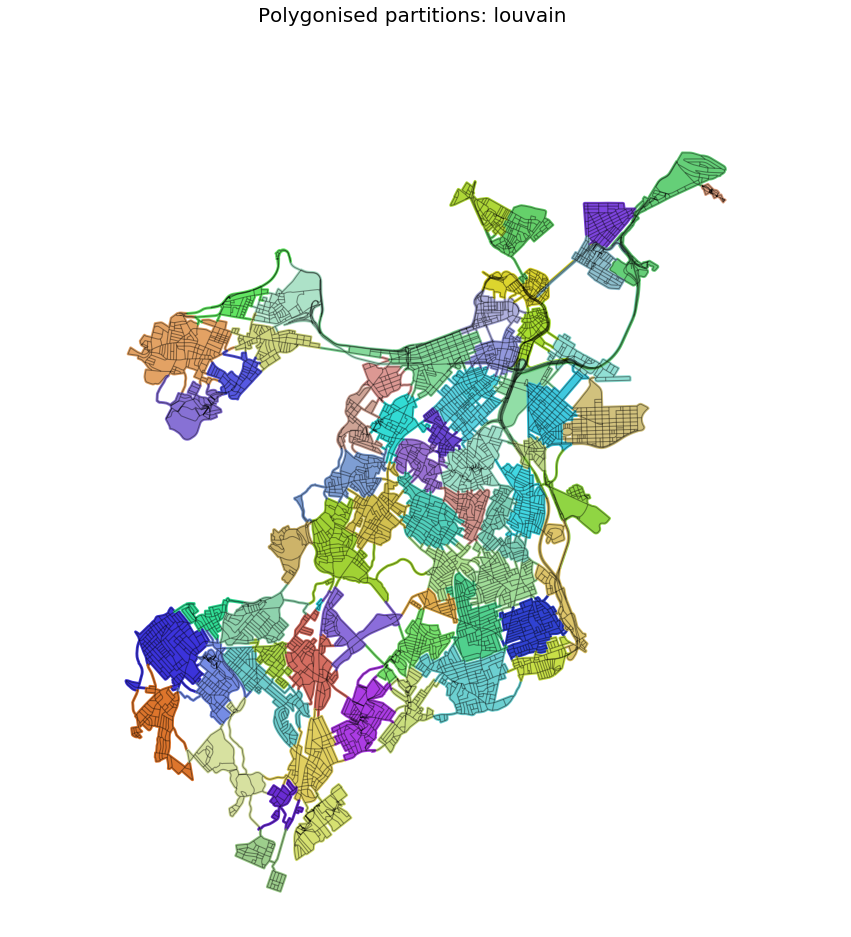

In [30]:
for column in columns:
    cmap = up.rand_cmap(nlabels = len(districts_fn[column].unique()), type_color='bright', first_color_black=False, 
                     last_color_black=False)
    partitions = up.polygonise_partition(districts_fn, column, crs)
    up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions: "+ column, 
                     black_background = False,  fig_size = 15, gdf_base_map = edges_graph)

## 2.2 District identification - Overlapping communities

In [62]:
from shapely.ops import polygonize_full, polygonize, unary_union
def polygonise_overlapping(communities, nodesDual_gdf, edges_gdf,method = 'convex_hull'):
    
    polygons = []
    partitionIDs = []
    d = {'geometry' : polygons, 'partitionID' : partitionIDs}
    
    for n, comm in enumerate(communities):
        tmp_nodes = nodesDual_gdf[nodesDual_gdf.index.isin(comm)].copy()
        tmp_edges = edges_gdf[edges_gdf.edgeID.isin(tmp_nodes.edgeID)]
        polygon =  polygonize_full(tmp_edges.geometry.unary_union)
        polygon = unary_union(polygon).buffer(10)
        if method == 'convex_hull': polygon = polygon.convex_hull
        polygons.append(polygon)
        partitionIDs.append(n)

    df = pd.DataFrame(d)
    partitions_polygonised = gpd.GeoDataFrame(df, crs=edges_gdf.crs, geometry=df['geometry'])
    return partitions_polygonised

def polygonise_communities(communities, street_gdf, crs):
    polygons = []
    partitionIDs = []
    d = {'geometry' : polygons, 'partitionID' : partitionIDs}
    
    for n,comm in enumerate(communities):
        tmp = street_gdf[street_gdf.index.isin(comm)].copy()
        polygon =  tmp.geometry.unary_union.convex_hull
        polygons.append(polygon)
        partitionIDs.append(n)

    df = pd.DataFrame(d)
    partitions_polygonised = gpd.GeoDataFrame(df, crs=crs, geometry=df['geometry'])
    return partitions_polygonised

2637


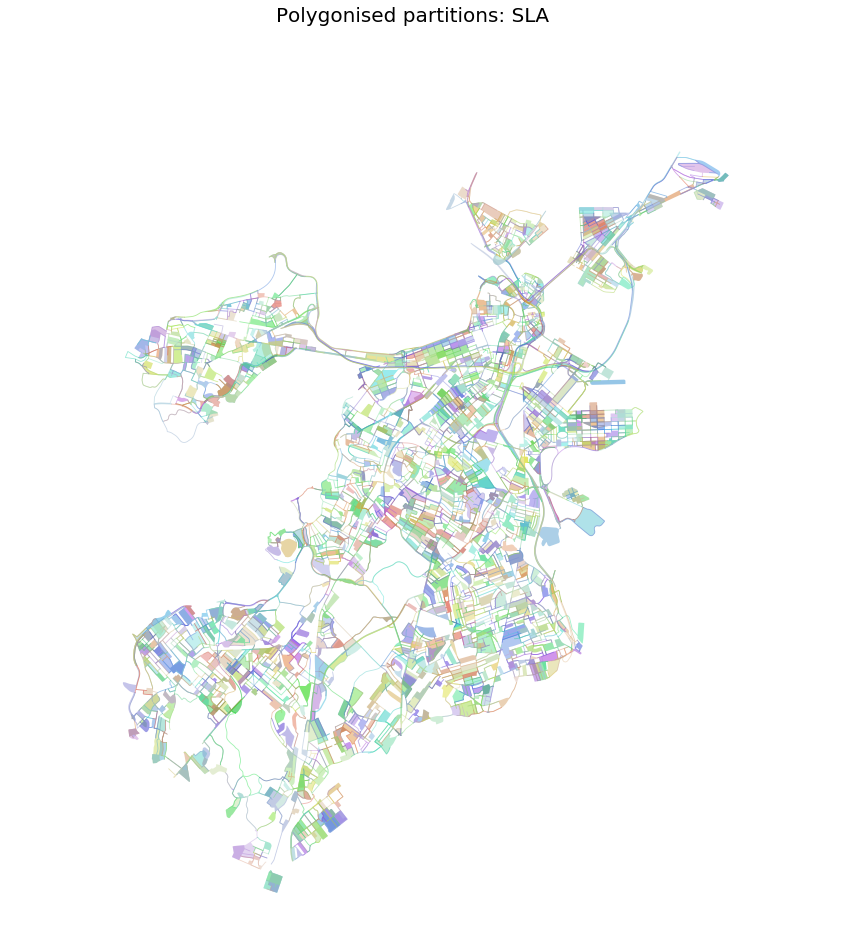

In [102]:
# lais2
com = algorithms.lais2(dual_graphIG)
lais2 = com.communities
print(len(lais2))
partitions = polygonise_overlapping(lais2, nodesDual_graphIG, edges_graph, None)
cmap = up.rand_cmap(nlabels = len(partitions), type_color='bright', first_color_black=False, 
                 last_color_black=False)
up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions: SLA",  alpha = 0.5,
                 black_background = False,  fig_size = 15)

2052


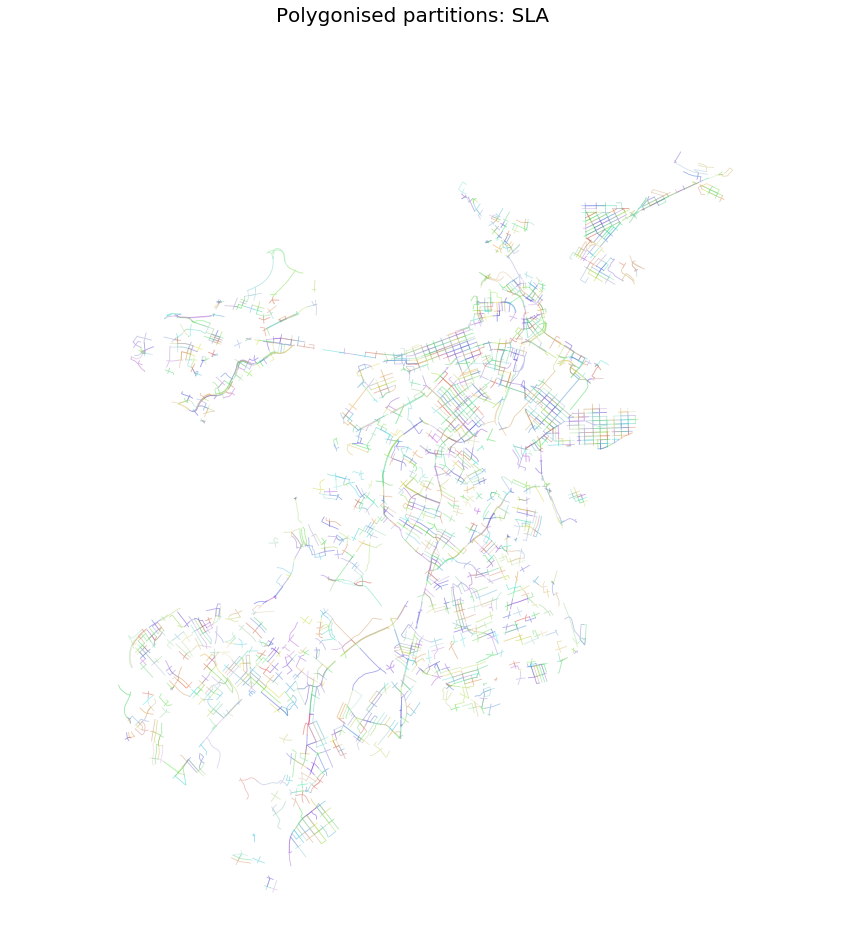

In [100]:
# kclique
com = algorithms.kclique(dual_graphIG, k=4)
kclique = com.communities
print(len(kclique))
partitions = polygonise_overlapping(kclique, nodesDual_graphIG, edges_graph, None)
cmap = up.rand_cmap(nlabels = len(partitions), type_color='bright', first_color_black=False, 
                 last_color_black=False)
up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions: SLA",  alpha = 0.5,
                 black_background = False,  fig_size = 15)

1436


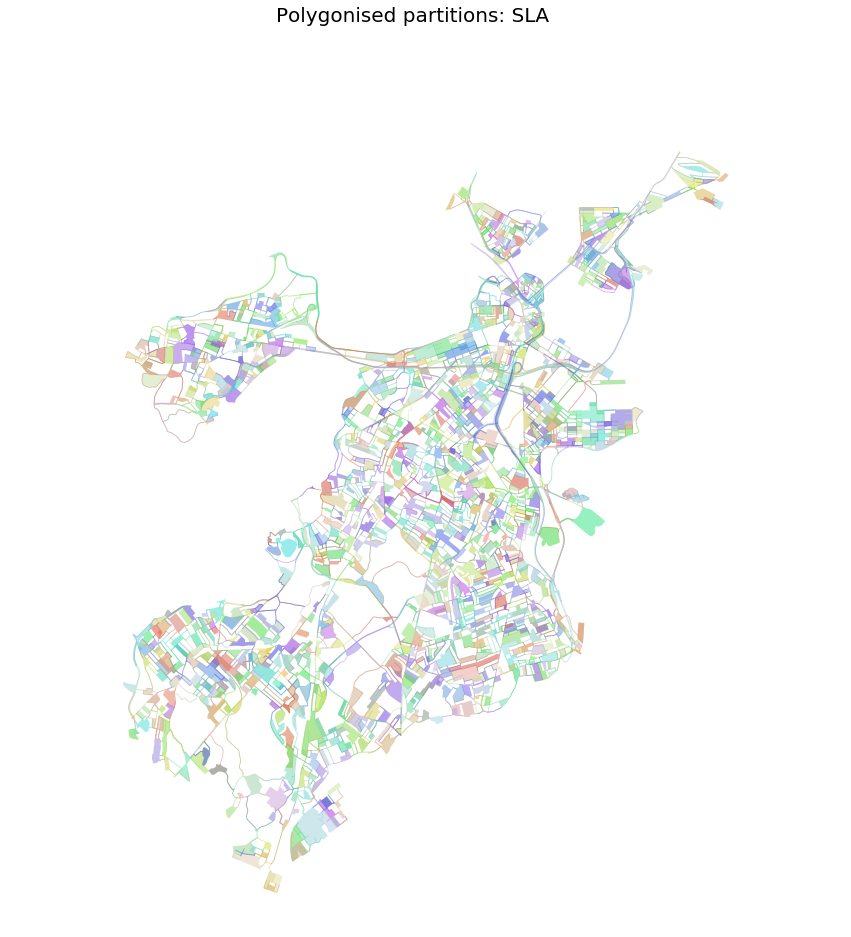

In [87]:
# SLPA
com = algorithms.slpa(dual_graphIG, t=200, r=0.01)
slpa = com.communities
print(len(slpa))
partitions = polygonise_overlapping(slpa, nodesDual_graphIG, edges_graph, None)
cmap = up.rand_cmap(nlabels = len(partitions), type_color='bright', first_color_black=False, 
                 last_color_black=False)
up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions: SLA",  alpha = 0.5,
                 black_background = False,  fig_size = 15)

In [93]:
## ego
com = algorithms.ego_networks(dual_graphIG, level = 2)
# ego = com.communities
print(len(ego))
partitions = polygonise_overlapping(ego, nodesDual_graphIG, edges_graph, None)
cmap = up.rand_cmap(nlabels = len(partitions), type_color='bright', first_color_black=False, 
                 last_color_black=False)
up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions: Ego networks", alpha = 0.35,
                 black_background = False,  fig_size = 15)

12765


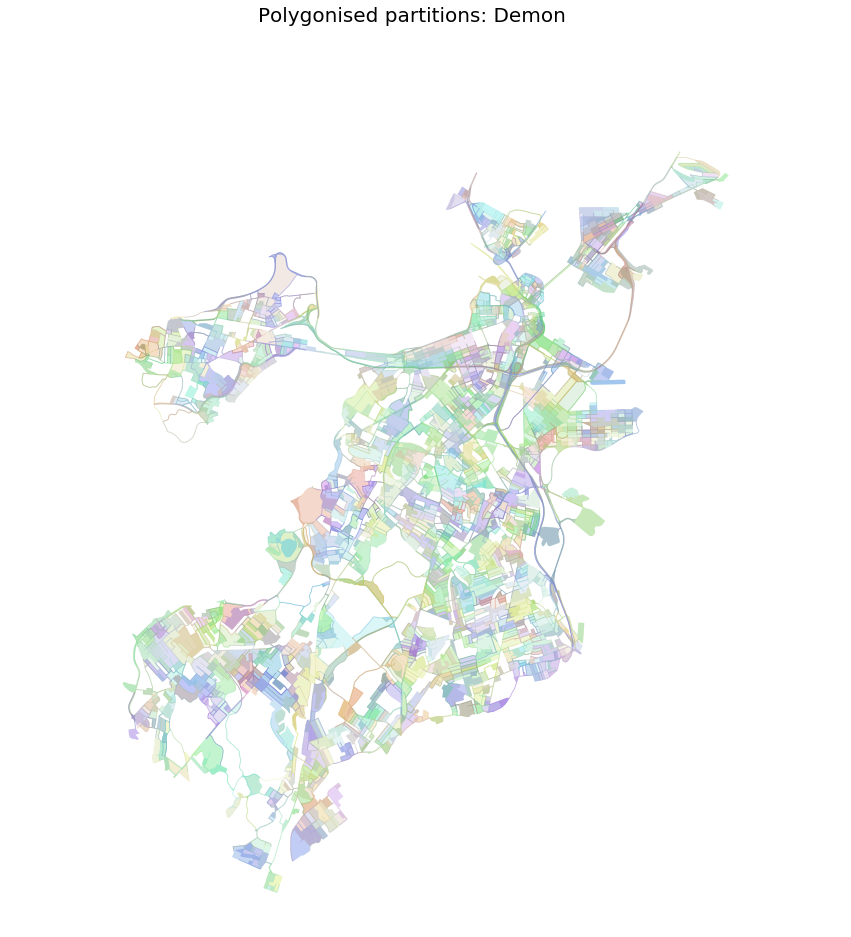

In [30]:
# demon
com = algorithms.demon(dual_graphIG, min_com_size=0, epsilon=0.0)
demon = com.communities

partitions = polygonise_overlapping(demon, nodesDual_graphIG, edges_graph)
cmap = up.rand_cmap(nlabels = len(partitions), type_color='bright', first_color_black=False, 
                 last_color_black=False)
up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions: Demon", alpha = 0.3,
                 black_background = False,  fig_size = 15)

In [104]:
# SLPA
com = algorithms.frc_fgsn(dual_graphIG, theta=1, eps=0.1, r=3)
fuzzy = com.communities
print(len(fuzzy))
partitions = polygonise_overlapping(fuzzy, nodesDual_graphIG, edges_graph, None)
cmap = up.rand_cmap(nlabels = len(partitions), type_color='bright', first_color_black=False, 
                 last_color_black=False)
up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions: SLA",  alpha = 0.5,
                 black_background = False,  fig_size = 15)

KeyboardInterrupt: 

In [92]:
## big clam
# com = algorithms.big_clam(dual_graphIG, iterations=50, learning_rate=0.3)
# big_clam = com.communities
len(big_clam)
# partitions = polygonise_overlapping(big_clam, nodesDual_graphIG, edges_graph)
# cmap = up.rand_cmap(nlabels = len(partitions), type_color='bright', first_color_black=False, 
#                  last_color_black=False)
# up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions: Big Clam", alpha = 0.5,
#                  black_background = False,  fig_size = 15)

1

In [42]:
import matplotlib as mp, pandas as pd, numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as cols
import matplotlib.patches as mpatches

from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.mplot3d.art3d import Line3DCollection
import pylab
from matplotlib.colors import LinearSegmentedColormap
import colorsys

pd.set_option("precision", 10)
def plot_polygons(gdf, column = None, classes = 7, scheme = None, bins = None, color = None, cmap = "Greens_r", alpha = 1.0,
                  title =  "Plot", legend = False, 
                color_bar = False, black_background = True,  fig_size = 15, gdf_base_map = pd.DataFrame({"a" : []}),
                base_map_color = None, base_map_alpha = 0.4, base_map_lw = 1.1, base_map_ms = 2.0):
    """
    It creates a plot from a Polygon GeoDataFrame. 
    When column and scheme are not "None" it plots the distribution over value and geographical space of variable "column using scheme
    "scheme". If only "column" is provided, a categorical map is depicted.
    
    Parameters
    ----------
    gdf: GeoDataFrame
    column: string
        Column on which the plot is based
    classes: int
        classes for visualising when scheme is not "None"
    scheme: dictionary of str {"Equal_Interval", "Fisher_Jenks"..}
        check: https://pysal.readthedocs.io/en/v1.11.0/library/esda/mapclassify.html
    bins: list
        bins defined by the user
    cmap: string,
        see matplotlib colormaps for a list of possible values
    title: str 
        title of the graph
    legend: boolean
        if True, show legend, otherwise don't
    color_bar: boolean
        if True, show color_bar, otherwise don't (only when legend is False)
    black_background: boolean 
        black background or white
    fig_size: float
        size figure extent
    """
    
    # axes setup
    fig, ax = plt.subplots(1, figsize=(fig_size, fig_size))
    plt.axis("equal")
    ax.set_axis_off()
    
    # background black or white - basic settings   
    rect = fig.patch 
    if black_background: 
        text_color = "white"
        rect.set_facecolor("black")
    else: 
        text_color = "black"
        rect.set_facecolor("white")
    font_size = fig_size+5 # font-size   
    fig.suptitle(title, color = text_color, fontsize=font_size)
    
   
    # plain plot
    if (column == None) & (scheme == None): gdf.plot(ax = ax, color = "orange",alpha = alpha)
    # categorigal plot
    elif (column != None) & (scheme == None): 
        if cmap == None: cmap='tab20b'
        gdf.plot(ax = ax, column = column, cmap = cmap, alpha = alpha, categorical = True, legend = legend)       
    # user defined bins
    elif scheme == "User_Defined":
        gdf.plot(ax = ax, column = column, cmap = cmap, alpha = alpha, scheme = scheme, legend = legend, classification_kwds={'bins':bins})
    # Lynch's bins - only for variables from 0 to 1
    elif scheme == "Lynch_Breaks":  
        bins = [0.125, 0.25, 0.5, 0.75, 1.00]
        gdf.plot(ax = ax, column = column, cmap = cmap, alpha = alpha, scheme = scheme, legend = legend, classification_kwds={'bins':bins})
    # other schemes
    elif scheme != None: gdf.plot(ax = ax, column = column, k = classes, cmap = cmap, alpha = alpha,  scheme = scheme, legend = legend)

    # background (e.g. street network)

    if not gdf_base_map.empty: 
        if gdf_base_map.iloc[0].geometry.geom_type == 'LineString':
            if black_background: gdf_base_map.plot(ax = ax, color = base_map_color, linewidth = base_map_lw, alpha = base_map_alpha)
            else: gdf_base_map.plot(ax = ax, color = "black", linewidth = base_map_lw, alpha = base_map_alpha)
        if gdf_base_map.iloc[0].geometry.geom_type == 'Point':
            if black_background: gdf_base_map.plot(ax = ax, color = base_map_color, markersize = base_map_ms, alpha = base_map_alpha)
            else: gdf_base_map.plot(ax = ax, color = "black", markersize = base_map_ms, alpha = base_map_alpha)
        if gdf_base_map.iloc[0].geometry.geom_type == 'Polygon':
            if black_background: gdf_base_map.plot(ax = ax, color = base_map_color, alpha = base_map_alpha)
            else: gdf_base_map.plot(ax = ax, color = base_map_color, alpha = base_map_alpha)
    
    if legend: _generate_legend(ax, black_background)
    if (color_bar) & (not legend): _generate_color_bar(cmap, gdf[column], ax, text_color, font_size)

    plt.show() 

In [ ]:
com = algorithms.congo(dual_graphIG, number_communities=25, height=100)

In [42]:
com = algorithms.demon(dual_graphIG, min_com_size=2, epsilon=0.3)

In [31]:
len(egonet_splitter)

0

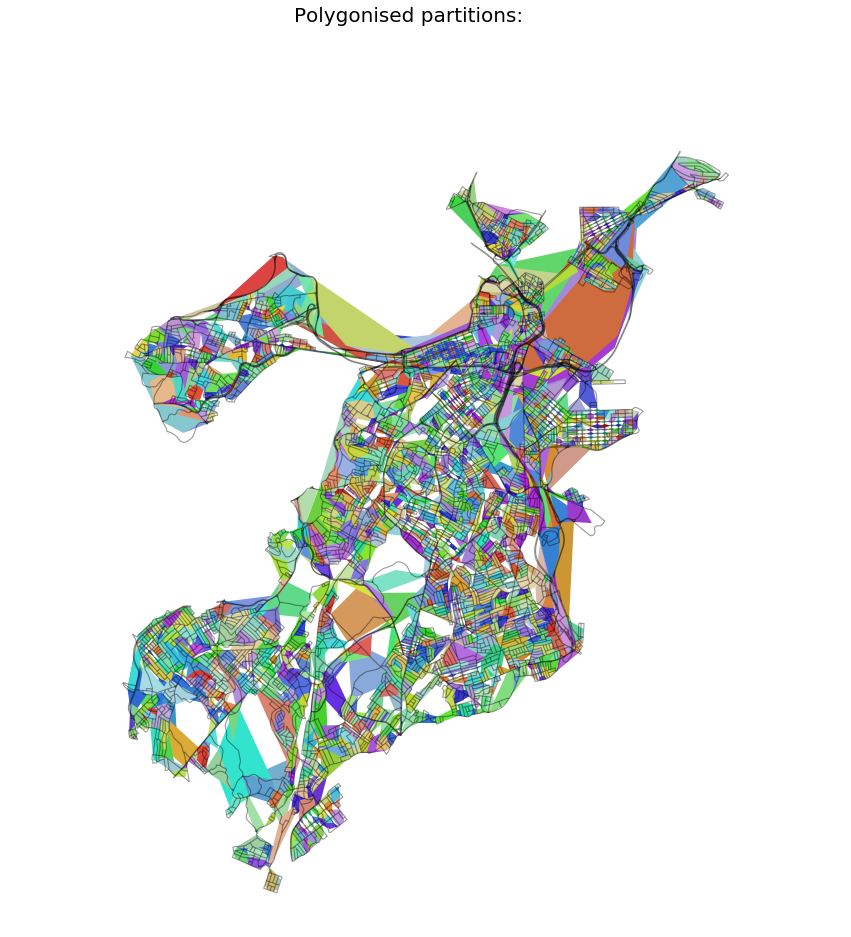

In [43]:
# demon
com = algorithms.demon(dual_graphIG, min_com_size=2, epsilon=0.3)
demon = com.communities

partitions = polygonise_communities(demon, nodesDual_graphIG,crs)
cmap = up.rand_cmap(nlabels = len(partitions), type_color='bright', first_color_black=False, 
                 last_color_black=False)
up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions: ", 
                 black_background = False,  fig_size = 15, gdf_base_map = edges_graph)

In [17]:
lemon

[[4703,
  1718,
  3707,
  1296,
  671,
  249,
  1717,
  12220,
  1298,
  1297,
  11803,
  4273,
  8726,
  1719,
  577,
  10549,
  1720,
  6795,
  15,
  6161,
  10287,
  669,
  10532,
  6538,
  7909,
  2954,
  1295,
  7763,
  6580,
  11654,
  4447]]

In [ ]:
# lfm
com = algorithms.lfm(dual_graphIG, alpha = 1)
lfm = com.communities

partitions = polygonise_communities(multicom, nodesDual_graphIG,crs)
cmap = up.rand_cmap(nlabels = len(partitions), type_color='bright', first_color_black=False, 
                 last_color_black=False)
up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions: ", 
                 black_background = False,  fig_size = 15, gdf_base_map = edges_graph)

In [6]:
fuzzy = algorithms.frc_fgsn(dual_graphIG, theta=1, eps=0.7, r=2)

KeyboardInterrupt: 

In [149]:
nodesDual_graphIG['kclique'] =  [[]] * len(nodesDual_graphIG)
v = nodesDual_graphIG['kclique'].to_list()
len(v)

12765

In [192]:
kclique.communities[0]

[1717, 1718, 1719, 1720, 8726, 3707, 4703]

In [188]:
nodesDual_graphIG['kclique'] = [[]] * len(nodesDual_graphIG)
for community, n in enumerate(kclique.communities):
    tmp = nodesDual_graphIG[nodesDual_graphIG.index.isin(list(n))]
    tmp['kclique'] = tmp.apply(lambda row: append_community(row['kclique'], community), axis = 1)

[] 0
[0]
[] 0
[0]
[] 0
[0]
[] 0
[0]
[] 0
[0]
[] 0
[0]
[] 0
[0]
[] 1
[1]
[] 1
[1]
[] 1
[1]
[] 1
[1]
[] 1
[1]
[] 1
[1]
[] 2
[2]
[] 2
[2]
[] 2
[2]
[] 2
[2]
[] 2
[2]
[] 2
[2]
[] 3
[3]
[] 3
[3]
[] 3
[3]
[] 3
[3]
[] 3
[3]
[] 3
[3]
[] 4
[4]
[] 4
[4]
[] 4
[4]
[] 4
[4]
[] 4
[4]
[] 4
[4]
[] 5
[5]
[] 5
[5]
[] 5
[5]
[] 5
[5]
[] 5
[5]
[] 5
[5]
[] 6
[6]
[] 6
[6]
[] 6
[6]
[] 6
[6]
[] 6
[6]
[] 6
[6]
[] 7
[7]
[] 7
[7]
[] 7
[7]
[] 7
[7]
[] 7
[7]
[] 7
[7]
[] 8
[8]
[] 8
[8]
[] 8
[8]
[] 8
[8]
[] 8
[8]
[] 8
[8]
[] 9
[9]
[] 9
[9]
[] 9
[9]
[] 9
[9]
[] 9
[9]
[] 9
[9]
[] 10
[10]
[] 10
[10]
[] 10
[10]
[] 10
[10]
[] 10
[10]
[] 10
[10]
[] 11
[11]
[] 11
[11]
[] 11
[11]
[] 11
[11]
[] 11
[11]
[] 11
[11]
[] 12
[12]
[] 12
[12]
[] 12
[12]
[] 12
[12]
[] 12
[12]
[] 13
[13]
[] 13
[13]
[] 13
[13]
[] 13
[13]
[] 13
[13]
[] 14
[14]
[] 14
[14]
[] 14
[14]
[] 14
[14]
[] 14
[14]
[] 15
[15]
[] 15
[15]
[] 15
[15]
[] 15
[15]
[] 15
[15]
[] 16
[16]
[] 16
[16]
[] 16
[16]
[] 16
[16]
[] 16
[16]
[] 17
[17]
[] 17
[17]
[] 17
[17]
[] 17
[17]


In [183]:
def append_community(community_list, community):
    print(community_list, community)
    community_list = community_list+[community]
    print(community_list)
    return community_list

In [247]:
node_perception = algorithms.node_perception(dual_graph, threshold=0.55, overlap_threshold=0.25)

In [266]:
big_clam = algorithms.big_clam(dual_graphIG, dimensions=8, iterations=50, learning_rate=0.005)

## Districts identification based on POI

In [72]:
amenities = ['arts_centre', 'atm', 'bank', 'bar', 'bbq', 'bicycle_rental', 'biergarten', 
             'boat_rental', 'boat_sharing', 'brothel', 'bureau_de_change', 'cafe', 'car_rental', 'car_sharing', 'car_wash',
             'casino', 'childcare', 'cinema', 'clinic', 'college', 'community_centre', 'courthouse', 'crematorium', 'dentist',
             'dive_centre', 'doctors', 'driving_school', 'embassy', 'fast_food', 'ferry_terminal', 'fire_station', 'food_court',
             'fuel', 'gambling', 'gym', 'hospital', 'ice_cream', 'internet_cafe', 'kindergarten', 'kitchen', 
             'language_school', 'library', 'marketplace', 'monastery', 'motorcycle_parking', 'music_school', 'nightclub', 
             'nursing_home', 'pharmacy', 'place_of_worship', 'planetarium', 'police', 'post_office', 'prison', 'pub',
             'public_building', 'ranger_station', 'restaurant', 'sauna',  'school', 'social_centre', 'social_facility',
             'stripclub', 'studio', 'swingerclub', 'theatre', 'toilets', 'townhall', 'university', 'veterinary']

In [119]:
amenities = [adult_entertainment, food_bars, shops, service, tourism, business, culture, social, education,
             public, religion, health_care, emergency]
names = ['adult_entertainment', 'food_bars', 'shops', 'service', 'tourism', 'business', 'culture', 'social', 'education', 
         'public', 'religion', 'health_care', 'emergency']
to_keep = list(set(x for l in amenities for x in l))

In [56]:
services = ox.pois.pois_from_place(place).to_crs(epsg=epsg)
services.reset_index(inplace = True, drop = True)
services = services[['geometry', 'amenity']]
for index, row in services.iterrows(): 
    if row['geometry'].geom_type != 'Point':
            services.at[index,'geometry'] = row['geometry'].centroid
    
services["x"], services["y"] = list(zip(*[(r.coords[0][0], r.coords[0][1]) for r in services.geometry]))
services = services[services.within(edges_graph.unary_union.convex_hull)]

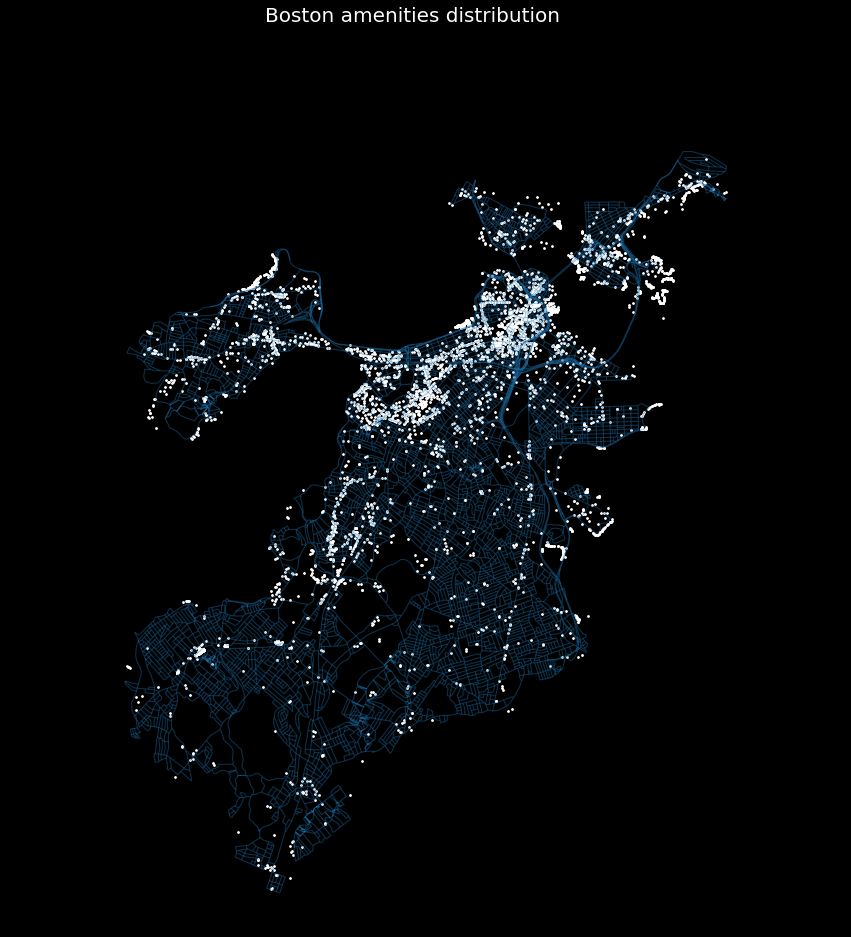

In [57]:
up.plot_points(services, gdf_base_map = edges_graph, ms = 3, title = city_name+' amenities distribution')

In [120]:
nodes_graph_POI = nodes_graph.copy()
for n,i in enumerate(amenities):
    nodes_graph_POI = weight_nodes(nodes_graph_POI, services, i, names[n])

In [101]:
def weight_nodes(nodes_gdf, service_points_gdf, list_amenities, field, radius = 50):
    """
    Given a nodes- and a services/points-geodataframes, the function assigns an attribute to nodes in the graph G (prevously derived from 
    nodes_gdf) based indeed on the amount of features in the services_gdf in a buffer around each node. 
    
    Parameters
    ----------
    nodes_gdf: Point GeoDataFrame
    service_points_gdf: Point GeoDataFrame
    G: networkx multigraph
    name: string, attribute name
    radius: float, distance around the node within looking for point features (services)
    
    Returns
    -------
    networkx multidigraph
    """
    nodes_gdf[field] = None
    tmp = service_points_gdf[service_points_gdf['amenity']].copy()
    sindex = tmp.sindex
    
    nodes_gdf[field] = nodes_gdf.apply(lambda row: _count_services_around_node(row["geometry"], tmp, sindex, radius = radius), axis=1)
    
    return nodes_gdf

def _count_services_around_node(node_geometry, service_points_gdf, service_points_gdf_sindex, radius):
    """
    The functions supports the weight_nodes function.
    
    Parameters
    ----------
    node_geometry: Point geometry
    service_points_gdf: Point GeoDataFrame
    service_points_gdf_sindex = Rtree Spatial Index
    radius: float, distance around the node within looking for point features (services)
    
    Returns
    -------
    Integer value
    """

    buffer = node_geometry.buffer(radius)
    possible_matches_index = list(service_points_gdf_sindex.intersection(buffer.bounds))
    possible_matches = service_points_gdf.iloc[possible_matches_index]
    precise_matches = possible_matches[possible_matches.intersects(buffer)]
    weight = len(precise_matches)
        
    return weight

## Poi Clustering

### Hierarchical dbscan

In [ ]:
def polygonise_clusters(points_gdf, partition_field, crs):
    polygons = []
    partitionIDs = []
    d = {'geometry' : polygons, 'partitionID' : partitionIDs}

    partitions = points_gdf[partition_field].unique()
    for i in partitions:
        polygon =  points_gdf[points_gdf[partition_field] == i].geometry.unary_union.convex_hull
        polygons.append(polygon)
        partitionIDs.append(i)

    df = pd.DataFrame(d)
    partitions_polygonised = gpd.GeoDataFrame(df, crs=crs, geometry=df['geometry'])
    return partitions_polygonised

In [8]:
from sklearn.cluster import DBSCAN
from sklearn import metrics

import hdbscan

outliers1025


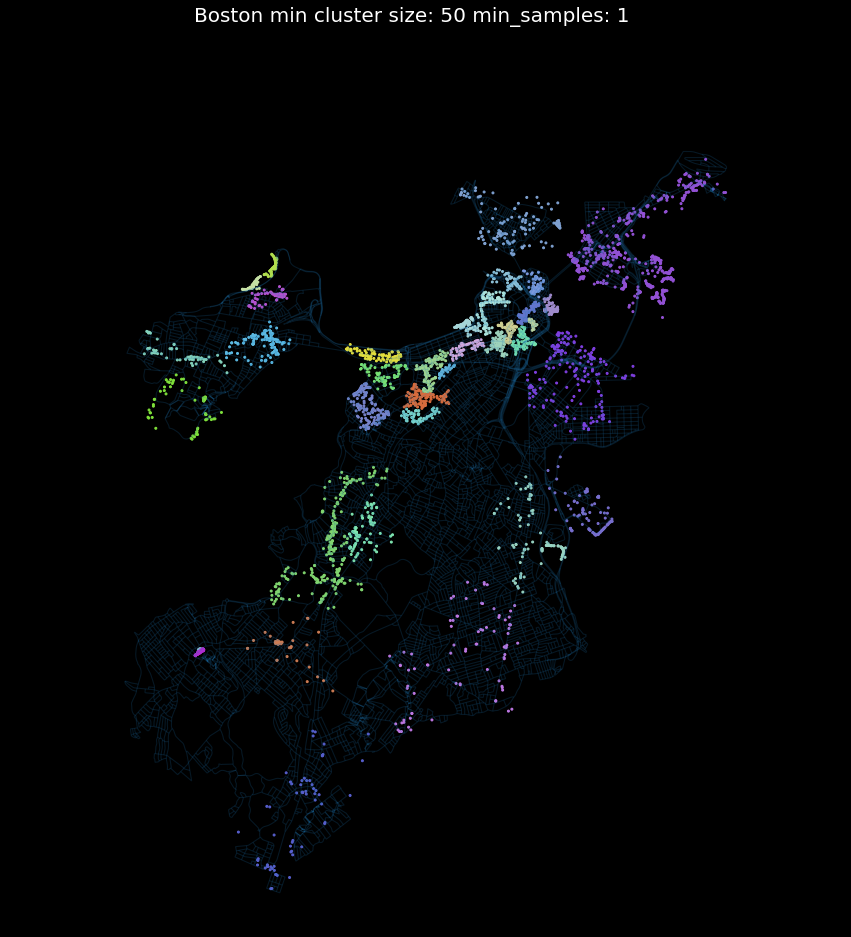

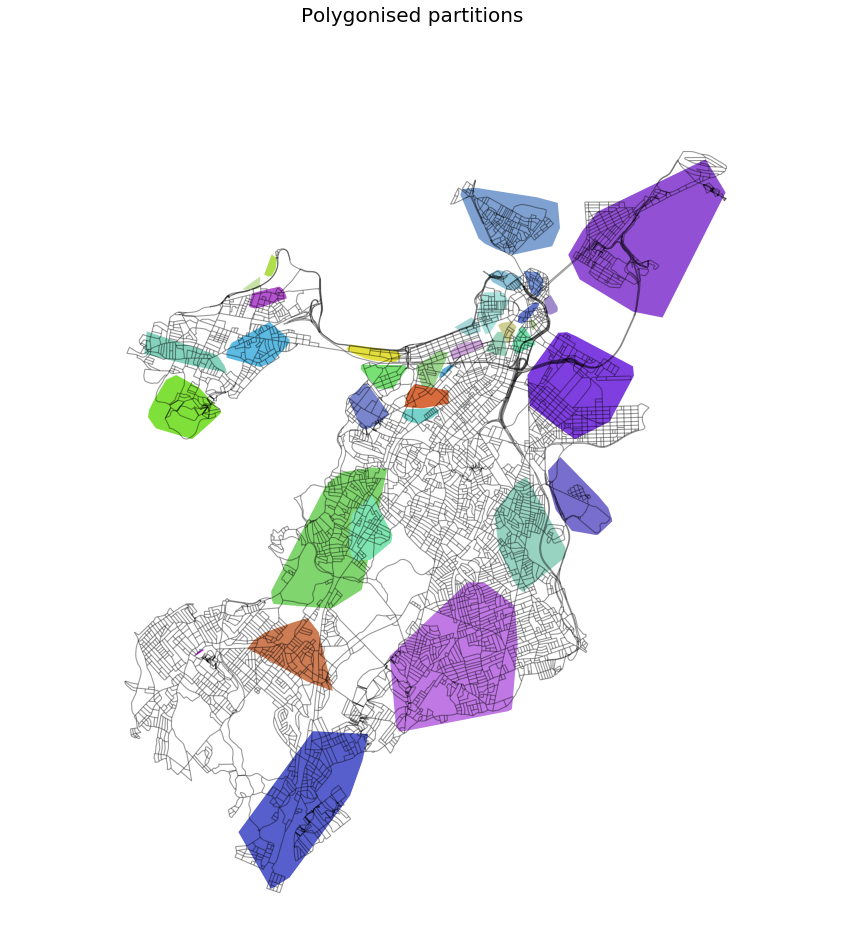

outliers434


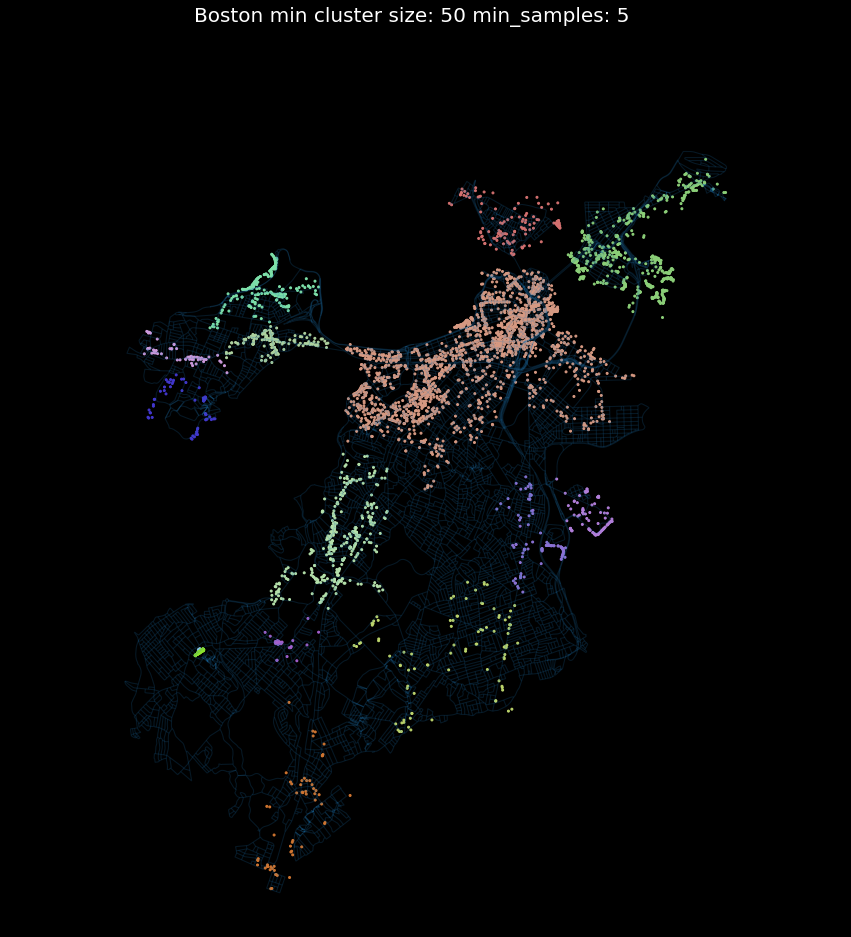

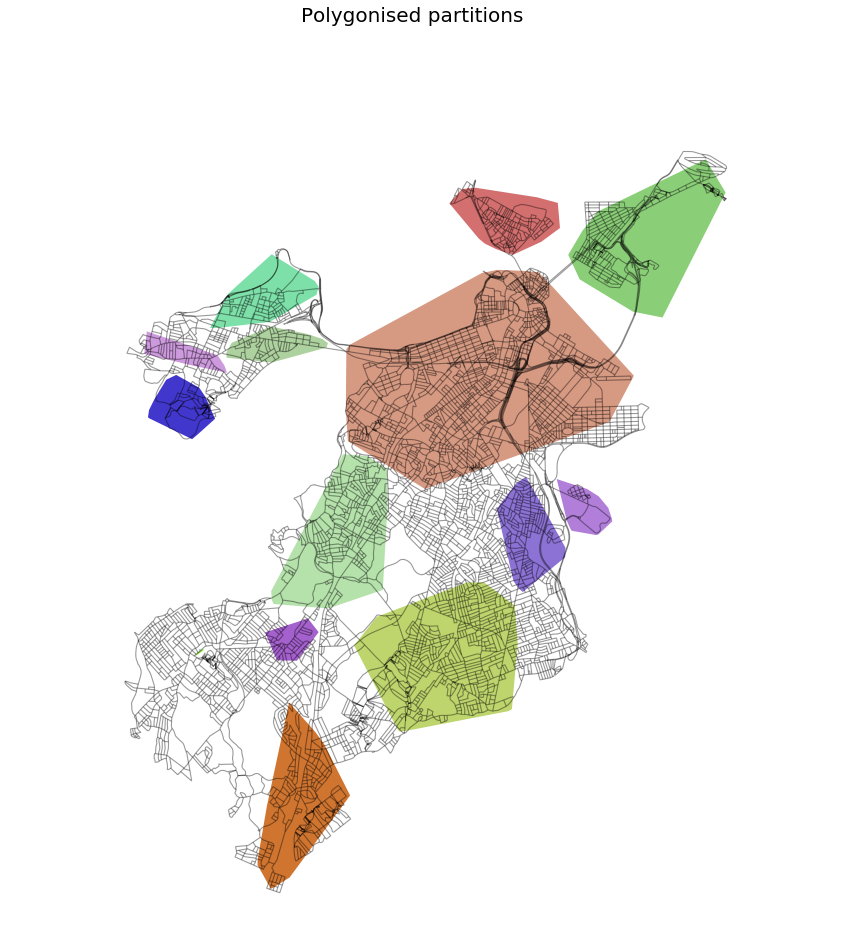

outliers761


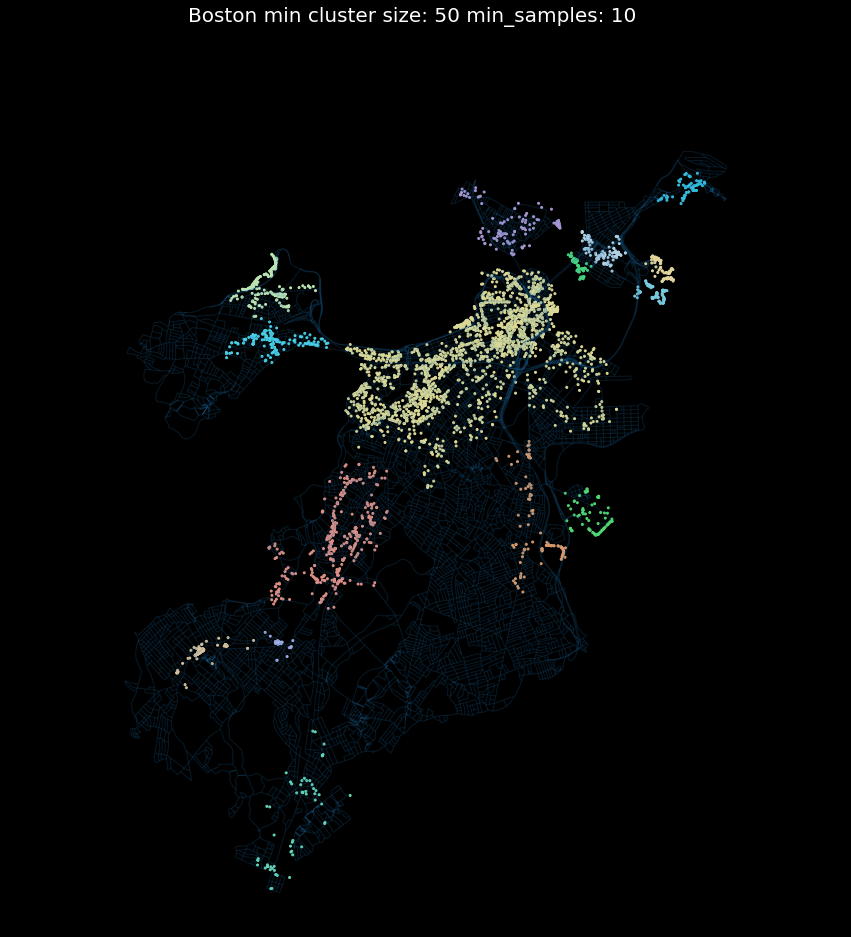

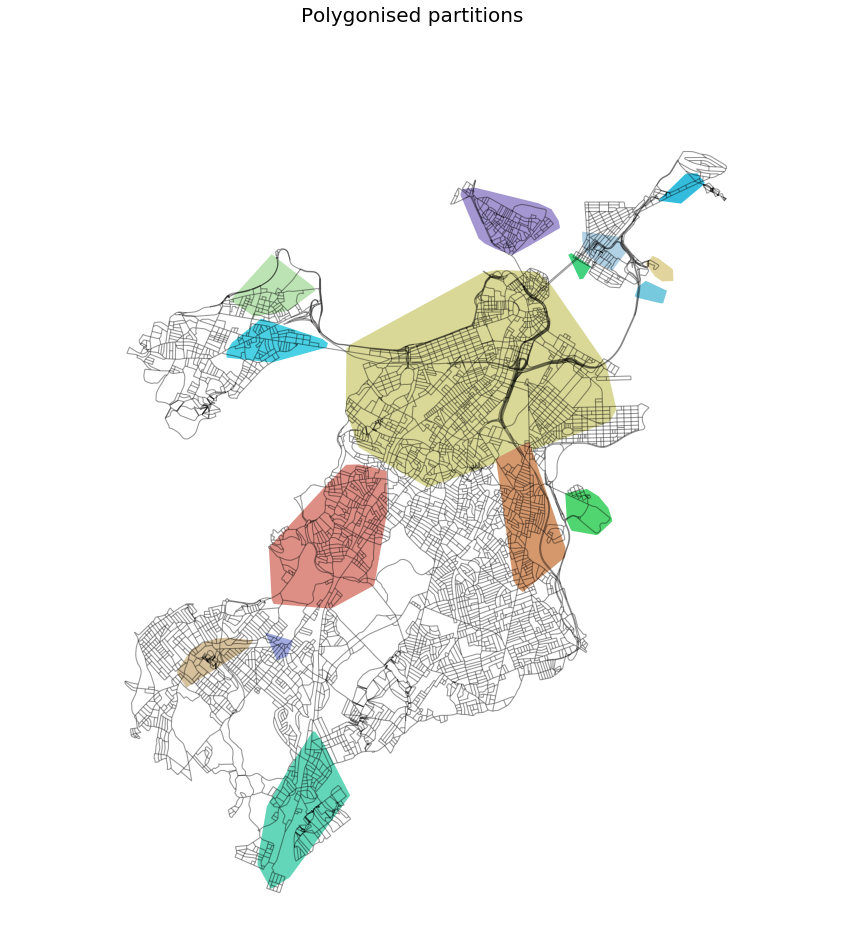

outliers663


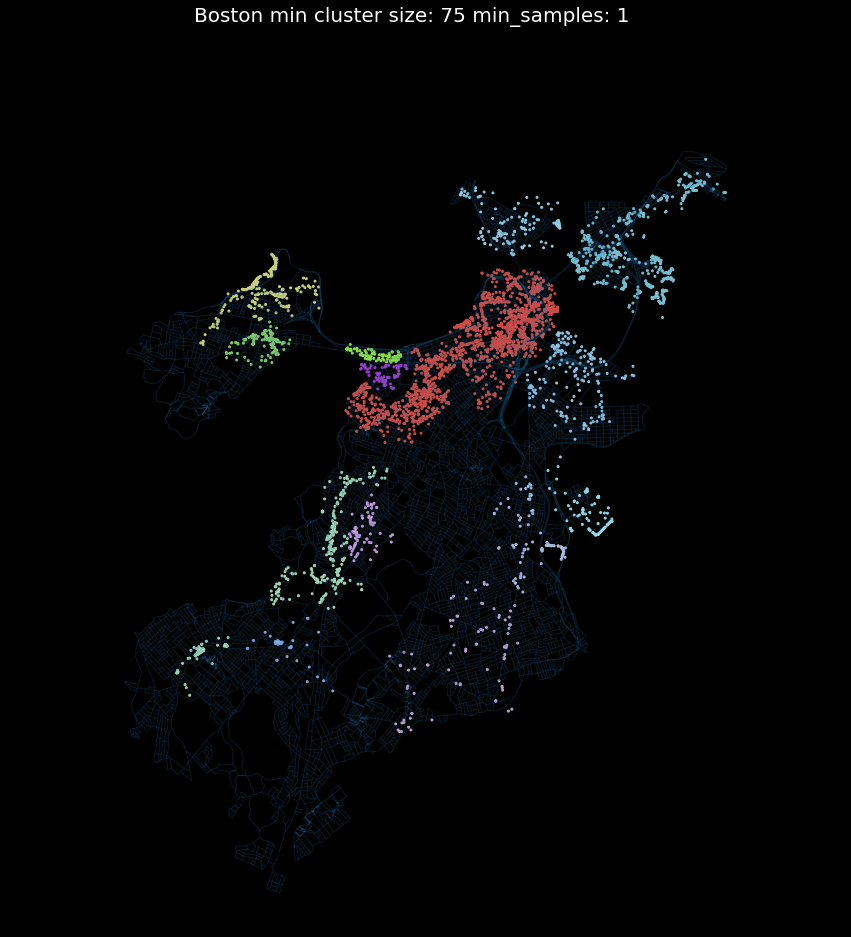

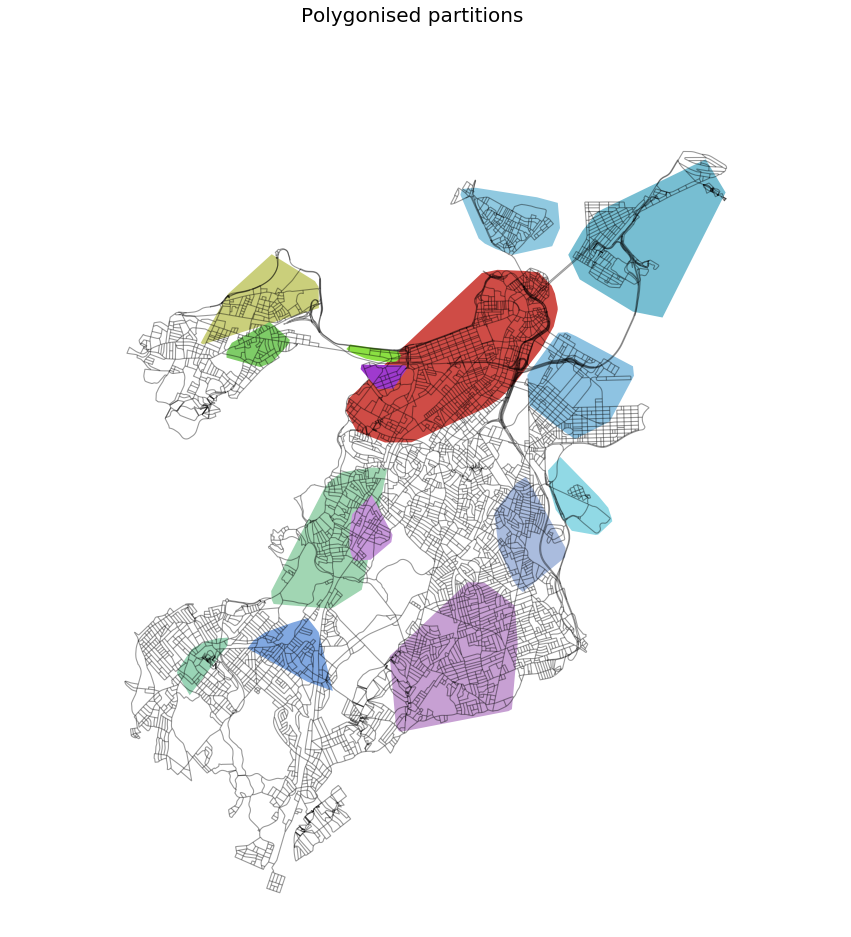

outliers925


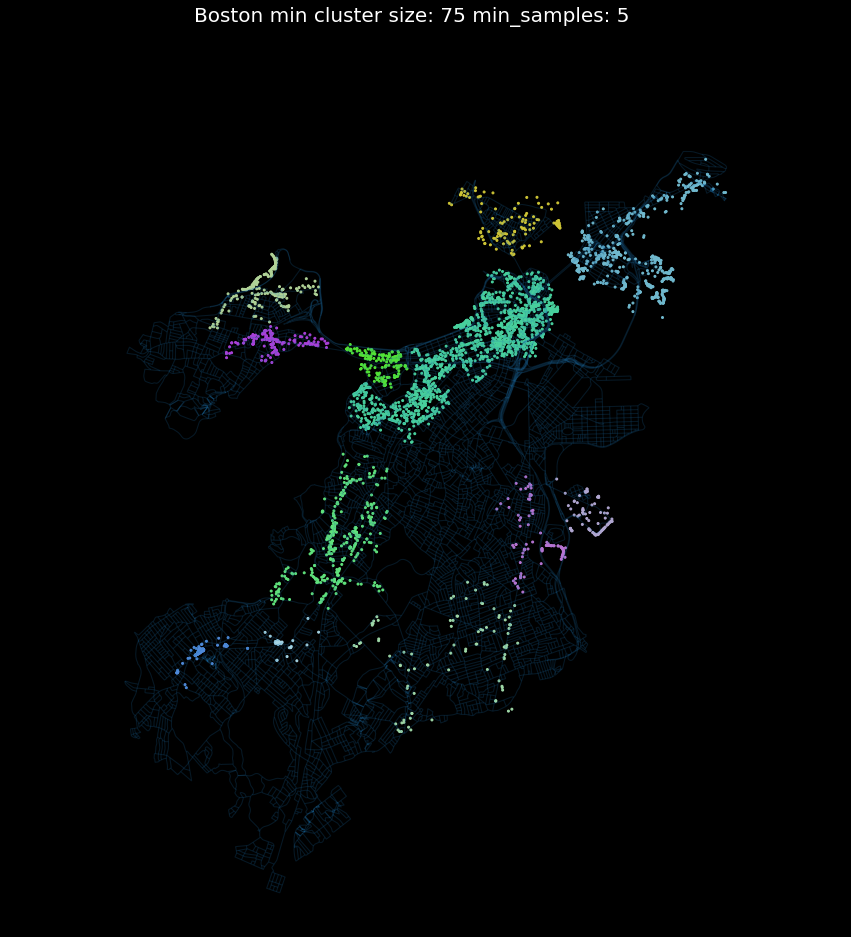

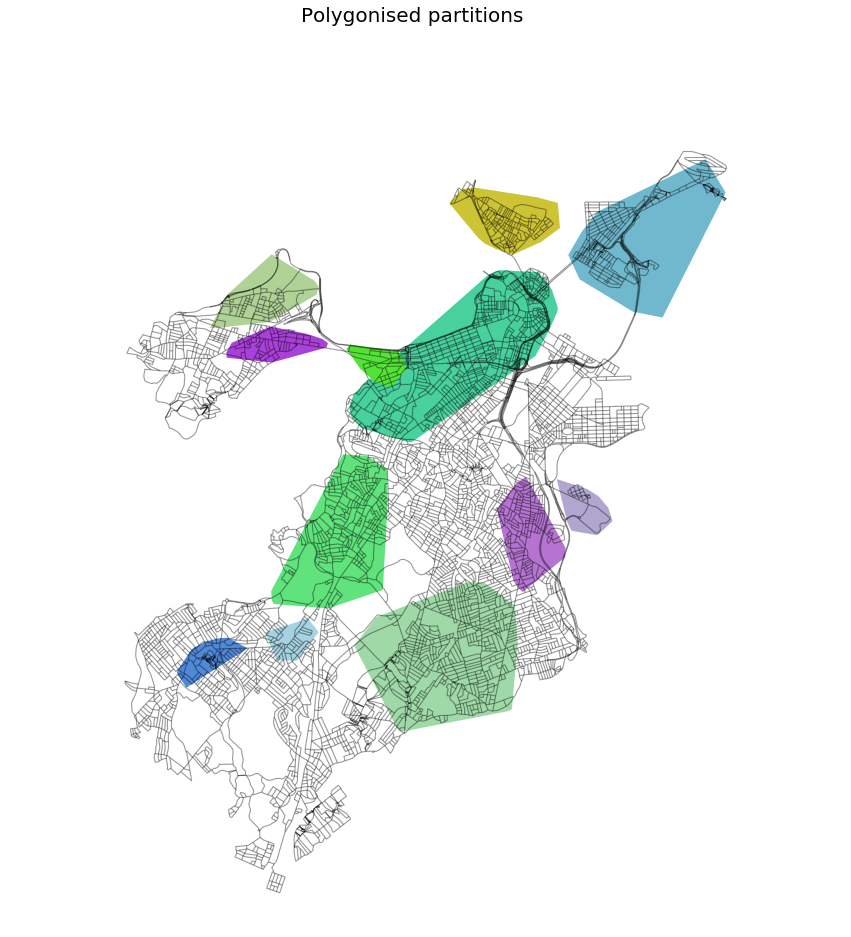

outliers706


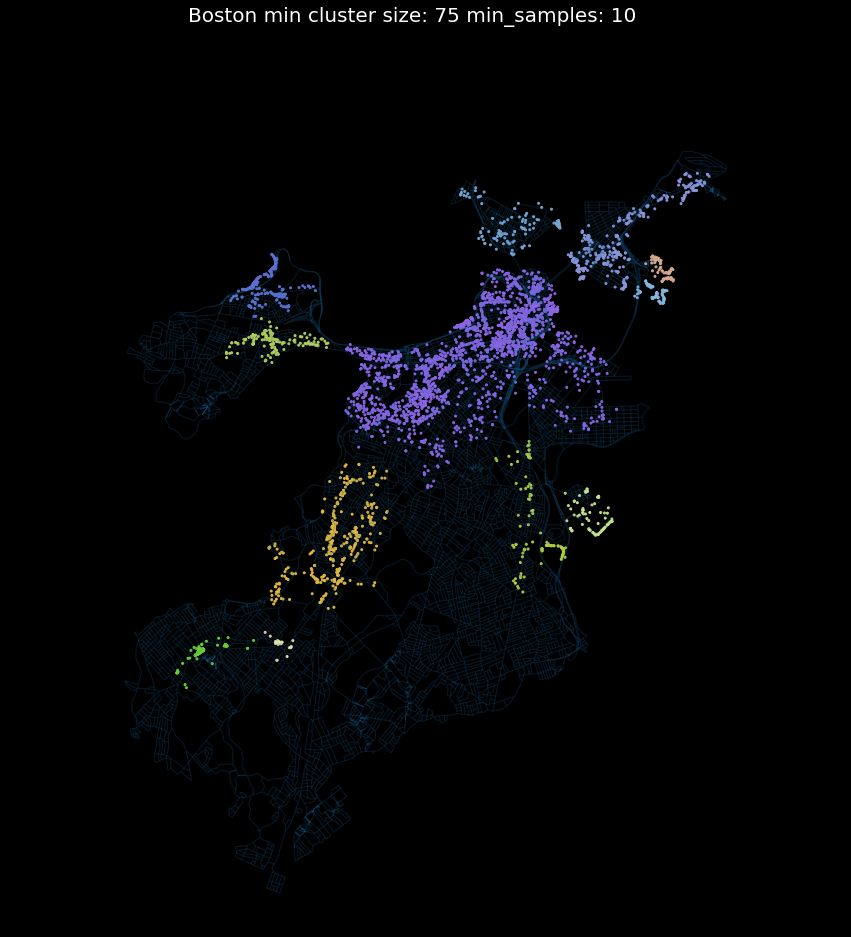

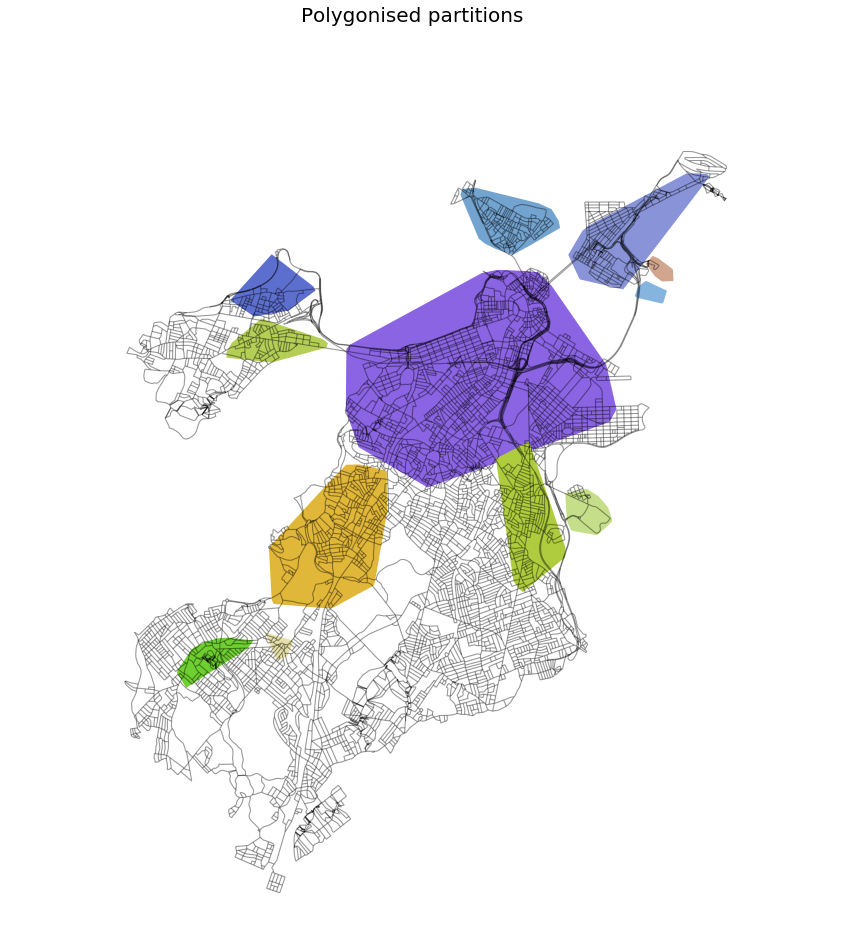

outliers740


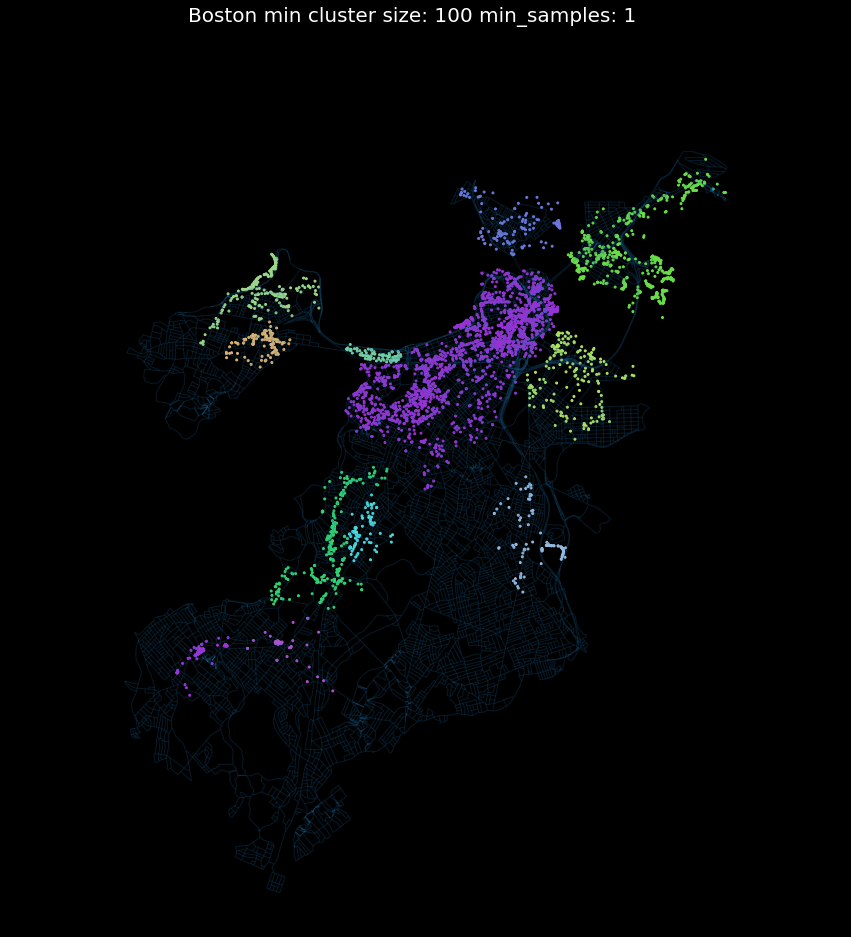

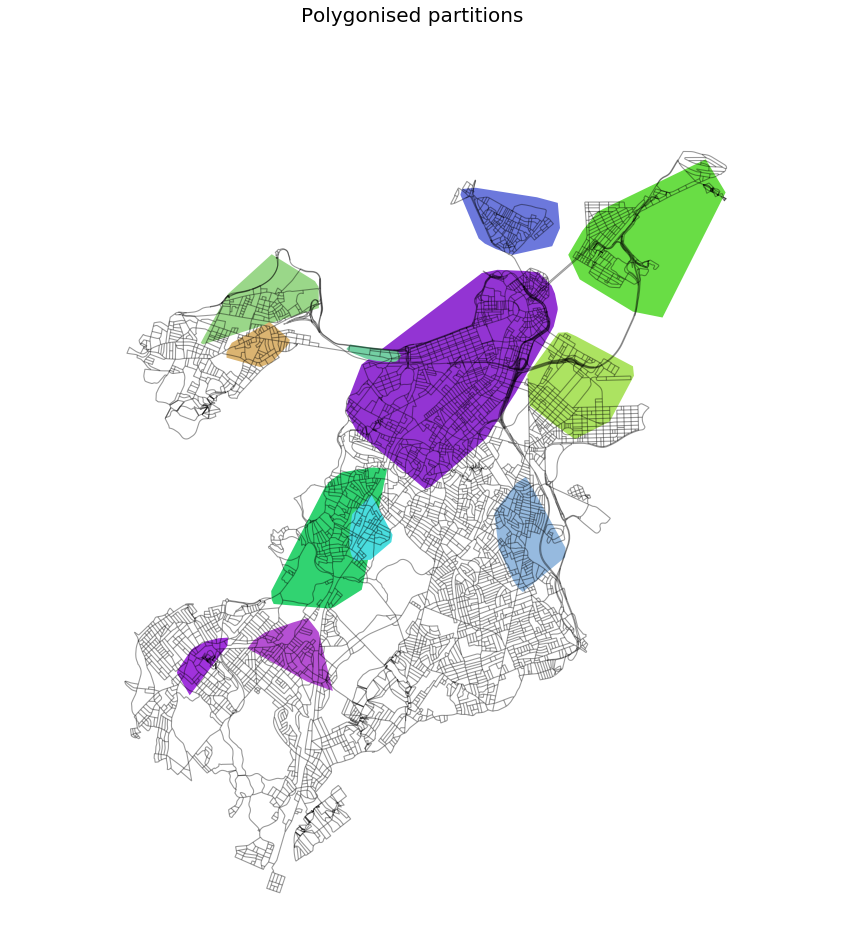

outliers1113


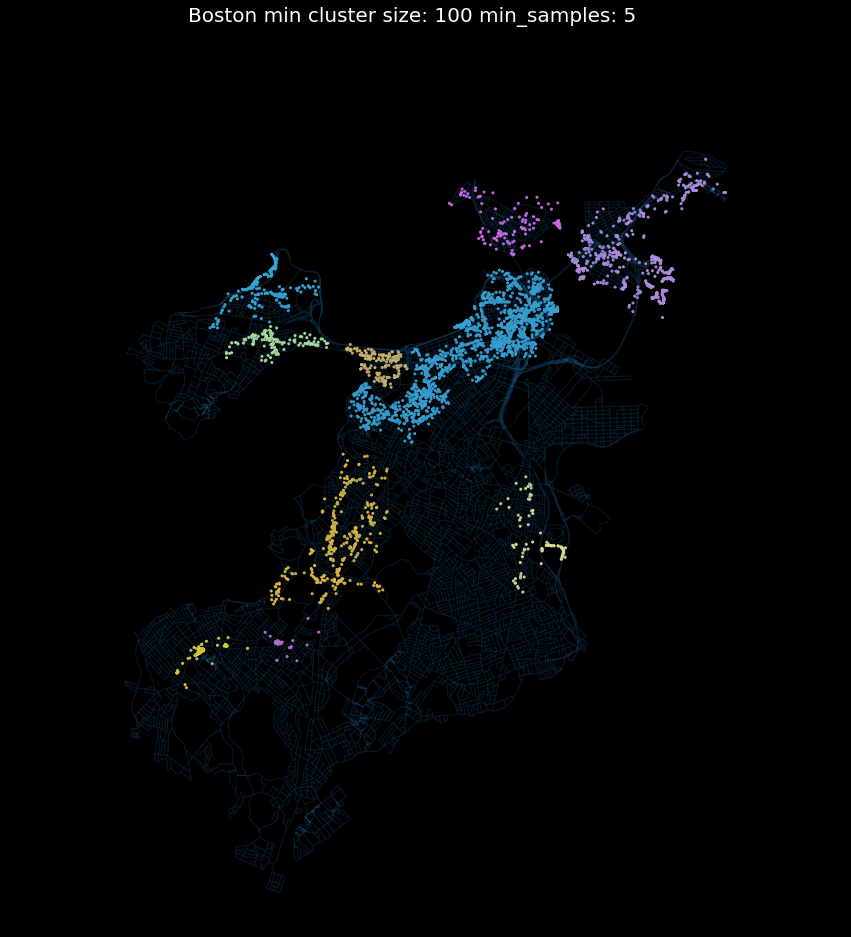

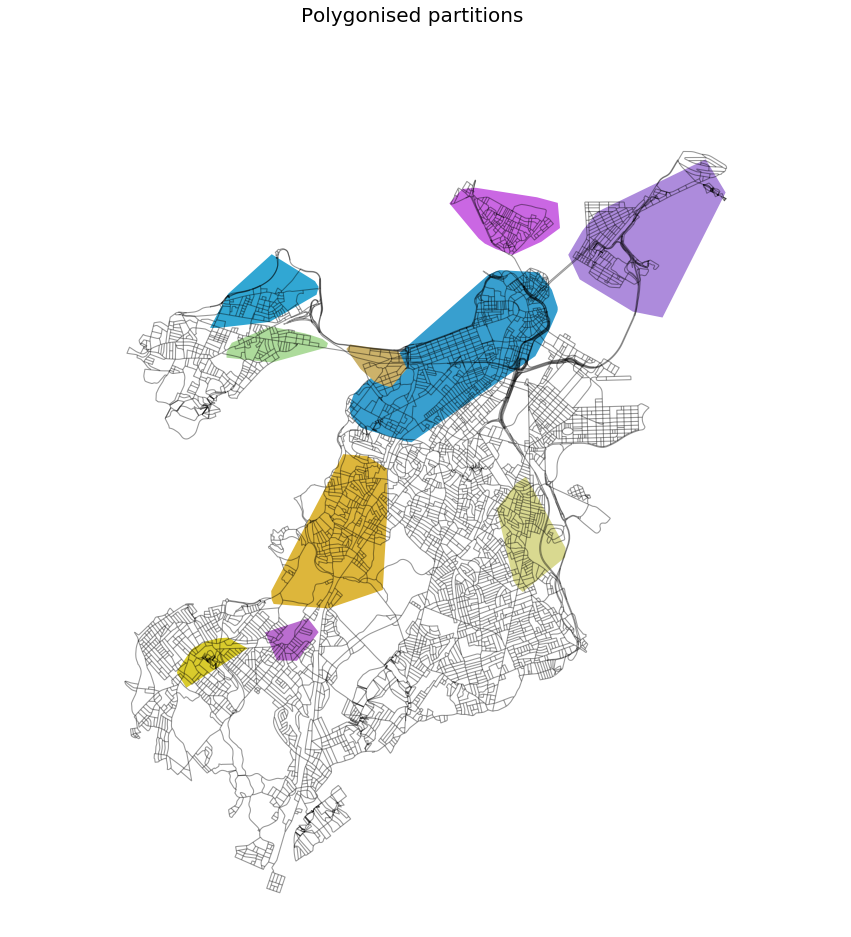

outliers683


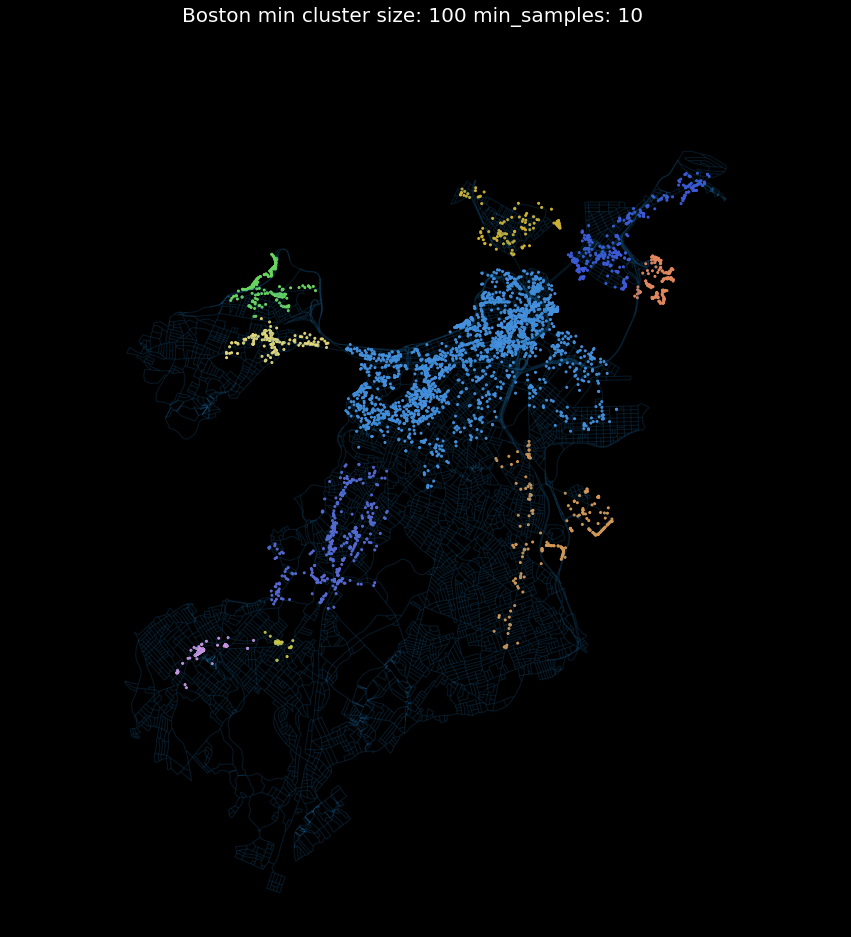

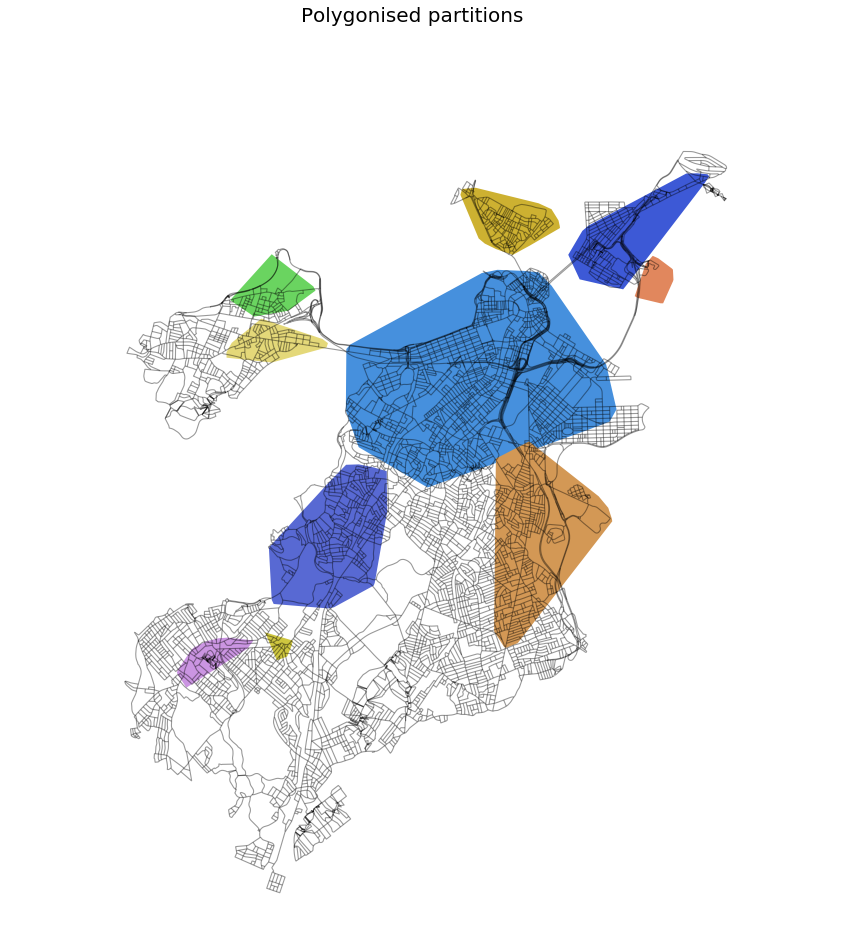

outliers782


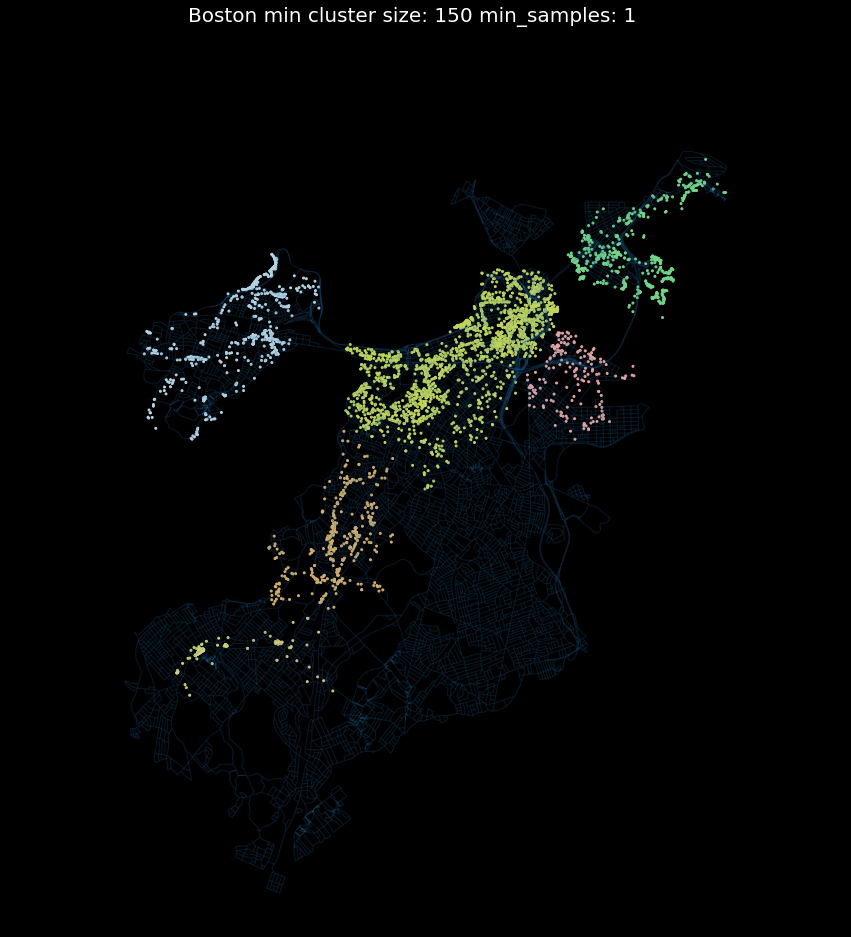

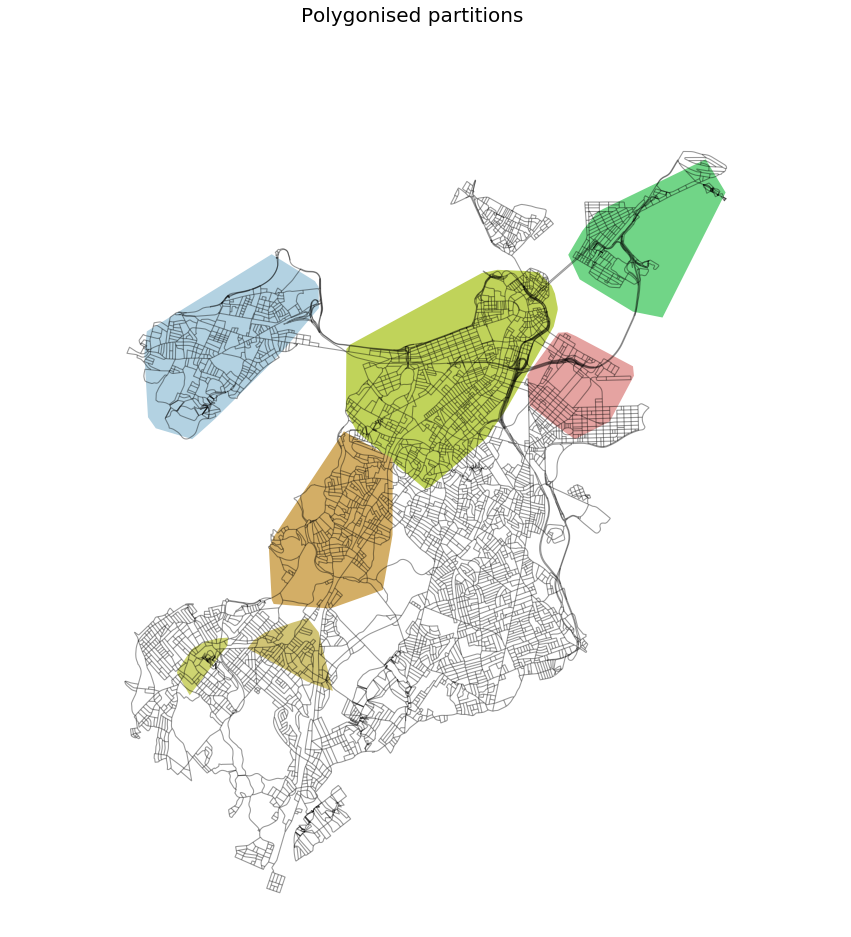

outliers1178


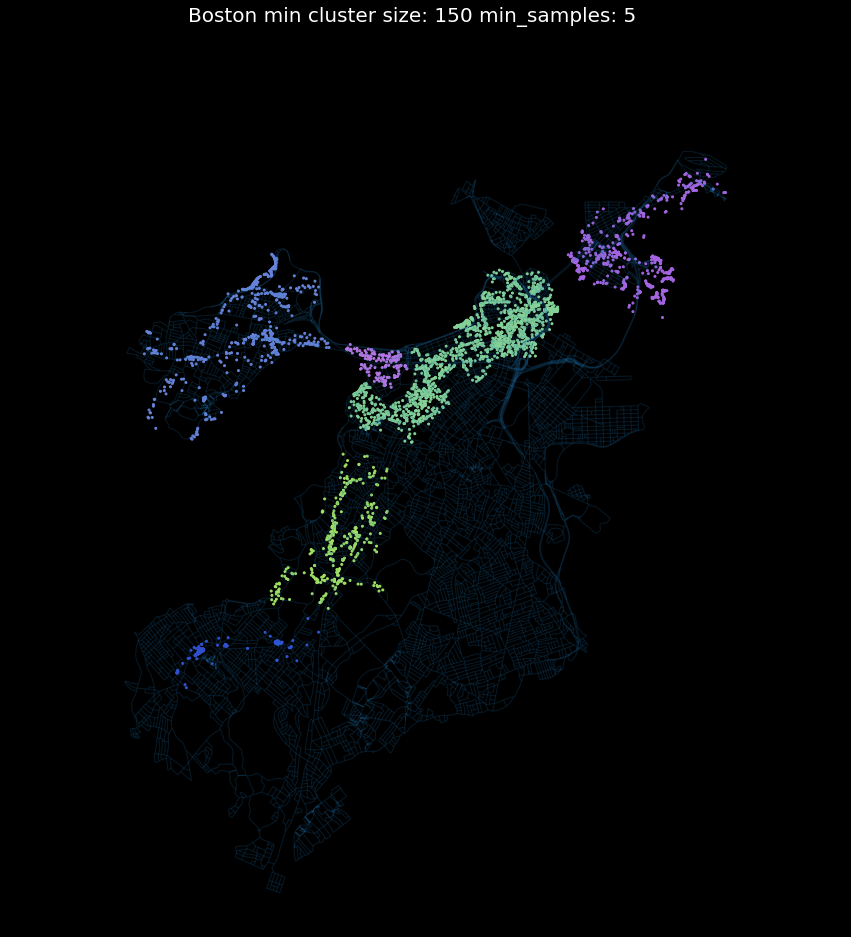

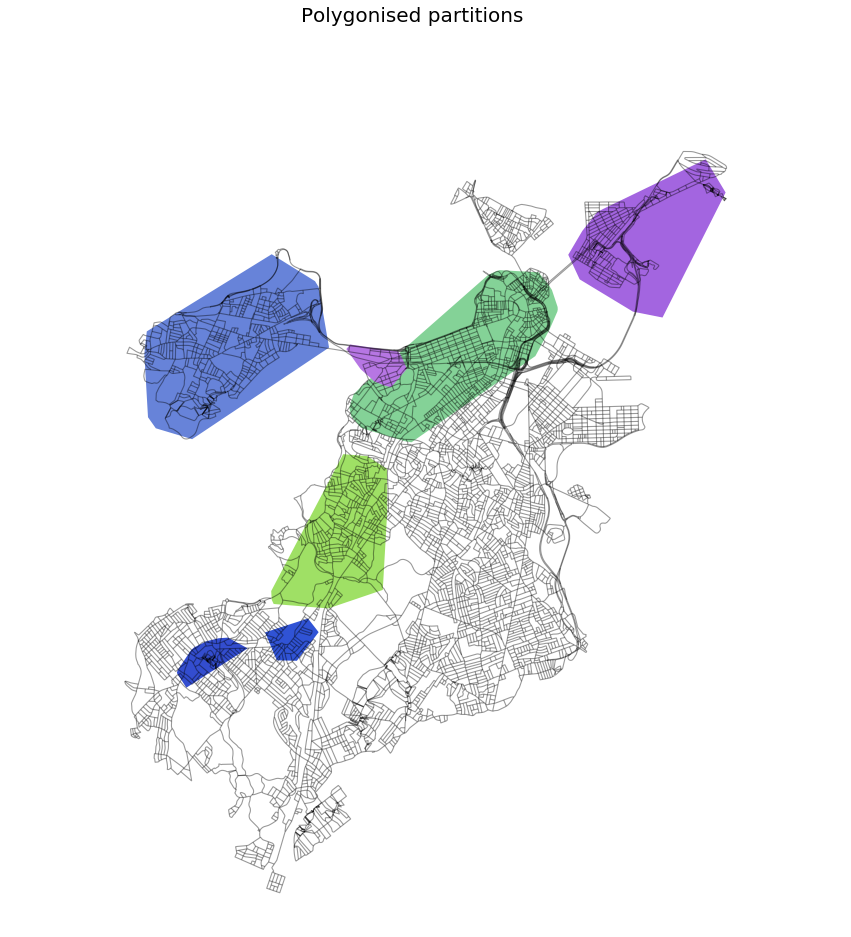

outliers776


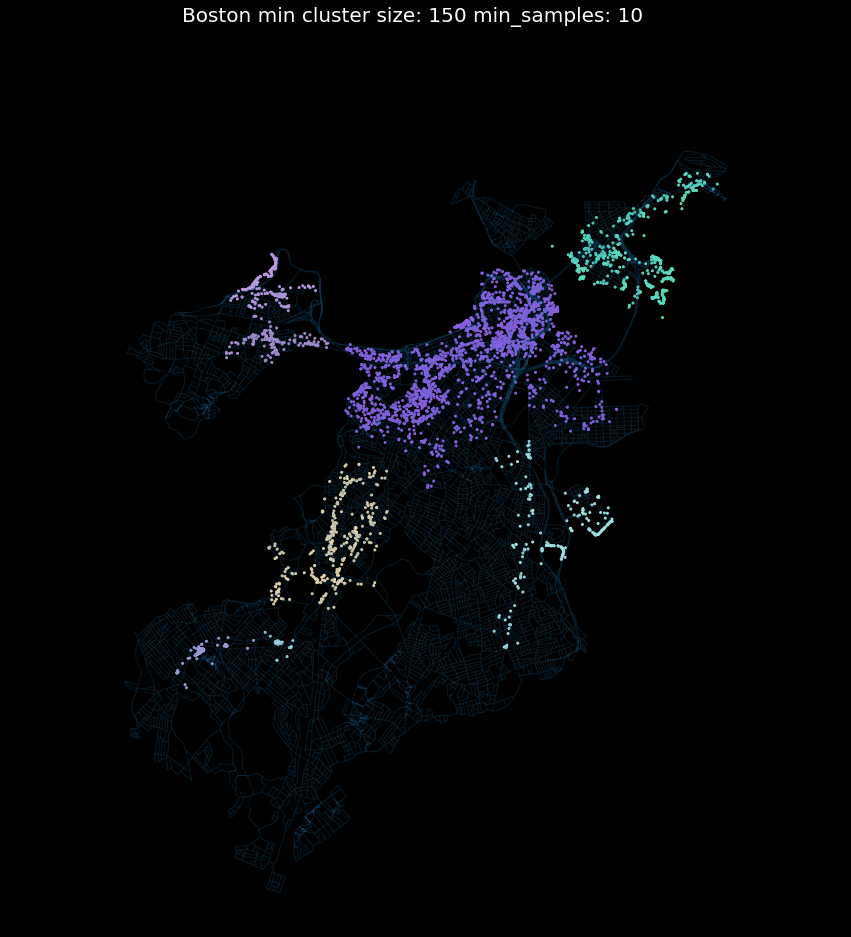

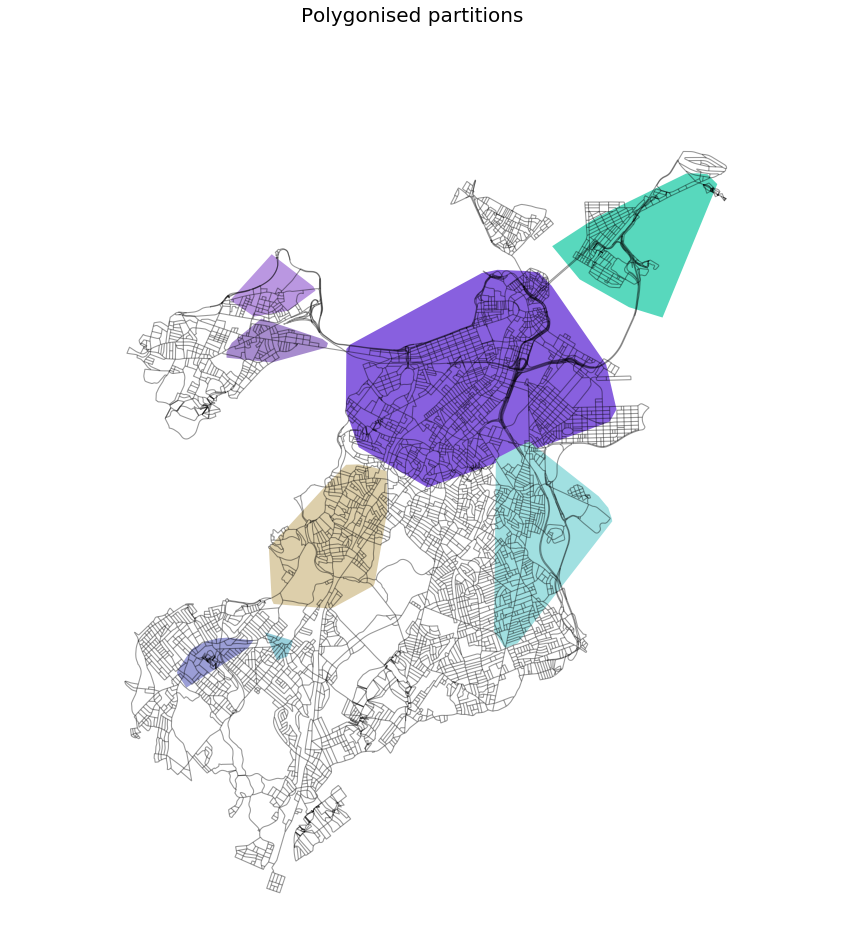

outliers851


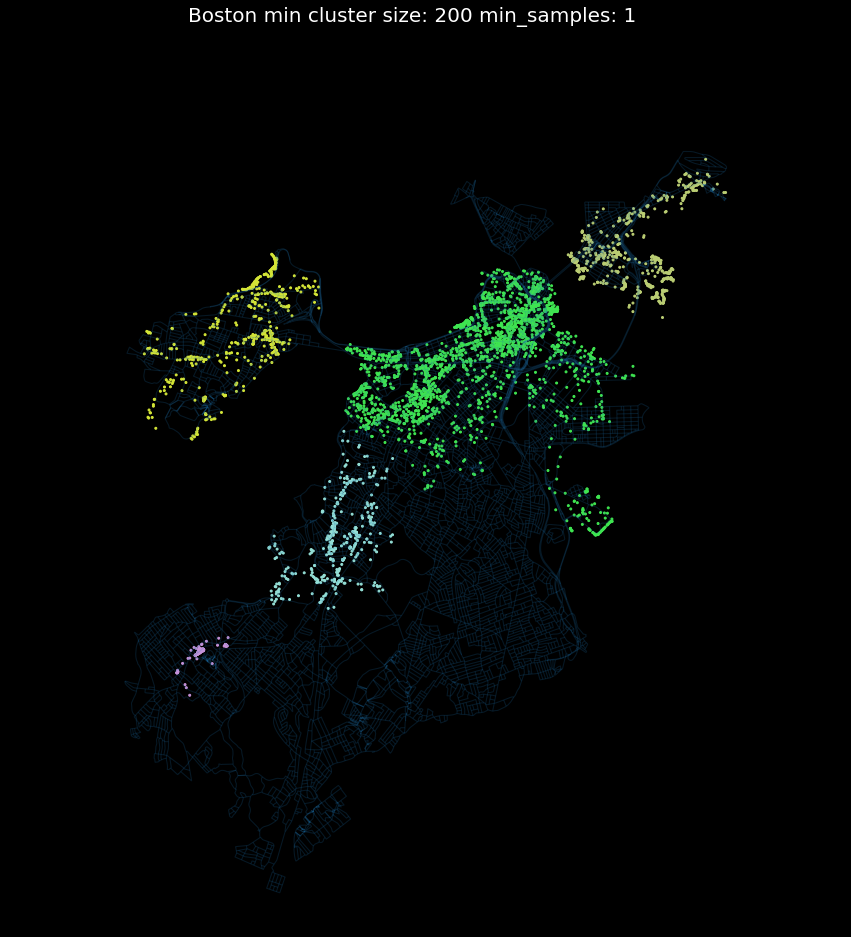

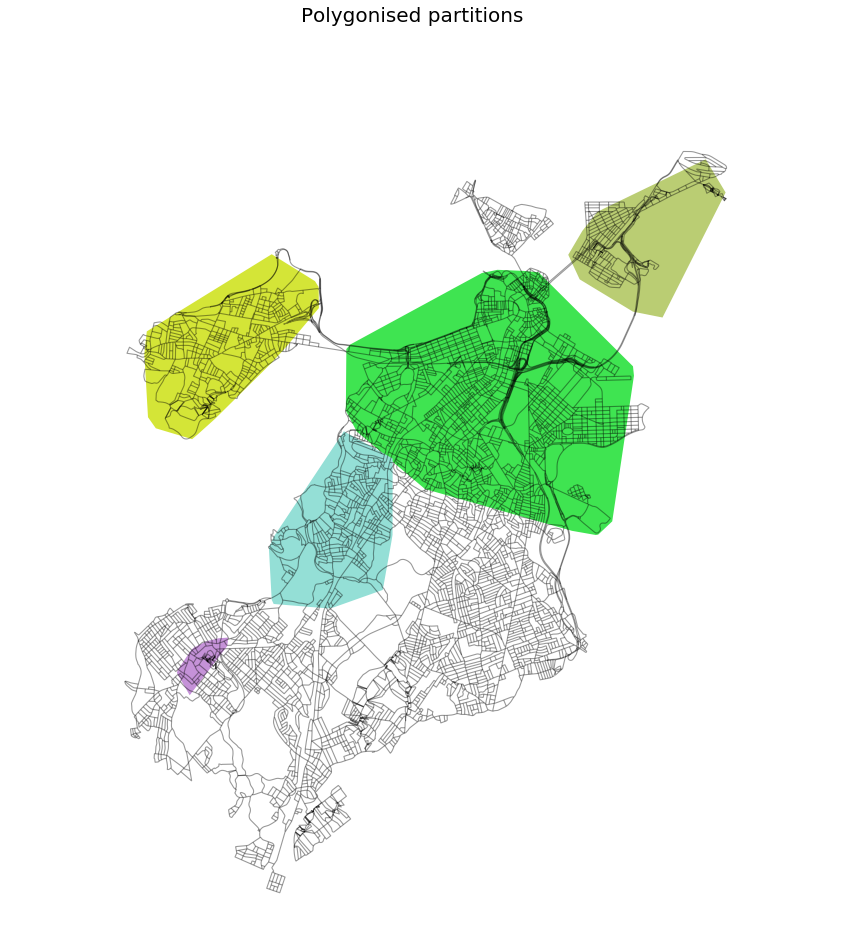

outliers970


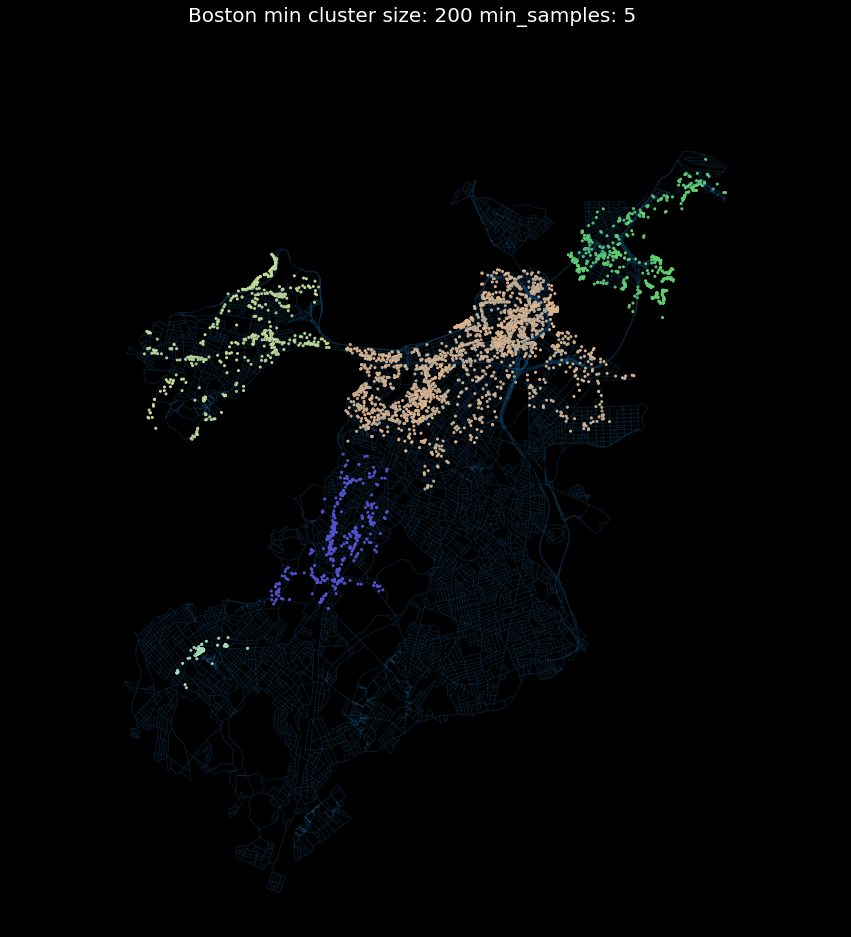

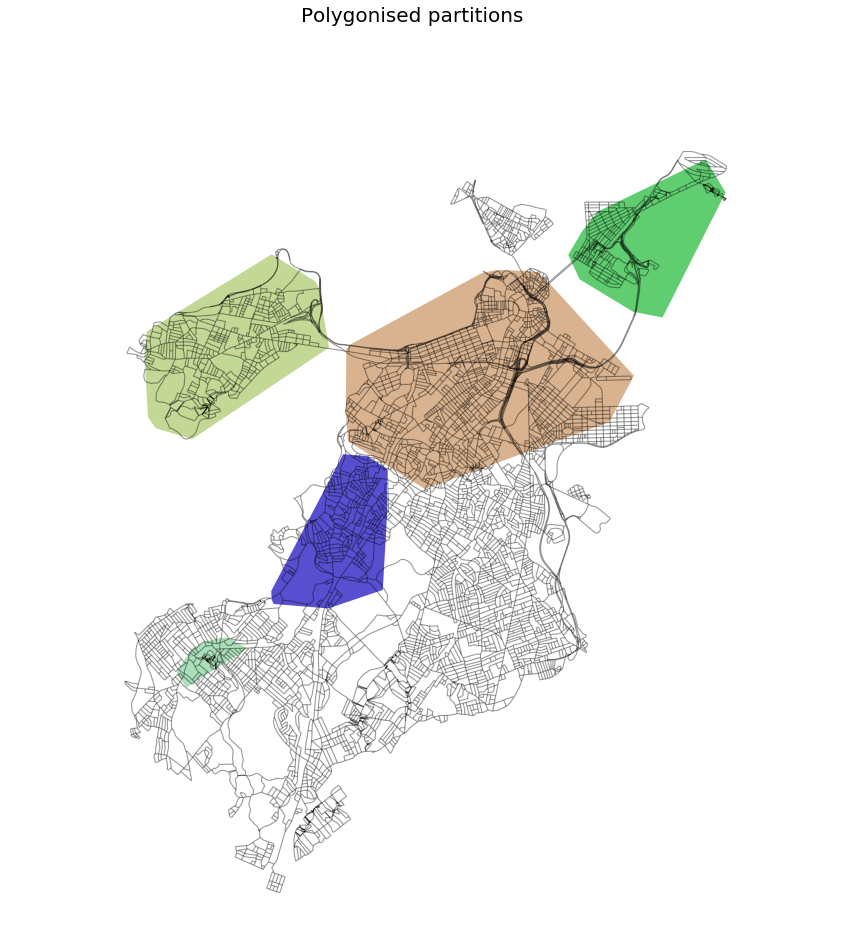

outliers597


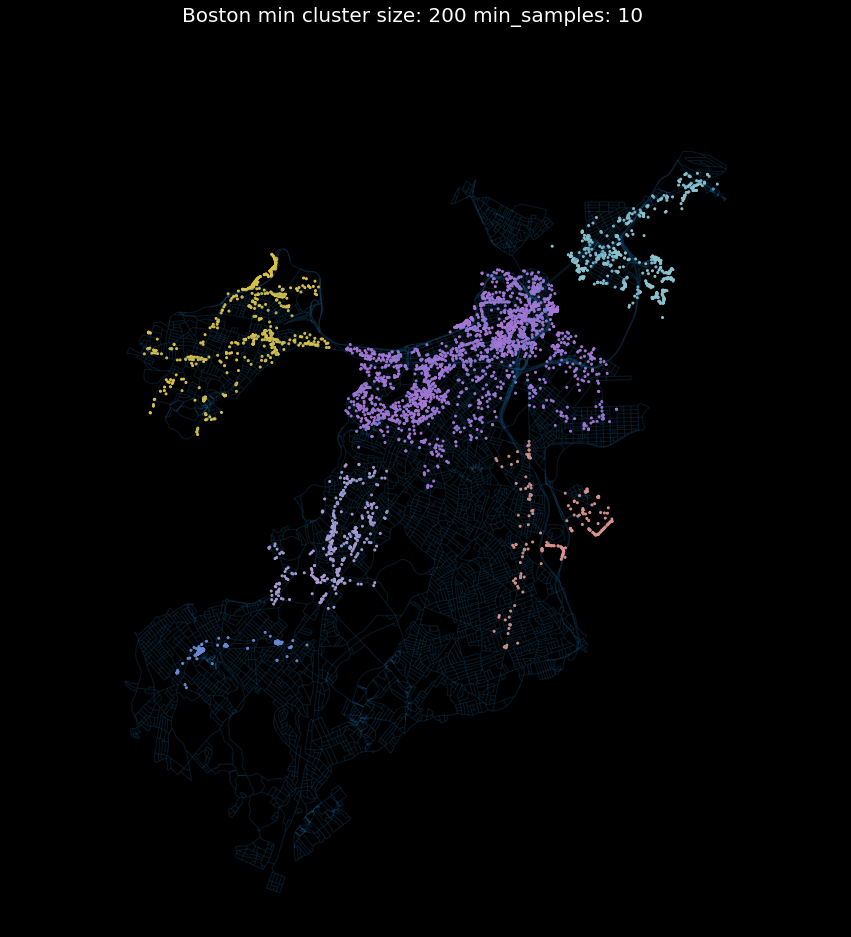

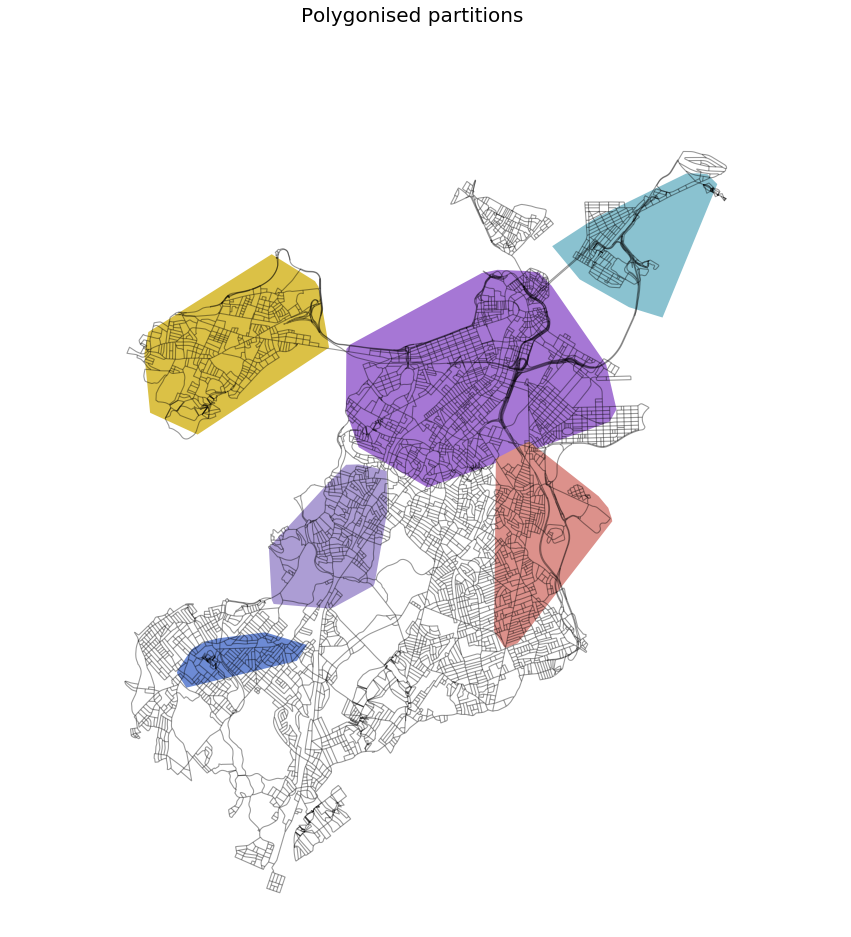

In [59]:
cs = [50, 75, 100, 150, 200]
ms = [1,5,10]

for s in cs:
    for m in ms:
        clusterer = hdbscan.HDBSCAN(min_cluster_size=s, min_samples = m).fit(services[['x','y']])
        hdbscan2_labels = clusterer.labels_
        services['cluster']= hdbscan2_labels
        print("outliers"+ str(len(services[services.cluster == -1])))
        cmap = up.rand_cmap(nlabels = len(services['cluster'].unique()), type_color='bright', first_color_black=False, 
                         last_color_black=False)
        up.plot_points(services[services.cluster != -1], gdf_base_map = edges_graph,  
                       title = city_name+' min cluster size: '+str(s)+' min_samples: '+str(m),
                       ms = 4, column = 'cluster', cmap = cmap, base_map_alpha = 0.2,)
        
        partitions = polygonise_clusters(services[services.cluster != -1], 'cluster', crs)
        up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions", 
                     black_background = False,  fig_size = 15, gdf_base_map = edges_graph)

### Agglomerative Clustering

In [129]:
sklearn.cluster.AgglomerativeClustering(n_clusters=2, affinity='euclidean', 
                                        compute_full_tree='auto', linkage='ward', distance_threshold=None)

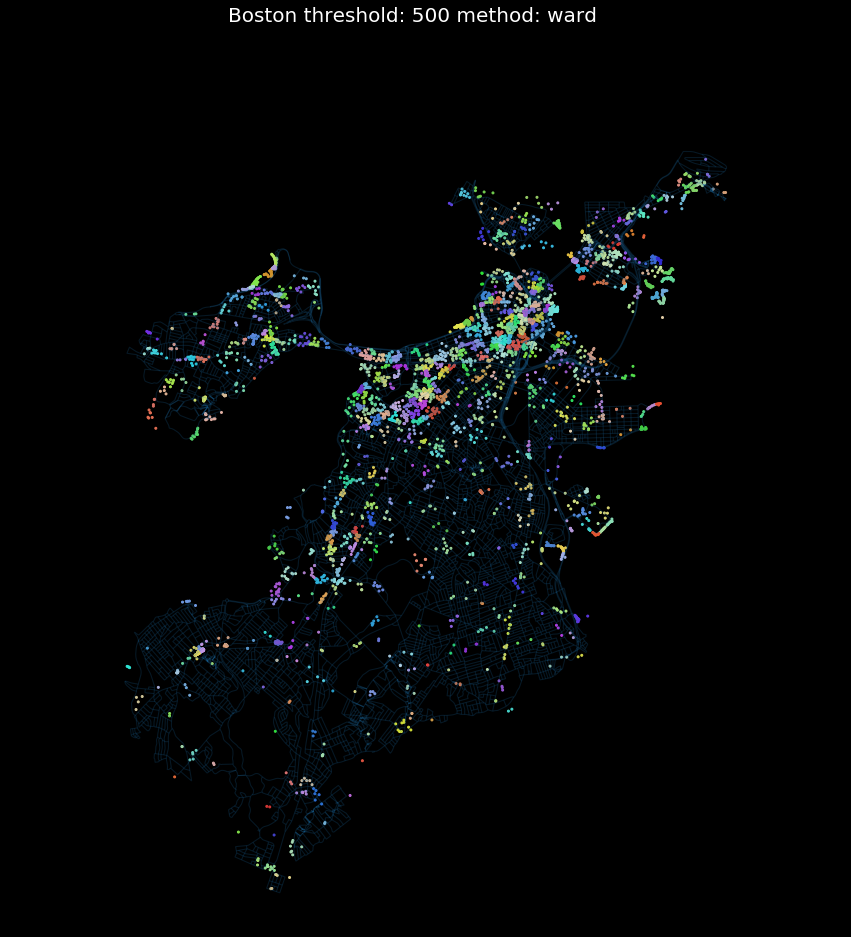

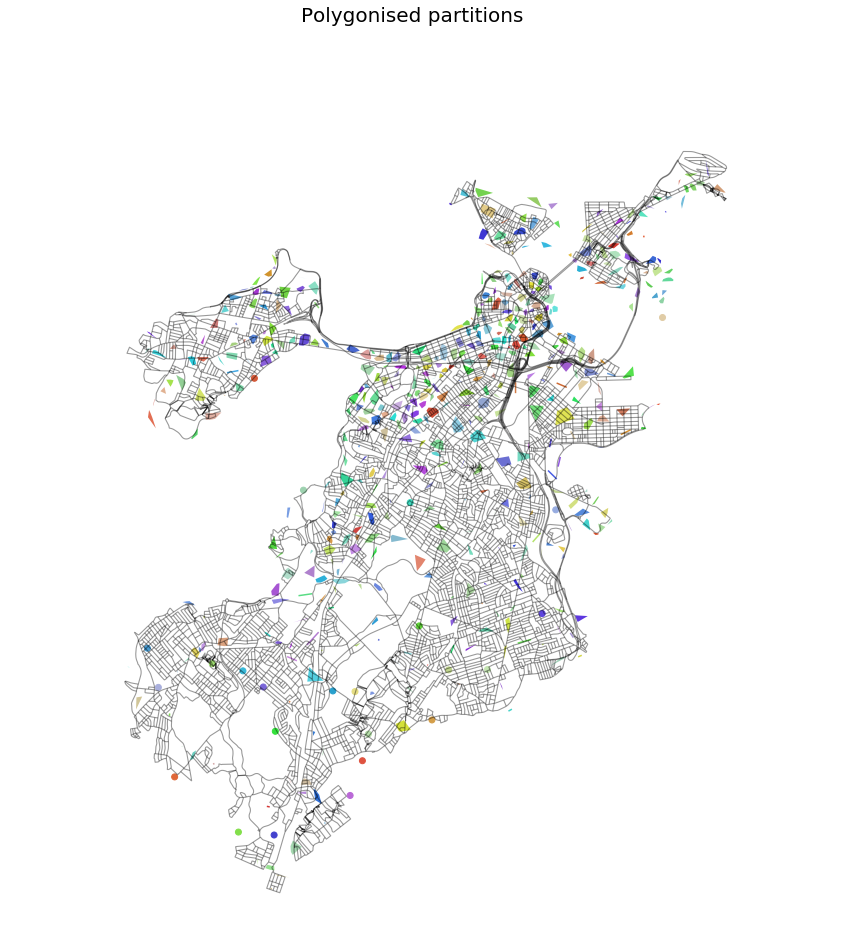

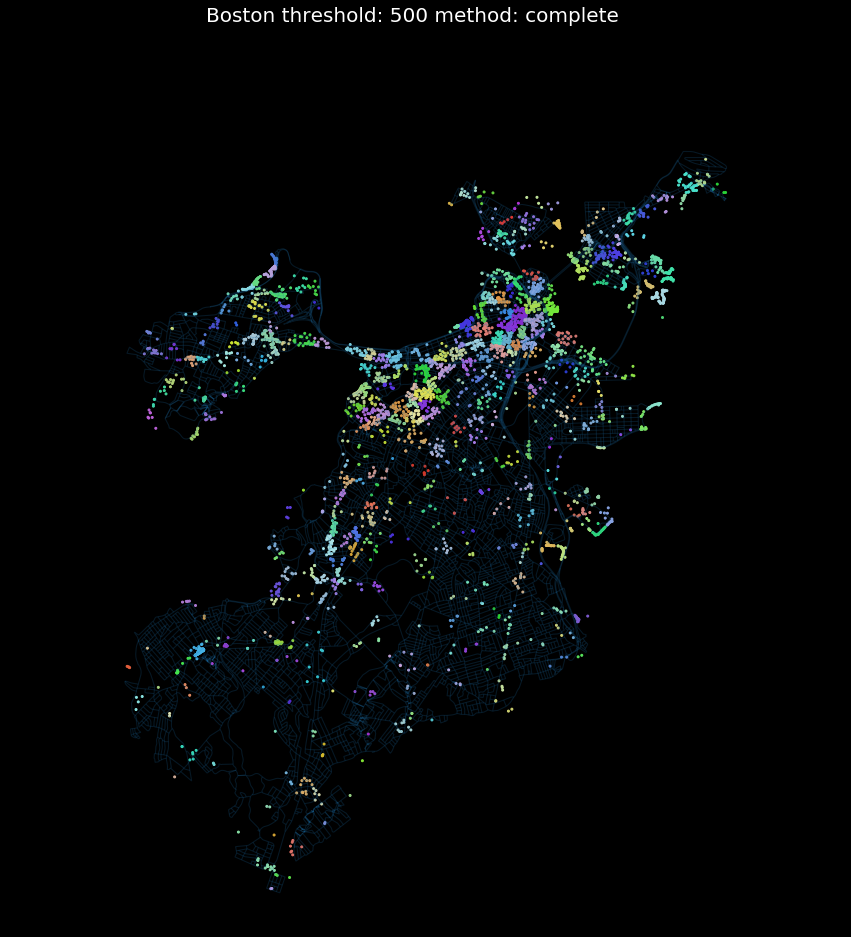

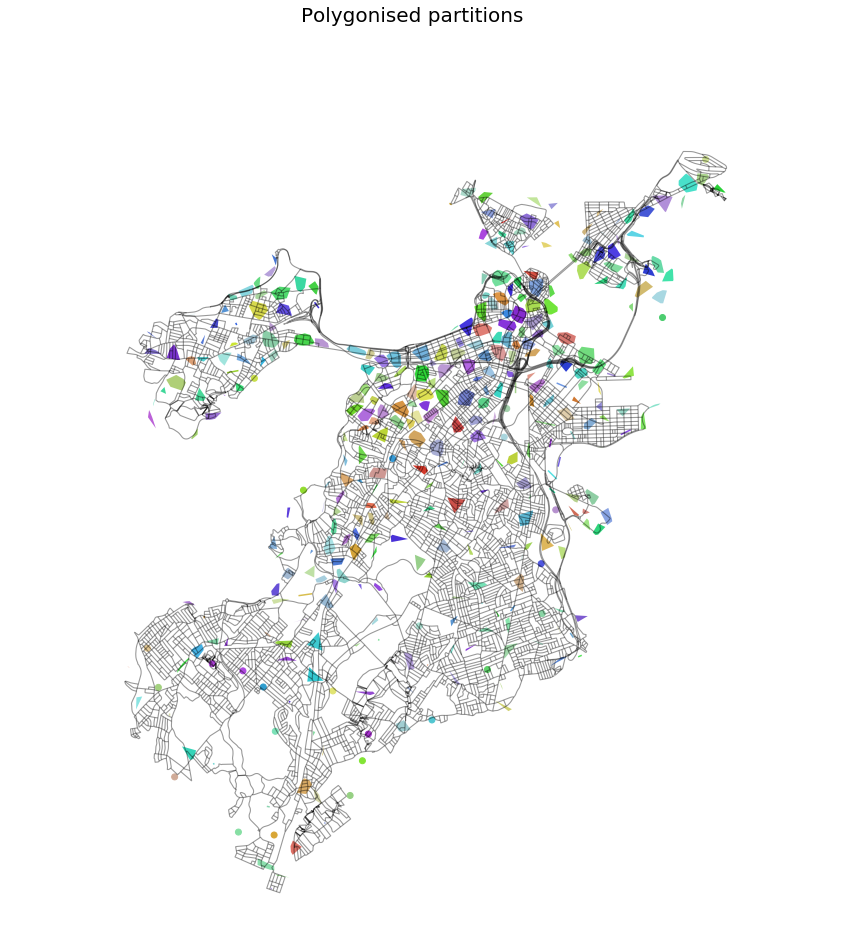

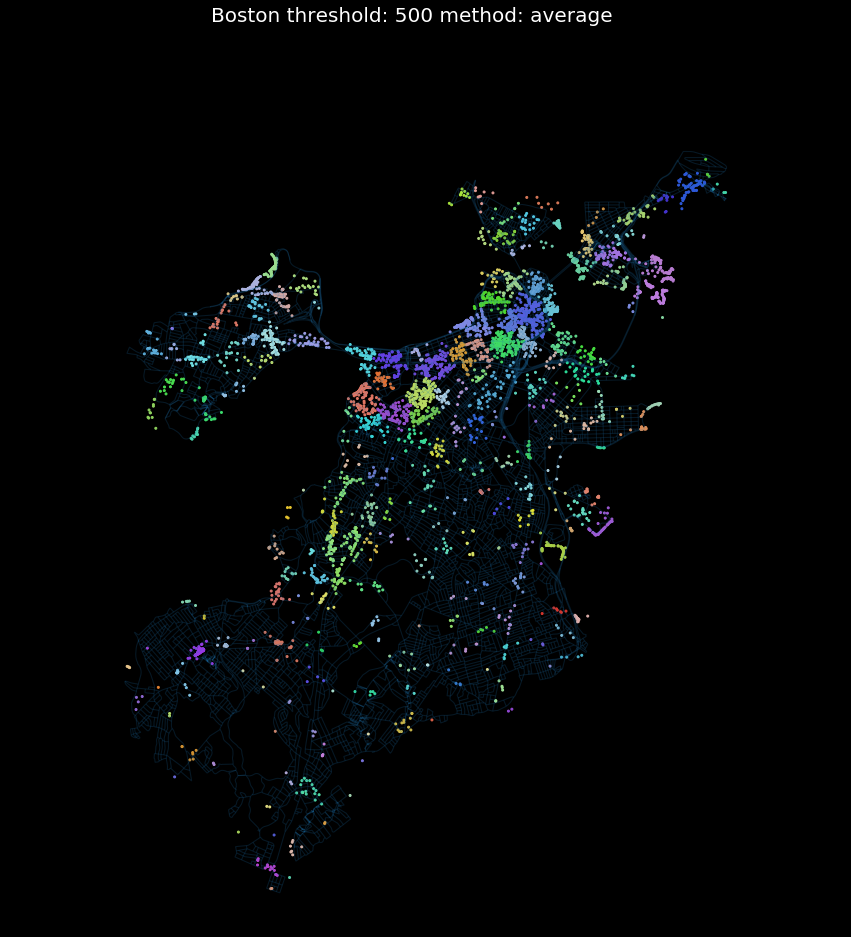

...

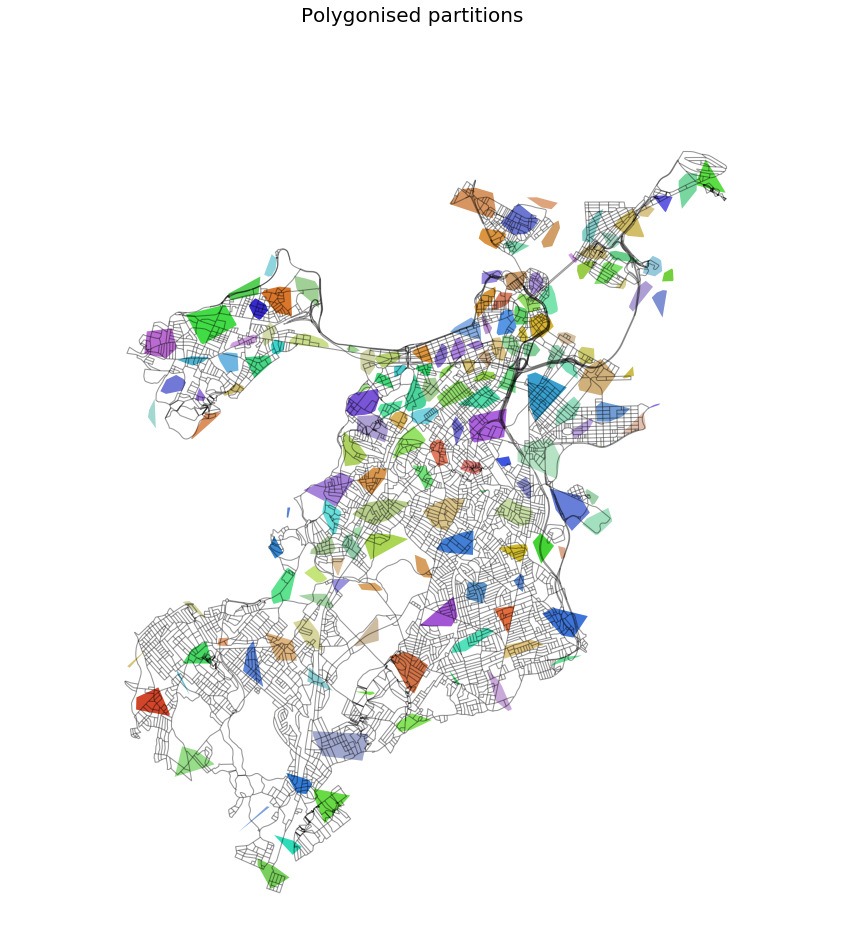

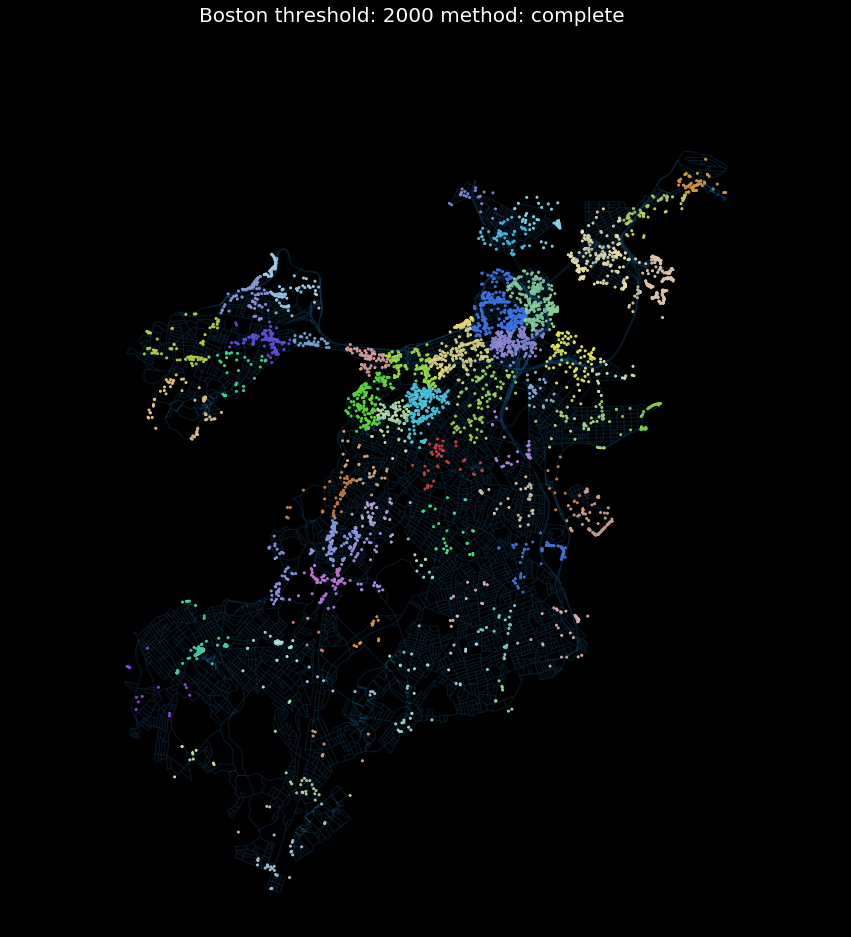

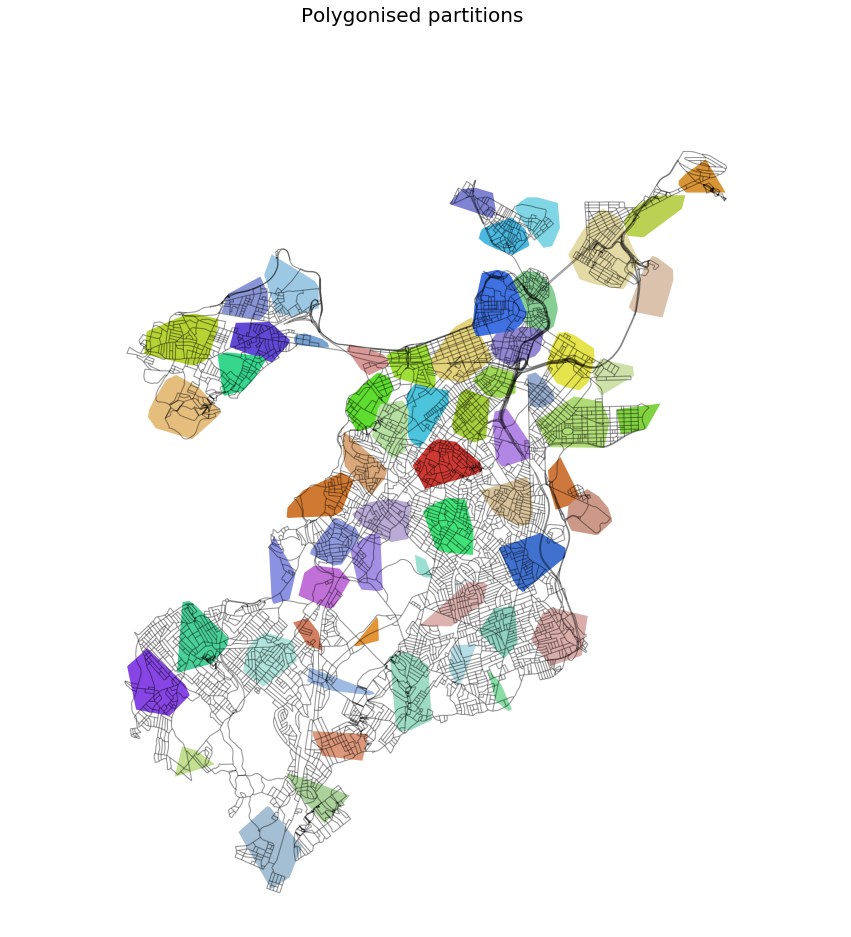

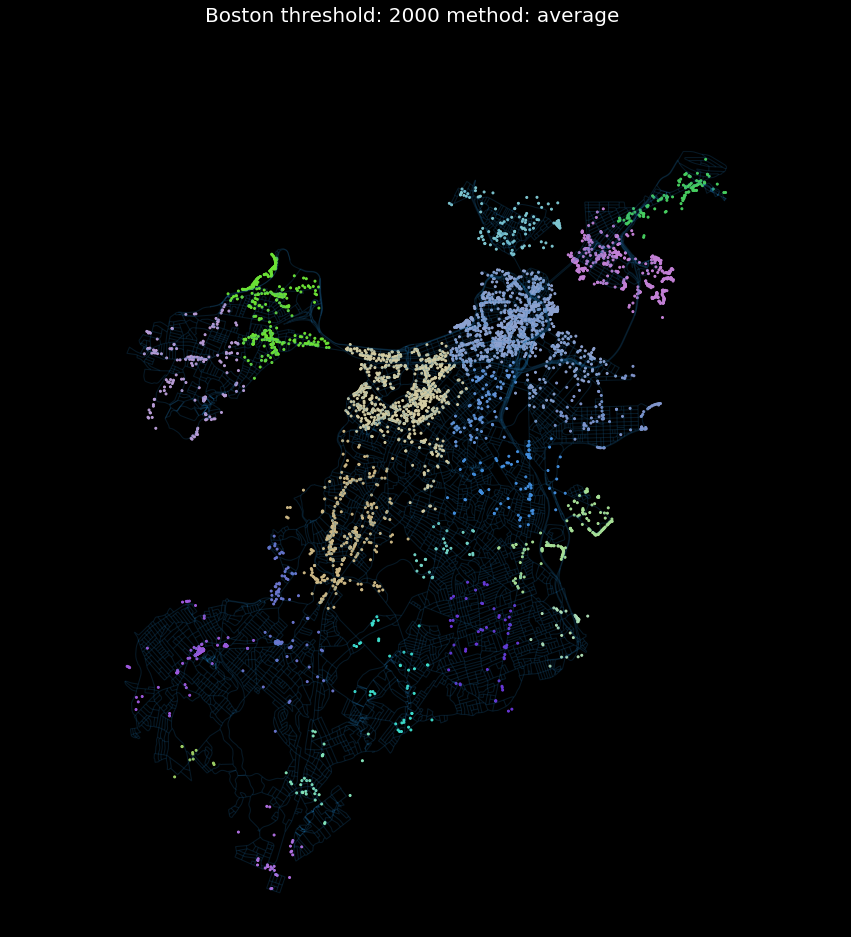

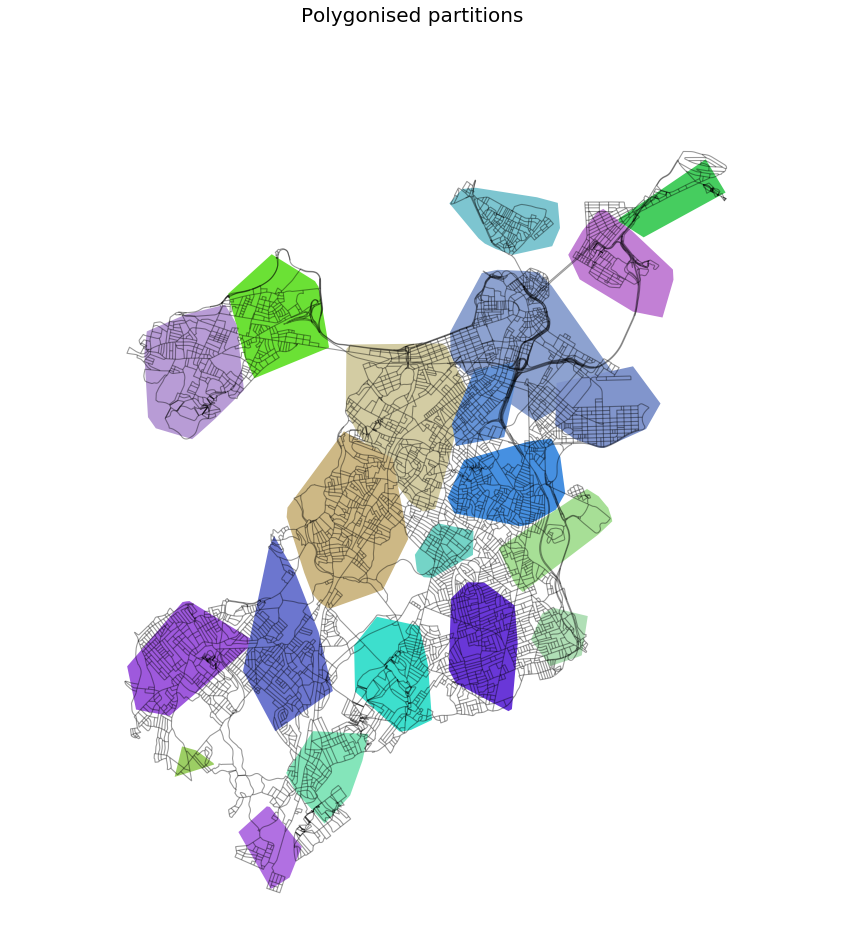

In [66]:
from sklearn.cluster import AgglomerativeClustering
distance = [500,1000,1500,2000]
method = ['ward', 'complete', 'average']
for d in distance:
    for m in method:
        clusterer = AgglomerativeClustering(n_clusters = None, affinity='euclidean', linkage= m, 
                                                    distance_threshold = d).fit(services[['x','y']])
        agglomorative_labels = clusterer.labels_
        services['cluster']= agglomorative_labels
        cmap = up.rand_cmap(nlabels = len(services['cluster'].unique()), type_color='bright', first_color_black=False, 
                         last_color_black=False)
        up.plot_points(services[services.cluster != -1], gdf_base_map = edges_graph,  
                       title = city_name+' threshold: '+str(d)+' method: '+m,
                       ms = 4, column = 'cluster', cmap = cmap, base_map_alpha = 0.2,)
        
        partitions = polygonise_clusters(services[services.cluster != -1], 'cluster', crs)
        up.plot_polygons(partitions, column = 'partitionID', cmap = cmap, title =  "Polygonised partitions", 
                     black_background = False,  fig_size = 15, gdf_base_map = edges_graph)

## District identification with network broken by negative barriers

## Assign edges and nodes to a partition

In [81]:
nodes_graph['district'] = 0
sindex = edges_graph.sindex # spatial index

edges_graph['district'] = edges_graph['p_length'] 
nodes_graph['district'] = nodes_graph.apply(lambda row: up.assign_district_to_nodes(row['geometry'], sindex, edges_graph), 
                                            axis = 1)
nodes_graph['district'] = nodes_graph.district.astype(int)

In [82]:
# geographical readjustment

ix_u = edges_graph.columns.get_loc("u")+1  
ix_v = edges_graph.columns.get_loc("v")+1  

for row in edges_graph.itertuples():
    district_u = nodes_graph.loc[row[ix_u]].district
    district_v = nodes_graph.loc[row[ix_v]].district
    if district_u == district_v: edges_graph.at[row.Index, 'district'] = district_u

In [86]:
nodes_graph['gateway'] = 0
ix_district = nodes_graph.columns.get_loc("district")+1  
for row in nodes_graph.itertuples():
    node_district = row[ix_district]
    tmp = edges_graph[(edges_graph.u == row.Index) | (edges_graph.v == row.Index)].copy()
    if len(tmp.district.unique()) == 1: continue # all same partition
    else: nodes_graph.at[row.Index, 'gateway'] = 1    

In [87]:
## saving edges with barriers column
to_convert = ['p_barr', 'n_barr']
edges_graph_string = edges_graph.copy()
for column in to_convert: edges_graph_string[column] = edges_graph_string[column].astype(str)
edges_graph_string.to_file(saving_path+city_name+"_edges.shp", driver='ESRI Shapefile')
nodes_graph.to_file(saving_path+city_name+'_nodes.shp', driver='ESRI Shapefile')